In [2]:
import tensorflow as tf
import matplotlib.pyplot as plt
import isotopolouge_imputer as imputer
import visualization as vis
import importlib
importlib.reload(imputer)
importlib.reload(vis)

%reload_ext autoreload
%autoreload 2
# /Users/bisramr/tensorflow-metal/bin/python3

In [3]:
import numpy as np
import pandas as pd

# Kidney Separation

In [36]:
dataA =  pd.read_csv("/Users/bisramr/MATLAB/Projects/Isoscope_Matlab_V/generated-data/full-metabolite-list/FML-kidney-M1-A.csv")
dataB = pd.read_csv("/Users/bisramr/MATLAB/Projects/Isoscope_Matlab_V/generated-data/full-metabolite-list/FML-kidney-M1-B.csv")
dataC = pd.read_csv("/Users/bisramr/MATLAB/Projects/Isoscope_Matlab_V/generated-data/full-metabolite-list/FML-kidney-M1-C.csv")

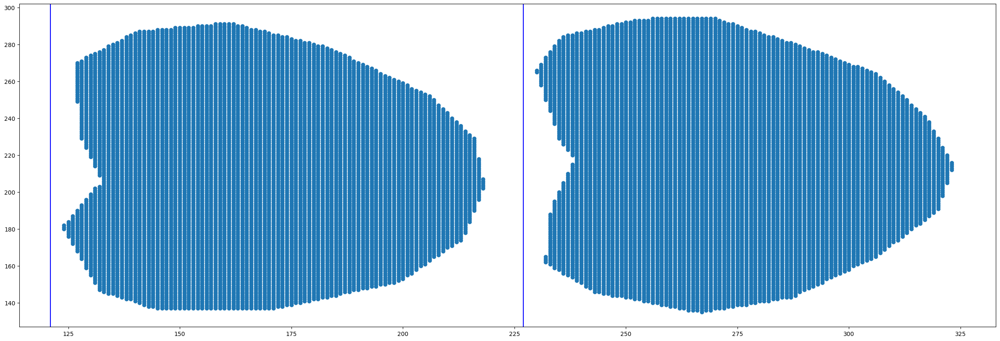

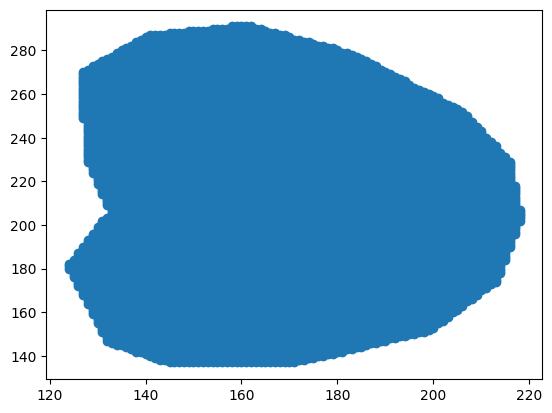

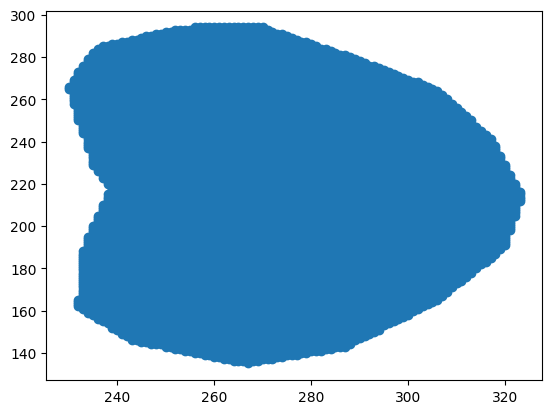

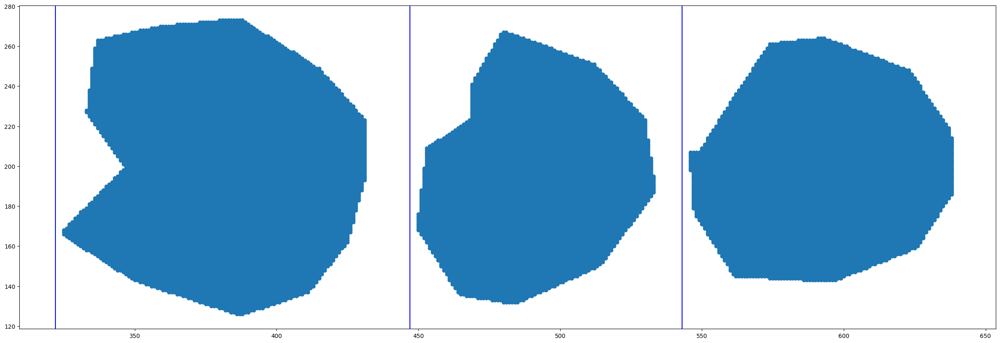

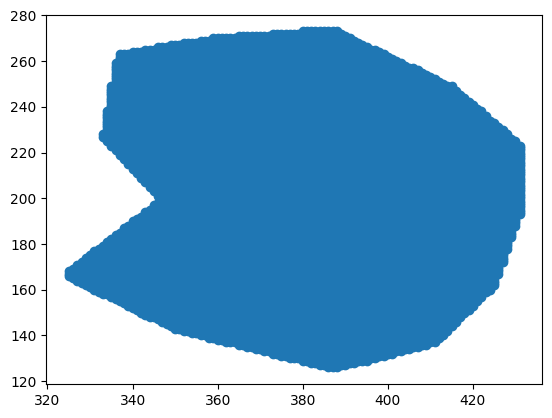

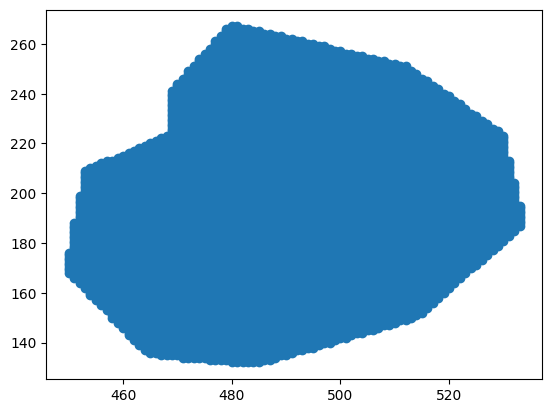

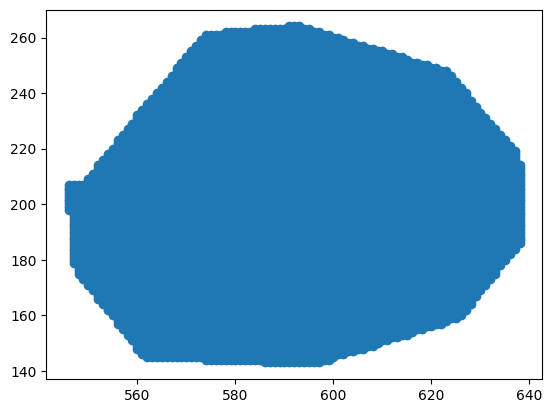

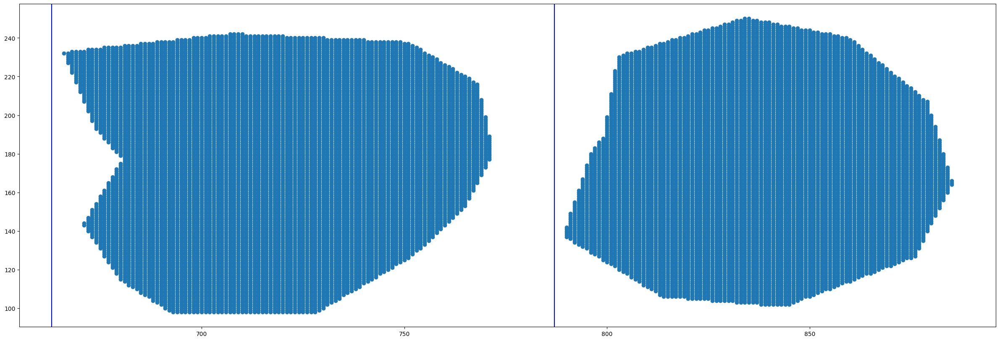

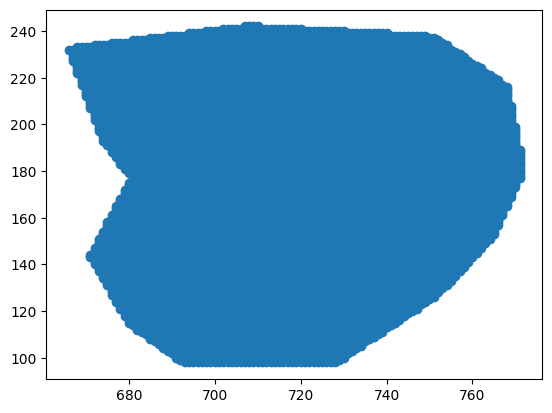

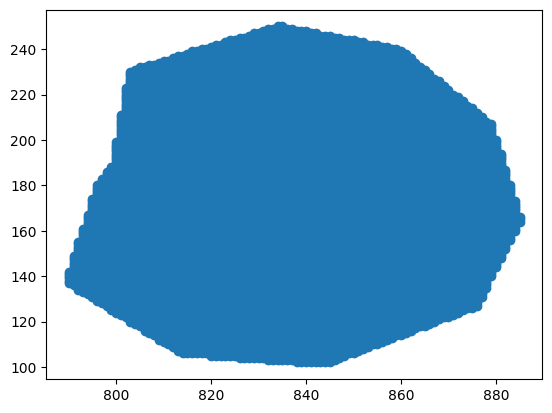

In [37]:
def separate_kidneys(data, tracers, replicate = "M1"):
    x_list = list(data['x'])
    x_max = max(x_list) + 50
    x_unused = [i for i in range(x_max + 1) if i not in x_list]
    x_bounds = [x_unused[i] - 2 for i in range(len(x_unused) - 1) if x_unused[i+1] - x_unused[i] != 1]
    # print(x_unused)

    plt.figure(figsize=(30,10))
    plt.scatter(x=data['x'], y=data['y'])
    for line in x_bounds:
        # only one line may be specified; full height
        plt.axvline(x = line, color = 'b', label = 'axvline - full height')

    plt.show()
    # border line for x coordinate
    #  subset data
    #data = data.loc[(data['x'] > 390) & (data['x'] < 520)]
    #data = data.loc[:, list(data.sum(axis=0)!=0)]

    # Let's loop through the cut off points and create new csvs for each individual
    for i, x_bound in enumerate(x_bounds):
        if i < len(x_bounds) - 1:
            plotting_data = data.loc[(data['x'] > x_bound) & (data['x'] < x_bounds[i+1])]
            plt.scatter(x=plotting_data['x'], y=plotting_data['y'])
            plt.show()
            plotting_data.to_csv(f"/Users/bisramr/MATLAB/Projects/Isoscope_Matlab_V/generated-data/full-metabolite-list/separated/FML-kidney-{tracers[i]}-{replicate}.csv")
        
        else:
            plotting_data = data.loc[(data['x'] > x_bound)]
            plt.scatter(x=plotting_data['x'], y=plotting_data['y'])
            plt.show()
            plotting_data.to_csv(f"/Users/bisramr/MATLAB/Projects/Isoscope_Matlab_V/generated-data/full-metabolite-list/separated/FML-kidney-{tracers[i]}-{replicate}.csv")


separate_kidneys(dataA, ["glucose", "lactate"], replicate="M1")
separate_kidneys(dataB, ["glutamine", "glycerol", "citrate"], replicate="M1")
separate_kidneys(dataC, ["3HB", "acetate"], replicate="M1")

In [83]:
tracer = "glutamine"
replicate2 = "M1"
replicate3 = "M3"
data2 = pd.read_csv(f"/Users/bisramr/MATLAB/Projects/Isoscope_Matlab_V/generated-data/kidney-m0-no-log/{tracer}-{replicate2}-ioncounts-ranks.csv")
data3 = pd.read_csv(f"/Users/bisramr/MATLAB/Projects/Isoscope_Matlab_V/generated-data/kidney-m0-no-log/{tracer}-{replicate3}-ioncounts-ranks.csv")

# data = pd.read_csv(f"/Users/bisramr/MATLAB/Projects/Isoscope_Matlab_V/generated-data/brain-m0-no-log/Brain-3HB/B3HB-KD-M1-FML-isotopolouges-ranks.csv")


In [81]:
for data in [data2, data3]:
    names = list(data.keys())
    print(names[-2], names[-1])


x y
x y


In [84]:
data2 = pd.read_csv(f"/Users/bisramr/MATLAB/Projects/Isoscope_Matlab_V/generated-data/full-metabolite-list/separated/FML-kidney-{tracer}-{replicate2}.csv")
data3 = pd.read_csv(f"/Users/bisramr/MATLAB/Projects/Isoscope_Matlab_V/generated-data/full-metabolite-list/separated/FML-kidney-{tracer}-{replicate3}.csv")
for data in [data2, data3]:
    names = list(data.keys())
    print(names[0:5])



['Unnamed: 0', 'x', 'y', 'Glyoxylic acid m+00', 'Glyoxylic acid m+01']
['x', 'y', 'Glyoxylic acid m+00', 'Glyoxylic acid m+01', 'Glyoxylic acid m+02']


In [90]:
ion_paths, iso_paths = imputer.generate_filepath_list(data_path = '/kidney-m0-no-log', FML = True, tracer = 'lactate')

ions_coord = imputer.get_data(file_name=ion_paths[0], keep_coord=True)
isotopolouges_coord = imputer.get_data(file_name=iso_paths[0], keep_coord=True)

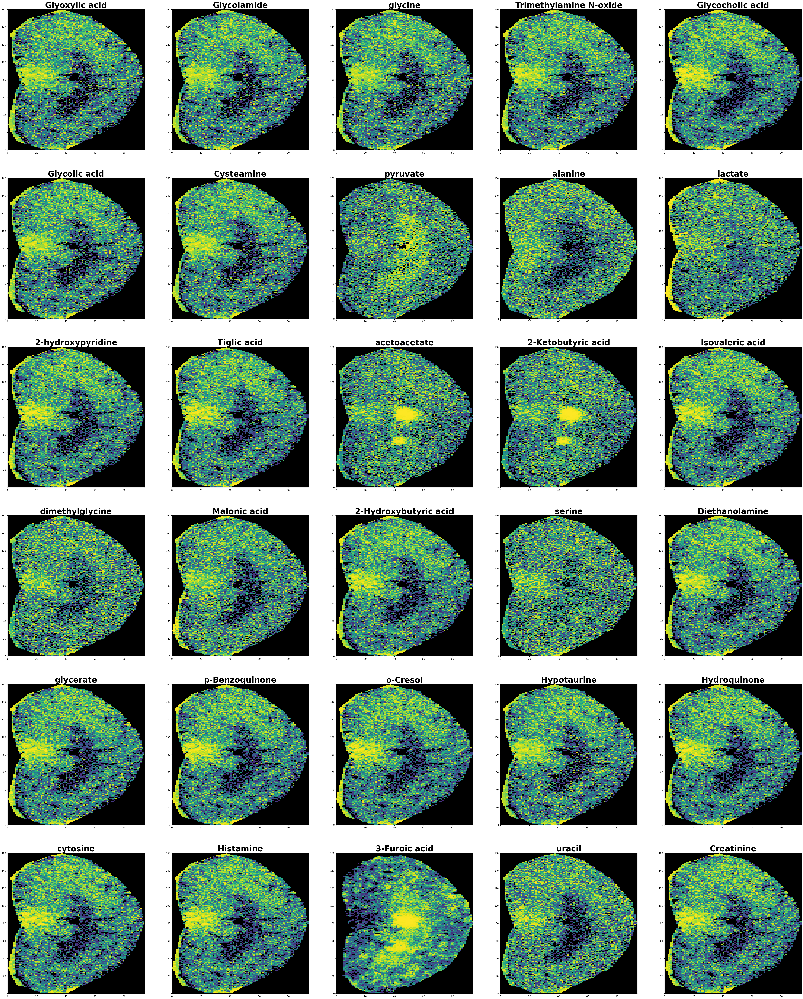

In [91]:
vis.plot_multiple_brains(ions_coord, indices_to_plot = [i for i in range(30)])

# Glutamine

In [119]:
# Glutamine Values
# For other tracers, need to remove the x and y at the end
M1_metab_names = ['Glyoxylic acid', 'Glycolamide', 'glycine', 'Trimethylamine N-oxide', 'Glycocholic acid', 'Glycolic acid', 'Cysteamine', 'pyruvate', 'alanine', 'lactate', '2-hydroxypyridine', 'Tiglic acid', 'acetoacetate', '2-Ketobutyric acid', 'Isovaleric acid', 'dimethylglycine', 'Malonic acid', '2-Hydroxybutyric acid', 'serine', 'Diethanolamine', 'glycerate', 'p-Benzoquinone', 'o-Cresol', 'Hypotaurine', 'Hydroquinone', 'cytosine', 'Histamine', '3-Furoic acid', 'uracil', 'Creatinine', 'Dihydrouracil', 'proline', 'fumarate', '2-Oxoisopentanoic acid', '4-Methylvaleric acid', 'N-Acetylglycine', 'Guanidoacetic acid', 'indole', 'betaine', 'succinate', '2-Hydroxyvaleric acid', 'Aminomalonic acid', 'homoserine', 'purine', 'cysteine', 'Benzoic acid', 'nicotinamide', 'nicotinate', 'Guaiacol', 'taurine', '5-Methylcytosine', 'thymine', '5-6-Dihydro Thymine', 'Pyroglutamic acid', 'DL-Pipecolic acid', 'Glutaconic acid', 'Methyloxovaleric acid (Ketoleucine)', 'N-Acetylputrescine', 'hydroxyproline', 'creatine', '3-Methylindole', 'leucine', 'Glutaric acid', 'asparagine', '2-Hydroxycaproic acid', 'ornithine', 'aspartate', 'malate', '2-Deoxy-D-ribose', 'homocysteine', 'adenine', 'L-Threonic acid', 'hypoxanthine', "N'-Methylnicotinamide", 'anthranilate', 'Phenylethanolamine', '3-Hydroxybenzoic acid', 'Urocanic acid', '6-Hydroxynicotinic acid', 'acetylphosphate', '1-3-Dimethyluracil', 'O-Phosphorylethanolamine', '5-Hydroxymethyluracil', '3-Methylglutaconic Acid', 'trans-4-Hydroxycyclohexanecarboxylic Acid', 'N-(5-Aminopentyl)acetamide', 'N-Butyrylglycine', '4-Guanidinobutanoic acid', 'Acetylcholine', 'a-ketoglutarate', 'Adipic acid', 'glutamine', 'lysine', 'glutamate', '2-hydroxyglutarate', 'methionine', 'Triethanolamine', 'Tartaric acid', 'Phenylglyoxylic acid', 'Ribose', '2-Phenylpropionic acid', 'guanine', 'N-Methyltyramine', 'xanthine', 'Mandelic acid', 'Adonitol', '3-Hydroxyanthranilic acid', 'Dopamine', 'Gentisic acid', 'histidine', '2-5-Furandicarboxylic acid', 'orotate', 'N-Tiglylglycine', 'L-Hydroorotic acid', 'allantoin', '4-6-Dioxoheptanoic acid', 'Indole-3-acetaldehyde', '2-Methylbutyrylglycine', 'Pargyline', 'DL-2-Aminooctanoic acid', 'oxoadipate', 'Pimelic acid', 'Tryptamine', '2-Hydroxyoctanoic acid', 'Indole-2-carboxylic acid', 'Aminoadipic acid', 'Indole-3-ethanol', 'carnitine', '2-Hydroxyhexanedioic Acid', 'DL-5-Hydroxylysine', '6-Dimethylaminopurine', 'phenylpyruvate', 'L-Fucose', '2-Phenylbutyric acid', 'Methionine sulfoxide', 'phenylalanine', 'L-(?)-3-Phenyllactic acid', 'D-Phenyllactic acid', 'quinolinate', 'Pyridoxal', 'Synephrine', '3-Methoxytyramine', 'PEP', 'Uric acid', 'Homogentisic acid', 'Pyridoxamine', 'L-Cysteic acid', '2-Amino-3-phosphonopropionic acid', '2-Furoylglycine', 'pyridoxine', '1-Methyl-Histidine', 'D-glyceraldehdye-3-phosphate', 'Diethylthiophosphate', 'sn-glycerol-3-phosphate', 'Menadione', 'Glycyl-L-proline', 'Quinaldic acid', 'Hexanoyl Glycine', 'aconitate', 'Shikimic acid', 'Suberic acid', 'arginine', 'N-Acetylaspartic acid', 'Indole-3-acetic acid', 'citrulline', 'Tricarballylic acid', 'N-carbamoyl-L-aspartate', '2-Isopropylmalic acid', 'Serotonin', 'N-Formyl-L-methionine', 'L-Gulonic acid-lactone', 'Gluconolactone', '5-Phenylvaleric acid', 'Isoxanthopterin', 'hydroxyphenylpyruvate', 'Nicotinuric acid', 'Glucose', '3-(3-Methoxyphenyl)propionic acid', 'tyrosine', 'Hydroxyphenyllactic acid', '4-Pyridoxic acid', 'Phosphorylcholine', 'DL -3-4-Dihydroxymandelic acid', 'Phosphoserine', 'Undecanoic acid', 'trans-3-Indoleacrylic acid', 'Glycyl-L-leucine', 'Homoarginine', 'N6-N6-N6-Trimethyllysine', 'Kynurenic acid', 'N-acetyl-glutamate', '3-Indolepropionic acid', 'Homocitrulline', 'Diaminopimelic Acid', '5-Methoxytryptamine', 'Hydroxyindoleacetic acid', 'N-Acetyl-L-methionine', 'citrate/isocitrate', 'Quinic acid', 'Phenylacetylglycine', '5-Keto-D-gluconic acid', '4-Aminohippuric acid', '2-Hydroxy Hippuric Acid', 'D-gluconate', '3-4-Dimethoxyphenylacetic acid', 'L-Dopa', 'DL-4-Hydroxy-3-methoxymandelic acid', 'O-phosphohomoserine', 'D-erythrose-4-phosphate', 'Cysteine S-sulfate', 'Capryloyl glycine', 'Sebacic acid', 'Indole-3-pyruvic acid', '3-Indolebutyric acid', 'N-Acetylcarnitine', 'tryptophan', 'Xanthurenic acid', 'DL-Indole-3-lactic acid', '(±)-Lipoic acid', 'N-Acetyl-L-phenylalanine', 'DL-Benzylsuccinic acid', 'L-Kynurenine', 'Mucic acid', 'Creatine phosphate', '3-Indoxyl sulfate', 'deoxyribose-phosphate', 'N-Acetylserotonin', 'pantothenate', '5-L-Hydroxytryptophan', '?-N-Acetylglucosamine', 'cystathionine', 'N-Acetyltyrosine', '3-Nitro-L- tyrosine', 'Carnosine', 'deoxyuridine', 'Myristic acid', 'ribose-phosphate', 'Suberyl Glycine', 'Melatonin', '5-Methoxytryptophan', 'Sepiapterin', '3-4-5-Trimethoxycinnamic acid', 'Glycyl-L-tyrosine', 'Anserine', 'thymidine', 'cytidine', 'uridine', 'biotin', 'Pyridoxal 5-phosphate', 'pyridoxamine-5-phosphate', 'Muramic acid', 'deoxyadenosine', 'deoxyinosine', 'Ribothymidine', 'glucosamine-6-phosphate', 'glucose-1-phosphate', 'Mannitol-1-phosphate', 'adenosine', 'homocystine', 'inosine', 'L-Aspartyl-L-phenylalanine', 'Linoleic acid', '1-Methyladenosine', 'guanosine', 'xanthosine', 'Stearic acid', "5'-Methylthioadenosine", '7-methylguanosine', 'Retinoic Acid', 'elcosapentaenoic acid', 'dCMP', 'glutathione', 'dUMP', 'N-Acetylneuraminic acid', 'Arachidic acid', 'CMP', 'UMP', 'Docosahexaenoic acid(DHA)', 'cyclic-AMP', 'dAMP', 'fructose-1-6-bisphosphate', 'Sucrose', 'AMP', 'dGMP', 'IMP', 'GMP', 'riboflavin', 'Lithocholic acid', 'S-adenosyl-L-homoCysteine', 'dCDP', 'Chenodeoxycholic acid', 'S-Adenosylmethionine', 'dTDP', 'CDP', 'UDP', 'Cholic acid', 'trehalose-6-Phosphate', 'Cysteine-glutathione disulphide', "adenosine 5'-phosphosulfate", 'ADP', 'IDP', 'folate', 'GDP', 'Glycodeoxycholic acid', 'Glycoursodeoxycholic acid', 'FMN', '5-methyl-THF', 'dCTP', 'dUTP', 'Folinic acid', 'dTTP', 'CTP', 'UTP', 'CDP-choline', 'dATP', 'Taurodeoxycholic acid', 'ATP', 'Inosine 5-triphosphate', 'GTP', 'Cyclic-ADP-ribose', 'D-Pantethine', 'UDP-D-glucose', 'Bilirubin', 'ADP-D-glucose', 'glutathione disulfide', 'NAD+', 'NADH', 'dephospho-CoA', 'NADP+', 'NADPH', 'coenzyme A', 'hyaluronate', 'FAD', 'acetyl-CoA', 'propionyl-CoA', 'butyryl-CoA', 'acetoacetyl-CoA', 'malonyl-CoA', 'Butyric acid', 'N-Acetyl-cysteine', 'N-Acetyl-L-arginine', 'N-Acetyl-L-asparagine', 'N-acetyl-L-glutamine', 'N-Acetyl-L-leucine', 'N-Acetyl-L-isoleucine', 'N-acetyl-L-ornithine', 'N-Acetyl-L-phenylalanine m', 'N-Acetyl-L-proline', 'O-acetyl-L-serine', 'Ala-Ala', 'Glycerophosphocholine', '2-Furoylglycine m', 'N-Iso valerylglycine', 'x', 'y']
M1_moransi_scores = [0.7038, 0.698, 0.6795, 0.7101, 0.7613, 0.7018, 0.7032, 0.5552, 0.4919, 0.5754, 0.736, 0.7335, 0.6154, 0.6155, 0.7328, 0.5754, 0.6709, 0.7249, 0.6155, 0.7304, 0.7371, 0.742, 0.7464, 0.6991, 0.741, 0.7373, 0.7381, 0.5816, 0.6372, 0.7384, 0.6742, 0.7306, 0.7635, 0.7192, 0.7453, 0.6607, 0.7293, 0.7512, 0.7405, 0.7398, 0.7469, 0.7355, 0.6495, 0.7257, 0.933, 0.7481, 0.7467, 0.7441, 0.7488, 0.7085, 0.7484, 0.7069, 0.6242, 0.8634, 0.7448, 0.5246, 0.7458, 0.7469, 0.6429, 0.733, 0.7549, 0.7516, 0.6721, 0.73, 0.7505, 0.7267, 0.8711, 0.8926, 0.7436, 0.858, 0.75, 0.739, 0.8615, 0.7562, 0.742, 0.7538, 0.7515, 0.7268, 0.6963, 0.4981, 0.828, 0.858, 0.7319, 0.6136, 0.7516, 0.7519, 0.7182, 0.7498, 0.752, 0.7066, 0.7422, 0.8366, 0.7479, 0.7825, 0.6652, 0.75, 0.7511, 0.7431, 0.7496, 0.8445, 0.759, 0.638, 0.7573, 0.8665, 0.7332, 0.748, 0.7398, 0.7559, 0.7178, 0.8539, 0.746, 0.7264, 0.7151, 0.7398, 0.9081, 0.7417, 0.7603, 0.7283, 0.7547, 0.7567, 0.9364, 0.7499, 0.7599, 0.7559, 0.7419, 0.6806, 0.7609, 0.7557, 0.6824, 0.7494, 0.7554, 0.758, 0.7502, 0.7619, 0.7241, 0.7804, 0.7335, 0.7512, 0.7398, 0.7168, 0.7628, 0.7632, 0.6949, 0.7721, 0.7212, 0.7579, 0.5065, 0.7312, 0.7038, 0.5759, 0.7574, 0.564, 0.7537, 0.889, 0.7596, 0.8391, 0.7558, 0.7838, 0.7629, 0.7033, 0.7536, 0.7459, 0.763, 0.7612, 0.7157, 0.8196, 0.7397, 0.7477, 0.7593, 0.7228, 0.822, 0.8225, 0.7595, 0.8146, 0.7444, 0.761, 0.711, 0.7444, 0.7424, 0.7271, 0.8978, 0.742, 0.5928, 0.6193, 0.7616, 0.7535, 0.7709, 0.7579, 0.7571, 0.7471, 0.7643, 0.761, 0.757, 0.7699, 0.7585, 0.7551, 0.7159, 0.7889, 0.7218, 0.7376, 0.888, 0.7225, 0.6334, 0.8985, 0.7502, 0.6347, 0.637, 0.7387, 0.7127, 0.7481, 0.7603, 0.7596, 0.7514, 0.758, 0.7595, 0.7613, 0.7951, 0.7299, 0.7702, 0.7836, 0.7592, 0.743, 0.6899, 0.7556, 0.7401, 0.9477, 0.7599, 0.7589, 0.7093, 0.7623, 0.7447, 0.7611, 0.7188, 0.7945, 0.7492, 0.7662, 0.6219, 0.7638, 0.7646, 0.7587, 0.7532, 0.7625, 0.8332, 0.8015, 0.7477, 0.7534, 0.7199, 0.7541, 0.7549, 0.8975, 0.7641, 0.7643, 0.7559, 0.6974, 0.7106, 0.686, 0.7641, 0.7425, 0.7421, 0.8782, 0.6472, 0.816, 0.7912, 0.7549, 0.7479, 0.7666, 0.7444, 0.7657, 0.7708, 0.7783, 0.7604, 0.8891, 0.7572, 0.7121, 0.7707, 0.7689, 0.5578, 0.8478, 0.7521, 0.7381, 0.7407, 0.7417, 0.7034, 0.7034, 0.7478, 0.7649, 0.7598, 0.771, 0.7371, 0.7683, 0.7696, 0.7321, 0.7656, 0.7651, 0.7766, 0.7708, 0.7677, 0.7707, 0.768, 0.7952, 0.7682, 0.768, 0.7679, 0.7713, 0.7713, 0.7623, 0.7092, 0.7674, 0.768, 0.7632, 0.7695, 0.7688, 0.7685, 0.7696, 0.769, 0.7747, 0.7693, 0.7695, 0.7697, 0.77, 0.7714, 0.7701, 0.7715, 0.7699, 0.7709, 0.7716, 0.7715, 0.7705, 0.7708, 0.771, 0.772, 0.7717, 0.7717, 0.7721, 0.7722, 0.7719, 0.7727, 0.7726, 0.7072, 0.6614, 0.7642, 0.7139, 0.7606, 0.7838, 0.7838, 0.7548, 0.7836, 0.7155, 0.7825, 0.7826, 0.7599, 0.7051, 0.7282]
M2_metab_names = ['Glyoxylic acid', 'Glycolamide', 'glycine', 'Trimethylamine N-oxide', 'Glycocholic acid', 'Glycolic acid', 'Cysteamine', 'pyruvate', 'alanine', 'lactate', '2-hydroxypyridine', 'Tiglic acid', 'acetoacetate', '2-Ketobutyric acid', 'Isovaleric acid', 'dimethylglycine', 'Malonic acid', '2-Hydroxybutyric acid', 'serine', 'Diethanolamine', 'glycerate', 'p-Benzoquinone', 'o-Cresol', 'Hypotaurine', 'Hydroquinone', 'cytosine', 'Histamine', '3-Furoic acid', 'uracil', 'Creatinine', 'Dihydrouracil', 'proline', 'fumarate', '2-Oxoisopentanoic acid', '4-Methylvaleric acid', 'N-Acetylglycine', 'Guanidoacetic acid', 'indole', 'betaine', 'succinate', '2-Hydroxyvaleric acid', 'Aminomalonic acid', 'homoserine', 'purine', 'cysteine', 'Benzoic acid', 'nicotinamide', 'nicotinate', 'Guaiacol', 'taurine', '5-Methylcytosine', 'thymine', '5-6-Dihydro Thymine', 'Pyroglutamic acid', 'DL-Pipecolic acid', 'Glutaconic acid', 'Methyloxovaleric acid (Ketoleucine)', 'N-Acetylputrescine', 'hydroxyproline', 'creatine', '3-Methylindole', 'leucine', 'Glutaric acid', 'asparagine', '2-Hydroxycaproic acid', 'ornithine', 'aspartate', 'malate', '2-Deoxy-D-ribose', 'homocysteine', 'adenine', 'L-Threonic acid', 'hypoxanthine', "N'-Methylnicotinamide", 'anthranilate', 'Phenylethanolamine', '3-Hydroxybenzoic acid', 'Urocanic acid', '6-Hydroxynicotinic acid', 'acetylphosphate', '1-3-Dimethyluracil', 'O-Phosphorylethanolamine', '5-Hydroxymethyluracil', '3-Methylglutaconic Acid', 'trans-4-Hydroxycyclohexanecarboxylic Acid', 'N-(5-Aminopentyl)acetamide', 'N-Butyrylglycine', '4-Guanidinobutanoic acid', 'Acetylcholine', 'a-ketoglutarate', 'Adipic acid', 'glutamine', 'lysine', 'glutamate', '2-hydroxyglutarate', 'methionine', 'Triethanolamine', 'Tartaric acid', 'Phenylglyoxylic acid', 'Ribose', '2-Phenylpropionic acid', 'guanine', 'N-Methyltyramine', 'xanthine', 'Mandelic acid', 'Adonitol', '3-Hydroxyanthranilic acid', 'Dopamine', 'Gentisic acid', 'histidine', '2-5-Furandicarboxylic acid', 'orotate', 'N-Tiglylglycine', 'L-Hydroorotic acid', 'allantoin', '4-6-Dioxoheptanoic acid', 'Indole-3-acetaldehyde', '2-Methylbutyrylglycine', 'Pargyline', 'DL-2-Aminooctanoic acid', 'oxoadipate', 'Pimelic acid', 'Tryptamine', '2-Hydroxyoctanoic acid', 'Indole-2-carboxylic acid', 'Aminoadipic acid', 'Indole-3-ethanol', 'carnitine', '2-Hydroxyhexanedioic Acid', 'DL-5-Hydroxylysine', '6-Dimethylaminopurine', 'phenylpyruvate', 'L-Fucose', '2-Phenylbutyric acid', 'Methionine sulfoxide', 'phenylalanine', 'L-(?)-3-Phenyllactic acid', 'D-Phenyllactic acid', 'quinolinate', 'Pyridoxal', 'Synephrine', '3-Methoxytyramine', 'PEP', 'Uric acid', 'Homogentisic acid', 'Pyridoxamine', 'L-Cysteic acid', '2-Amino-3-phosphonopropionic acid', '2-Furoylglycine', 'pyridoxine', '1-Methyl-Histidine', 'D-glyceraldehdye-3-phosphate', 'Diethylthiophosphate', 'sn-glycerol-3-phosphate', 'Menadione', 'Glycyl-L-proline', 'Quinaldic acid', 'Hexanoyl Glycine', 'aconitate', 'Shikimic acid', 'Suberic acid', 'arginine', 'N-Acetylaspartic acid', 'Indole-3-acetic acid', 'citrulline', 'Tricarballylic acid', 'N-carbamoyl-L-aspartate', '2-Isopropylmalic acid', 'Serotonin', 'N-Formyl-L-methionine', 'L-Gulonic acid-lactone', 'Gluconolactone', '5-Phenylvaleric acid', 'Isoxanthopterin', 'hydroxyphenylpyruvate', 'Nicotinuric acid', 'Glucose', '3-(3-Methoxyphenyl)propionic acid', 'tyrosine', 'Hydroxyphenyllactic acid', '4-Pyridoxic acid', 'Phosphorylcholine', 'DL -3-4-Dihydroxymandelic acid', 'Phosphoserine', 'Undecanoic acid', 'trans-3-Indoleacrylic acid', 'Glycyl-L-leucine', 'Homoarginine', 'N6-N6-N6-Trimethyllysine', 'Kynurenic acid', 'N-acetyl-glutamate', '3-Indolepropionic acid', 'Homocitrulline', 'Diaminopimelic Acid', '5-Methoxytryptamine', 'Hydroxyindoleacetic acid', 'N-Acetyl-L-methionine', 'citrate/isocitrate', 'Quinic acid', 'Phenylacetylglycine', '5-Keto-D-gluconic acid', '4-Aminohippuric acid', '2-Hydroxy Hippuric Acid', 'D-gluconate', '3-4-Dimethoxyphenylacetic acid', 'L-Dopa', 'DL-4-Hydroxy-3-methoxymandelic acid', 'O-phosphohomoserine', 'D-erythrose-4-phosphate', 'Cysteine S-sulfate', 'Capryloyl glycine', 'Sebacic acid', 'Indole-3-pyruvic acid', '3-Indolebutyric acid', 'N-Acetylcarnitine', 'tryptophan', 'Xanthurenic acid', 'DL-Indole-3-lactic acid', '(±)-Lipoic acid', 'N-Acetyl-L-phenylalanine', 'DL-Benzylsuccinic acid', 'L-Kynurenine', 'Mucic acid', 'Creatine phosphate', '3-Indoxyl sulfate', 'deoxyribose-phosphate', 'N-Acetylserotonin', 'pantothenate', '5-L-Hydroxytryptophan', '?-N-Acetylglucosamine', 'cystathionine', 'N-Acetyltyrosine', '3-Nitro-L- tyrosine', 'Carnosine', 'deoxyuridine', 'Myristic acid', 'ribose-phosphate', 'Suberyl Glycine', 'Melatonin', '5-Methoxytryptophan', 'Sepiapterin', '3-4-5-Trimethoxycinnamic acid', 'Glycyl-L-tyrosine', 'Anserine', 'thymidine', 'cytidine', 'uridine', 'biotin', 'Pyridoxal 5-phosphate', 'pyridoxamine-5-phosphate', 'Muramic acid', 'deoxyadenosine', 'deoxyinosine', 'Ribothymidine', 'glucosamine-6-phosphate', 'glucose-1-phosphate', 'Mannitol-1-phosphate', 'adenosine', 'homocystine', 'inosine', 'L-Aspartyl-L-phenylalanine', 'Linoleic acid', '1-Methyladenosine', 'guanosine', 'xanthosine', 'Stearic acid', "5'-Methylthioadenosine", '7-methylguanosine', 'Retinoic Acid', 'elcosapentaenoic acid', 'dCMP', 'glutathione', 'dUMP', 'N-Acetylneuraminic acid', 'Arachidic acid', 'CMP', 'UMP', 'Docosahexaenoic acid(DHA)', 'cyclic-AMP', 'dAMP', 'fructose-1-6-bisphosphate', 'Sucrose', 'AMP', 'dGMP', 'IMP', 'GMP', 'riboflavin', 'Lithocholic acid', 'S-adenosyl-L-homoCysteine', 'dCDP', 'Chenodeoxycholic acid', 'S-Adenosylmethionine', 'dTDP', 'CDP', 'UDP', 'Cholic acid', 'trehalose-6-Phosphate', 'Cysteine-glutathione disulphide', "adenosine 5'-phosphosulfate", 'ADP', 'IDP', 'folate', 'GDP', 'Glycodeoxycholic acid', 'Glycoursodeoxycholic acid', 'FMN', '5-methyl-THF', 'dCTP', 'dUTP', 'Folinic acid', 'dTTP', 'CTP', 'UTP', 'CDP-choline', 'dATP', 'Taurodeoxycholic acid', 'ATP', 'Inosine 5-triphosphate', 'GTP', 'Cyclic-ADP-ribose', 'D-Pantethine', 'UDP-D-glucose', 'Bilirubin', 'ADP-D-glucose', 'glutathione disulfide', 'NAD+', 'NADH', 'dephospho-CoA', 'NADP+', 'NADPH', 'coenzyme A', 'hyaluronate', 'FAD', 'acetyl-CoA', 'propionyl-CoA', 'butyryl-CoA', 'acetoacetyl-CoA', 'malonyl-CoA', 'Butyric acid', 'N-Acetyl-cysteine', 'N-Acetyl-L-arginine', 'N-Acetyl-L-asparagine', 'N-acetyl-L-glutamine', 'N-Acetyl-L-leucine', 'N-Acetyl-L-isoleucine', 'N-acetyl-L-ornithine', 'N-Acetyl-L-phenylalanine m', 'N-Acetyl-L-proline', 'O-acetyl-L-serine', 'Ala-Ala', 'Glycerophosphocholine', '2-Furoylglycine m', 'N-Iso valerylglycine', 'x', 'y']
M2_moransi_scores = [0.777, 0.7622, 0.7462, 0.7794, 0.8265, 0.7659, 0.777, 0.7965, 0.6842, 0.7512, 0.7989, 0.7905, 0.6617, 0.6618, 0.8051, 0.6836, 0.688, 0.7942, 0.6884, 0.8018, 0.7959, 0.8113, 0.8065, 0.7181, 0.8011, 0.8026, 0.8078, 0.6994, 0.7158, 0.7966, 0.7128, 0.7628, 0.7667, 0.753, 0.8074, 0.7369, 0.7726, 0.8154, 0.8085, 0.7245, 0.8126, 0.8026, 0.7127, 0.7443, 0.8653, 0.8095, 0.8163, 0.8036, 0.8169, 0.9077, 0.8044, 0.7136, 0.703, 0.8451, 0.801, 0.6976, 0.8081, 0.8146, 0.7024, 0.765, 0.8226, 0.8127, 0.701, 0.6971, 0.7721, 0.7846, 0.9073, 0.9219, 0.8102, 0.8732, 0.8237, 0.6968, 0.8735, 0.8161, 0.7848, 0.8233, 0.7837, 0.8434, 0.4689, 0.6596, 0.8947, 0.9298, 0.7758, 0.6444, 0.8083, 0.82, 0.7605, 0.8163, 0.82, 0.6532, 0.7583, 0.8467, 0.7746, 0.8109, 0.8122, 0.8048, 0.8215, 0.6445, 0.802, 0.8392, 0.8239, 0.791, 0.8185, 0.8982, 0.7626, 0.7842, 0.7707, 0.7978, 0.6685, 0.843, 0.7679, 0.8282, 0.7105, 0.6949, 0.8553, 0.7903, 0.816, 0.7914, 0.8174, 0.823, 0.9174, 0.7622, 0.8261, 0.8241, 0.7992, 0.7684, 0.8253, 0.8247, 0.6672, 0.7944, 0.8252, 0.7457, 0.7603, 0.8228, 0.7412, 0.8215, 0.4933, 0.5953, 0.7978, 0.6969, 0.8246, 0.8243, 0.7626, 0.7212, 0.7074, 0.8032, 0.7262, 0.7549, 0.7453, 0.7051, 0.7806, 0.7439, 0.7997, 0.9264, 0.821, 0.892, 0.7654, 0.8256, 0.7388, 0.599, 0.8095, 0.7661, 0.8687, 0.8217, 0.7398, 0.9503, 0.7246, 0.7677, 0.8215, 0.8186, 0.759, 0.7667, 0.8238, 0.8216, 0.7517, 0.6692, 0.7461, 0.7613, 0.6846, 0.6926, 0.6123, 0.8302, 0.5401, 0.7705, 0.8277, 0.7873, 0.8256, 0.8239, 0.8253, 0.7811, 0.7379, 0.801, 0.7882, 0.8487, 0.827, 0.7169, 0.7597, 0.8787, 0.7248, 0.7266, 0.9187, 0.6817, 0.576, 0.9103, 0.8046, 0.6167, 0.6855, 0.5267, 0.7363, 0.8172, 0.8268, 0.8246, 0.7118, 0.8069, 0.8231, 0.7952, 0.7832, 0.6754, 0.7983, 0.7748, 0.7531, 0.6806, 0.8132, 0.7971, 0.8369, 0.9445, 0.8059, 0.7688, 0.6778, 0.7708, 0.7029, 0.764, 0.606, 0.7201, 0.6672, 0.8243, 0.7395, 0.7853, 0.8249, 0.7347, 0.7528, 0.8132, 0.837, 0.7721, 0.6565, 0.8029, 0.6728, 0.7942, 0.7502, 0.8836, 0.7811, 0.754, 0.6119, 0.5875, 0.7846, 0.7892, 0.8001, 0.7121, 0.7476, 0.7358, 0.6684, 0.7851, 0.7704, 0.7282, 0.7733, 0.7606, 0.7589, 0.7575, 0.8348, 0.8366, 0.7975, 0.918, 0.7187, 0.7298, 0.8332, 0.8195, 0.7037, 0.862, 0.7554, 0.5871, 0.7839, 0.7156, 0.7324, 0.7324, 0.7737, 0.8206, 0.7275, 0.837, 0.7571, 0.829, 0.8388, 0.7641, 0.759, 0.8305, 0.8211, 0.8366, 0.8336, 0.8299, 0.8354, 0.8517, 0.8355, 0.7796, 0.825, 0.8369, 0.8369, 0.8069, 0.7358, 0.8354, 0.8355, 0.7523, 0.8322, 0.8326, 0.8313, 0.8299, 0.8355, 0.8187, 0.8538, 0.8359, 0.8363, 0.8356, 0.836, 0.8349, 0.8364, 0.8352, 0.8354, 0.8352, 0.8358, 0.8354, 0.8354, 0.8356, 0.8357, 0.8361, 0.8364, 0.8366, 0.8365, 0.8363, 0.8366, 0.8366, 0.7625, 0.7374, 0.8203, 0.6961, 0.7149, 0.8256, 0.8256, 0.7934, 0.7748, 0.7145, 0.8109, 0.8334, 0.7102, 0.7454, 0.7851]
M3_metab_names = ['Glyoxylic acid', 'Glycolamide', 'glycine', 'Trimethylamine N-oxide', 'Glycocholic acid', 'Glycolic acid', 'Cysteamine', 'pyruvate', 'alanine', 'lactate', '2-hydroxypyridine', 'Tiglic acid', 'acetoacetate', '2-Ketobutyric acid', 'Isovaleric acid', 'dimethylglycine', 'Malonic acid', '2-Hydroxybutyric acid', 'serine', 'Diethanolamine', 'glycerate', 'p-Benzoquinone', 'o-Cresol', 'Hypotaurine', 'Hydroquinone', 'cytosine', 'Histamine', '3-Furoic acid', 'uracil', 'Creatinine', 'Dihydrouracil', 'proline', 'fumarate', '2-Oxoisopentanoic acid', '4-Methylvaleric acid', 'N-Acetylglycine', 'Guanidoacetic acid', 'indole', 'betaine', 'succinate', '2-Hydroxyvaleric acid', 'Aminomalonic acid', 'homoserine', 'purine', 'cysteine', 'Benzoic acid', 'nicotinamide', 'nicotinate', 'Guaiacol', 'taurine', '5-Methylcytosine', 'thymine', '5-6-Dihydro Thymine', 'Pyroglutamic acid', 'DL-Pipecolic acid', 'Glutaconic acid', 'Methyloxovaleric acid (Ketoleucine)', 'N-Acetylputrescine', 'hydroxyproline', 'creatine', '3-Methylindole', 'leucine', 'Glutaric acid', 'asparagine', '2-Hydroxycaproic acid', 'ornithine', 'aspartate', 'malate', '2-Deoxy-D-ribose', 'homocysteine', 'adenine', 'L-Threonic acid', 'hypoxanthine', "N'-Methylnicotinamide", 'anthranilate', 'Phenylethanolamine', '3-Hydroxybenzoic acid', 'Urocanic acid', '6-Hydroxynicotinic acid', 'acetylphosphate', '1-3-Dimethyluracil', 'O-Phosphorylethanolamine', '5-Hydroxymethyluracil', '3-Methylglutaconic Acid', 'trans-4-Hydroxycyclohexanecarboxylic Acid', 'N-(5-Aminopentyl)acetamide', 'N-Butyrylglycine', '4-Guanidinobutanoic acid', 'Acetylcholine', 'a-ketoglutarate', 'Adipic acid', 'glutamine', 'lysine', 'glutamate', '2-hydroxyglutarate', 'methionine', 'Triethanolamine', 'Tartaric acid', 'Phenylglyoxylic acid', 'Ribose', '2-Phenylpropionic acid', 'guanine', 'N-Methyltyramine', 'xanthine', 'Mandelic acid', 'Adonitol', '3-Hydroxyanthranilic acid', 'Dopamine', 'Gentisic acid', 'histidine', '2-5-Furandicarboxylic acid', 'orotate', 'N-Tiglylglycine', 'L-Hydroorotic acid', 'allantoin', '4-6-Dioxoheptanoic acid', 'Indole-3-acetaldehyde', '2-Methylbutyrylglycine', 'Pargyline', 'DL-2-Aminooctanoic acid', 'oxoadipate', 'Pimelic acid', 'Tryptamine', '2-Hydroxyoctanoic acid', 'Indole-2-carboxylic acid', 'Aminoadipic acid', 'Indole-3-ethanol', 'carnitine', '2-Hydroxyhexanedioic Acid', 'DL-5-Hydroxylysine', '6-Dimethylaminopurine', 'phenylpyruvate', 'L-Fucose', '2-Phenylbutyric acid', 'Methionine sulfoxide', 'phenylalanine', 'L-(?)-3-Phenyllactic acid', 'D-Phenyllactic acid', 'quinolinate', 'Pyridoxal', 'Synephrine', '3-Methoxytyramine', 'PEP', 'Uric acid', 'Homogentisic acid', 'Pyridoxamine', 'L-Cysteic acid', '2-Amino-3-phosphonopropionic acid', '2-Furoylglycine', 'pyridoxine', '1-Methyl-Histidine', 'D-glyceraldehdye-3-phosphate', 'Diethylthiophosphate', 'sn-glycerol-3-phosphate', 'Menadione', 'Glycyl-L-proline', 'Quinaldic acid', 'Hexanoyl Glycine', 'aconitate', 'Shikimic acid', 'Suberic acid', 'arginine', 'N-Acetylaspartic acid', 'Indole-3-acetic acid', 'citrulline', 'Tricarballylic acid', 'N-carbamoyl-L-aspartate', '2-Isopropylmalic acid', 'Serotonin', 'N-Formyl-L-methionine', 'L-Gulonic acid-lactone', 'Gluconolactone', '5-Phenylvaleric acid', 'Isoxanthopterin', 'hydroxyphenylpyruvate', 'Nicotinuric acid', 'Glucose', '3-(3-Methoxyphenyl)propionic acid', 'tyrosine', 'Hydroxyphenyllactic acid', '4-Pyridoxic acid', 'Phosphorylcholine', 'DL -3-4-Dihydroxymandelic acid', 'Phosphoserine', 'Undecanoic acid', 'trans-3-Indoleacrylic acid', 'Glycyl-L-leucine', 'Homoarginine', 'N6-N6-N6-Trimethyllysine', 'Kynurenic acid', 'N-acetyl-glutamate', '3-Indolepropionic acid', 'Homocitrulline', 'Diaminopimelic Acid', '5-Methoxytryptamine', 'Hydroxyindoleacetic acid', 'N-Acetyl-L-methionine', 'citrate/isocitrate', 'Quinic acid', 'Phenylacetylglycine', '5-Keto-D-gluconic acid', '4-Aminohippuric acid', '2-Hydroxy Hippuric Acid', 'D-gluconate', '3-4-Dimethoxyphenylacetic acid', 'L-Dopa', 'DL-4-Hydroxy-3-methoxymandelic acid', 'O-phosphohomoserine', 'D-erythrose-4-phosphate', 'Cysteine S-sulfate', 'Capryloyl glycine', 'Sebacic acid', 'Indole-3-pyruvic acid', '3-Indolebutyric acid', 'N-Acetylcarnitine', 'tryptophan', 'Xanthurenic acid', 'DL-Indole-3-lactic acid', '(±)-Lipoic acid', 'N-Acetyl-L-phenylalanine', 'DL-Benzylsuccinic acid', 'L-Kynurenine', 'Mucic acid', 'Creatine phosphate', '3-Indoxyl sulfate', 'deoxyribose-phosphate', 'N-Acetylserotonin', 'pantothenate', '5-L-Hydroxytryptophan', '?-N-Acetylglucosamine', 'cystathionine', 'N-Acetyltyrosine', '3-Nitro-L- tyrosine', 'Carnosine', 'deoxyuridine', 'Myristic acid', 'ribose-phosphate', 'Suberyl Glycine', 'Melatonin', '5-Methoxytryptophan', 'Sepiapterin', '3-4-5-Trimethoxycinnamic acid', 'Glycyl-L-tyrosine', 'Anserine', 'thymidine', 'cytidine', 'uridine', 'biotin', 'Pyridoxal 5-phosphate', 'pyridoxamine-5-phosphate', 'Muramic acid', 'deoxyadenosine', 'deoxyinosine', 'Ribothymidine', 'glucosamine-6-phosphate', 'glucose-1-phosphate', 'Mannitol-1-phosphate', 'adenosine', 'homocystine', 'inosine', 'L-Aspartyl-L-phenylalanine', 'Linoleic acid', '1-Methyladenosine', 'guanosine', 'xanthosine', 'Stearic acid', "5'-Methylthioadenosine", '7-methylguanosine', 'Retinoic Acid', 'elcosapentaenoic acid', 'dCMP', 'glutathione', 'dUMP', 'N-Acetylneuraminic acid', 'Arachidic acid', 'CMP', 'UMP', 'Docosahexaenoic acid(DHA)', 'cyclic-AMP', 'dAMP', 'fructose-1-6-bisphosphate', 'Sucrose', 'AMP', 'dGMP', 'IMP', 'GMP', 'riboflavin', 'Lithocholic acid', 'S-adenosyl-L-homoCysteine', 'dCDP', 'Chenodeoxycholic acid', 'S-Adenosylmethionine', 'dTDP', 'CDP', 'UDP', 'Cholic acid', 'trehalose-6-Phosphate', 'Cysteine-glutathione disulphide', "adenosine 5'-phosphosulfate", 'ADP', 'IDP', 'folate', 'GDP', 'Glycodeoxycholic acid', 'Glycoursodeoxycholic acid', 'FMN', '5-methyl-THF', 'dCTP', 'dUTP', 'Folinic acid', 'dTTP', 'CTP', 'UTP', 'CDP-choline', 'dATP', 'Taurodeoxycholic acid', 'ATP', 'Inosine 5-triphosphate', 'GTP', 'Cyclic-ADP-ribose', 'D-Pantethine', 'UDP-D-glucose', 'Bilirubin', 'ADP-D-glucose', 'glutathione disulfide', 'NAD+', 'NADH', 'dephospho-CoA', 'NADP+', 'NADPH', 'coenzyme A', 'hyaluronate', 'FAD', 'acetyl-CoA', 'propionyl-CoA', 'butyryl-CoA', 'acetoacetyl-CoA', 'malonyl-CoA', 'Butyric acid', 'N-Acetyl-cysteine', 'N-Acetyl-L-arginine', 'N-Acetyl-L-asparagine', 'N-acetyl-L-glutamine', 'N-Acetyl-L-leucine', 'N-Acetyl-L-isoleucine', 'N-acetyl-L-ornithine', 'N-Acetyl-L-phenylalanine m', 'N-Acetyl-L-proline', 'O-acetyl-L-serine', 'Ala-Ala', 'Glycerophosphocholine', '2-Furoylglycine m', 'N-Iso valerylglycine', 'x', 'y']
M3_moransi_scores = [0.5468, 0.5457, 0.5292, 0.5514, 0.5843, 0.5447, 0.545, 0.5537, 0.6021, 0.5858, 0.5653, 0.5615, 0.4811, 0.4811, 0.5639, 0.4953, 0.5087, 0.5598, 0.5188, 0.5571, 0.5648, 0.5727, 0.5775, 0.6154, 0.5702, 0.5714, 0.5724, 0.6055, 0.5504, 0.5679, 0.4952, 0.5544, 0.7984, 0.5455, 0.5753, 0.5508, 0.5542, 0.5745, 0.5648, 0.6668, 0.5645, 0.5635, 0.5098, 0.5229, 0.8811, 0.5751, 0.5762, 0.5746, 0.5763, 0.8361, 0.5775, 0.5139, 0.5805, 0.9051, 0.5694, 0.5875, 0.5732, 0.5747, 0.5333, 0.7957, 0.5811, 0.5769, 0.6988, 0.5903, 0.5703, 0.5598, 0.9162, 0.9344, 0.566, 0.9043, 0.7255, 0.7637, 0.9037, 0.5767, 0.5682, 0.5805, 0.5732, 0.7527, 0.4945, 0.5008, 0.8187, 0.8579, 0.5604, 0.6078, 0.5766, 0.5779, 0.547, 0.5789, 0.5793, 0.5132, 0.5559, 0.8809, 0.568, 0.8202, 0.758, 0.5714, 0.5802, 0.5574, 0.5814, 0.8695, 0.583, 0.5646, 0.5789, 0.9082, 0.5652, 0.5772, 0.5759, 0.5801, 0.5259, 0.8766, 0.5731, 0.5869, 0.546, 0.5478, 0.8157, 0.5616, 0.5813, 0.5693, 0.5818, 0.5832, 0.9175, 0.5701, 0.5846, 0.5821, 0.5735, 0.506, 0.5835, 0.5818, 0.5911, 0.547, 0.5828, 0.5789, 0.6007, 0.5794, 0.529, 0.593, 0.5372, 0.5674, 0.5793, 0.5373, 0.5854, 0.5857, 0.6424, 0.7827, 0.5193, 0.5856, 0.7451, 0.5785, 0.5349, 0.5281, 0.6001, 0.543, 0.5805, 0.9099, 0.5783, 0.8373, 0.567, 0.5934, 0.6806, 0.5323, 0.5752, 0.6197, 0.7559, 0.5852, 0.6551, 0.804, 0.5709, 0.5635, 0.5825, 0.5442, 0.8405, 0.8411, 0.5859, 0.6557, 0.5299, 0.5483, 0.7375, 0.5423, 0.561, 0.5349, 0.8662, 0.5364, 0.6324, 0.5758, 0.5829, 0.5718, 0.6983, 0.5798, 0.5816, 0.5631, 0.7319, 0.5815, 0.5639, 0.8006, 0.5848, 0.5606, 0.67, 0.753, 0.6321, 0.5719, 0.9061, 0.5737, 0.5255, 0.93, 0.5653, 0.5411, 0.6088, 0.5917, 0.5371, 0.5787, 0.5851, 0.5848, 0.5609, 0.5848, 0.5843, 0.5935, 0.5959, 0.5725, 0.8037, 0.7404, 0.5509, 0.5771, 0.6693, 0.5683, 0.597, 0.9281, 0.581, 0.5489, 0.5859, 0.7314, 0.554, 0.6065, 0.6002, 0.7539, 0.5585, 0.5875, 0.5969, 0.6039, 0.5881, 0.585, 0.556, 0.581, 0.8626, 0.8052, 0.5964, 0.6288, 0.5591, 0.6105, 0.55, 0.8254, 0.6846, 0.587, 0.5638, 0.6934, 0.5107, 0.6884, 0.6365, 0.6538, 0.5501, 0.8866, 0.5204, 0.5516, 0.8036, 0.5581, 0.5535, 0.5412, 0.5377, 0.6144, 0.5901, 0.5783, 0.5833, 0.8887, 0.5512, 0.602, 0.5923, 0.6439, 0.6951, 0.7915, 0.6028, 0.54, 0.5405, 0.5822, 0.6769, 0.6769, 0.718, 0.7621, 0.5998, 0.592, 0.6721, 0.5899, 0.5894, 0.6599, 0.5728, 0.5855, 0.7572, 0.5909, 0.5904, 0.5705, 0.5886, 0.7973, 0.5893, 0.5823, 0.5769, 0.5909, 0.5909, 0.5849, 0.6008, 0.5908, 0.592, 0.5723, 0.5907, 0.5897, 0.5892, 0.591, 0.5894, 0.585, 0.6055, 0.5887, 0.5893, 0.5893, 0.5902, 0.5912, 0.5925, 0.5903, 0.5917, 0.5918, 0.5917, 0.5912, 0.5921, 0.5908, 0.5928, 0.5919, 0.5918, 0.5918, 0.5917, 0.5922, 0.5923, 0.5926, 0.5399, 0.628, 0.5843, 0.5327, 0.5761, 0.5934, 0.5934, 0.6217, 0.7404, 0.5444, 0.8202, 0.7098, 0.5762, 0.5356, 0.5644]

metab_names = [M1_metab_names[0:-2], M2_metab_names[0:-2], M3_metab_names[0:-2]]
moransi_scores = [M1_moransi_scores, M2_moransi_scores, M3_moransi_scores]

print("Generating coord files")
_, coords_dfs_paths_glutamine = imputer.generate_filepath_list(data_path = '/kidney-m0-no-log', FML = True, tracer = 'glutamine')
print(coords_dfs_paths_glutamine)
coords_df_glutamine = [imputer.get_data(file_name=f"{path}", keep_coord=True).loc[:, ['x', 'y']] for path in coords_dfs_paths_glutamine]

Generating coord files
['/kidney-m0-no-log/glutamine-ND-M1-FML-isotopolouges-ranks.csv', '/kidney-m0-no-log/glutamine-ND-M2-FML-isotopolouges-ranks.csv', '/kidney-m0-no-log/glutamine-ND-M3-FML-isotopolouges-ranks.csv']


In [111]:
for i in range(len(metab_names)):
    print(len(metab_names[i]), len(moransi_scores[i]))

good_metabs = imputer.map_poor_unlabeled_metabolites(metab_names, moransi_scores)
print(good_metabs)

ion_paths, iso_paths = imputer.generate_filepath_list(data_path = '/kidney-m0-no-log', FML = True, tracer = 'glutamine')

# print(imputer.generate_invalid_iso_list(iso_paths, good_metabs))

353 353
353 353
353 353
Working on replicate 0
Working on replicate 1
Working on replicate 2
['(±)-Lipoic acid', '1-3-Dimethyluracil', '1-Methyladenosine', '5-Keto-D-gluconic acid', 'ADP', 'Anserine', 'D-gluconate', 'Diaminopimelic Acid', 'Docosahexaenoic acid(DHA)', 'GMP', 'Gluconolactone', 'Glycyl-L-proline', 'Glycyl-L-tyrosine', 'L-Gulonic acid-lactone', 'N-Acetylaspartic acid', 'O-Phosphorylethanolamine', 'O-acetyl-L-serine', 'Pyroglutamic acid', 'Ribose', 'Tricarballylic acid', 'UDP', 'allantoin', 'aspartate', 'citrate/isocitrate', 'cysteine', 'deoxyribose-phosphate', 'fumarate', 'glutamate', 'glutamine', 'glutathione', 'histidine', 'homocysteine', 'hypoxanthine', 'malate', 'oxoadipate', 'pyridoxamine-5-phosphate', 'sn-glycerol-3-phosphate', 'xanthine']


In [128]:
print(len(good_metabs))

38


Inconsistencies found: 0 metabolites, 9 isotopolouges
Removing 3158 isotopolouges
File 0: /kidney-m0-no-log/glutamine-ND-M1-FML-ioncounts-ranks.csv || 0 to drop || 0 dropped
File 1: /kidney-m0-no-log/glutamine-ND-M2-FML-ioncounts-ranks.csv || 0 to drop || 0 dropped
File 2: /kidney-m0-no-log/glutamine-ND-M3-FML-ioncounts-ranks.csv || 0 to drop || 0 dropped
Ion-Data is all consistent! Time to train a model!
File 0: /kidney-m0-no-log/glutamine-ND-M1-FML-isotopolouges-ranks.csv || 3158 to drop || 3158 dropped
File 1: /kidney-m0-no-log/glutamine-ND-M2-FML-isotopolouges-ranks.csv || 3154 to drop || 3154 dropped
File 2: /kidney-m0-no-log/glutamine-ND-M3-FML-isotopolouges-ranks.csv || 3151 to drop || 3151 dropped
Iso-Data is all consistent! Time to train a model!
Training with replicate 0 heldout. # samples = 15403
HI
Epoch 1/250


2023-05-25 12:10:38.665373: W tensorflow/tsl/platform/profile_utils/cpu_utils.cc:128] Failed to get CPU frequency: 0 Hz


97/97 [==============================] - 2s 6ms/step - loss: 35.6227 - mse: 2.2289 - mae: 1.1777 - val_loss: 33.3541 - val_mse: 0.5516 - val_mae: 0.6068
Epoch 2/250
97/97 [==============================] - 0s 5ms/step - loss: 34.3195 - mse: 2.0761 - mae: 1.1361 - val_loss: 32.3935 - val_mse: 0.7250 - val_mae: 0.6872
Epoch 3/250
97/97 [==============================] - 0s 5ms/step - loss: 33.0491 - mse: 1.9251 - mae: 1.0928 - val_loss: 31.3746 - val_mse: 0.8102 - val_mae: 0.7220
Epoch 4/250
97/97 [==============================] - 0s 5ms/step - loss: 31.7980 - mse: 1.7639 - mae: 1.0447 - val_loss: 30.3431 - val_mse: 0.8539 - val_mae: 0.7384
Epoch 5/250
97/97 [==============================] - 0s 5ms/step - loss: 30.5636 - mse: 1.5910 - mae: 0.9900 - val_loss: 29.3056 - val_mse: 0.8641 - val_mae: 0.7403
Epoch 6/250
97/97 [==============================] - 0s 5ms/step - loss: 29.3387 - mse: 1.4014 - mae: 0.9273 - val_loss: 28.2859 - val_mse: 0.8673 - val_mae: 0.7381
Epoch 7/250
97/97 [===

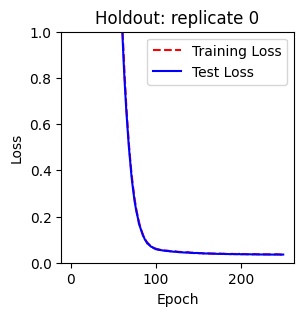

Training with replicate 1 heldout. # samples = 11588
HI
Epoch 1/250
73/73 [==============================] - 1s 6ms/step - loss: 35.7705 - mse: 2.2561 - mae: 1.1801 - val_loss: 33.5635 - val_mse: 0.4977 - val_mae: 0.5800
Epoch 2/250
73/73 [==============================] - 0s 5ms/step - loss: 34.7731 - mse: 2.1300 - mae: 1.1466 - val_loss: 32.8853 - val_mse: 0.6810 - val_mae: 0.6680
Epoch 3/250
73/73 [==============================] - 0s 5ms/step - loss: 33.7974 - mse: 2.0080 - mae: 1.1129 - val_loss: 32.1567 - val_mse: 0.7978 - val_mae: 0.7200
Epoch 4/250
73/73 [==============================] - 0s 5ms/step - loss: 32.8350 - mse: 1.8827 - mae: 1.0762 - val_loss: 31.3960 - val_mse: 0.8655 - val_mae: 0.7462
Epoch 5/250
73/73 [==============================] - 0s 5ms/step - loss: 31.8845 - mse: 1.7528 - mae: 1.0368 - val_loss: 30.6127 - val_mse: 0.8947 - val_mae: 0.7577
Epoch 6/250
73/73 [==============================] - 0s 5ms/step - loss: 30.9328 - mse: 1.6061 - mae: 0.9894 - val_loss

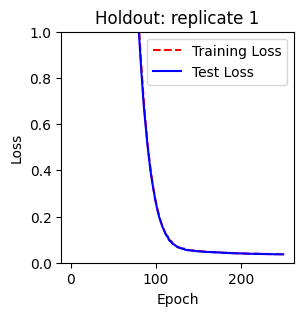

Training with replicate 2 heldout. # samples = 11588
HI
Epoch 1/250
73/73 [==============================] - 1s 6ms/step - loss: 35.7637 - mse: 2.2719 - mae: 1.1900 - val_loss: 33.5422 - val_mse: 0.5025 - val_mae: 0.5788
Epoch 2/250
73/73 [==============================] - 0s 4ms/step - loss: 34.7683 - mse: 2.1545 - mae: 1.1592 - val_loss: 32.8436 - val_mse: 0.6719 - val_mae: 0.6615
Epoch 3/250
73/73 [==============================] - 0s 4ms/step - loss: 33.7929 - mse: 2.0387 - mae: 1.1276 - val_loss: 32.1090 - val_mse: 0.7877 - val_mae: 0.7137
Epoch 4/250
73/73 [==============================] - 0s 6ms/step - loss: 32.8185 - mse: 1.9055 - mae: 1.0882 - val_loss: 31.3449 - val_mse: 0.8552 - val_mae: 0.7394
Epoch 5/250
73/73 [==============================] - 0s 6ms/step - loss: 31.8477 - mse: 1.7575 - mae: 1.0427 - val_loss: 30.6104 - val_mse: 0.9350 - val_mae: 0.7621
Epoch 6/250
73/73 [==============================] - 1s 8ms/step - loss: 30.8840 - mse: 1.6008 - mae: 0.9935 - val_loss

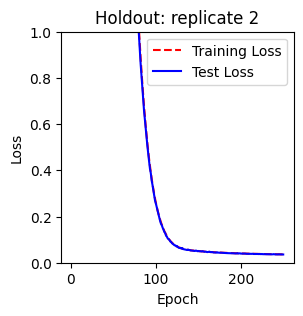

0

In [113]:
imputer.cross_validation_training_kidney(good_metabs, FML = True, tracer = 'glutamine', checkpoints_dir_label = "kidney-glutamine", EPOCHS = 250)

In [114]:
val_glutamine_ground, val_glutamine_predicted = imputer.cross_validation_testing_kidney(good_metabs, FML = True, tracer = 'glutamine', checkpoints_dir_label = "kidney-glutamine")

Inconsistencies found: 0 metabolites, 9 isotopolouges
Removing 3158 isotopolouges
File 0: /kidney-m0-no-log/glutamine-ND-M1-FML-ioncounts-ranks.csv || 0 to drop || 0 dropped
File 1: /kidney-m0-no-log/glutamine-ND-M2-FML-ioncounts-ranks.csv || 0 to drop || 0 dropped
File 2: /kidney-m0-no-log/glutamine-ND-M3-FML-ioncounts-ranks.csv || 0 to drop || 0 dropped
Ion-Data is all consistent! Time to train a model!
File 0: /kidney-m0-no-log/glutamine-ND-M1-FML-isotopolouges-ranks.csv || 3158 to drop || 3158 dropped
File 1: /kidney-m0-no-log/glutamine-ND-M2-FML-isotopolouges-ranks.csv || 3154 to drop || 3154 dropped
File 2: /kidney-m0-no-log/glutamine-ND-M3-FML-isotopolouges-ranks.csv || 3151 to drop || 3151 dropped
Iso-Data is all consistent! Time to train a model!
Testing with replicate 0 heldout. # samples = 11588
363/363 [==============================] - 1s 1ms/step
Testing with replicate 1 heldout. # samples = 15403
482/482 [==============================] - 1s 1ms/step
Testing with replica

In [115]:
print(val_glutamine_ground[0].shape)

(11588, 289)


(37610, 291) (37610, 291)


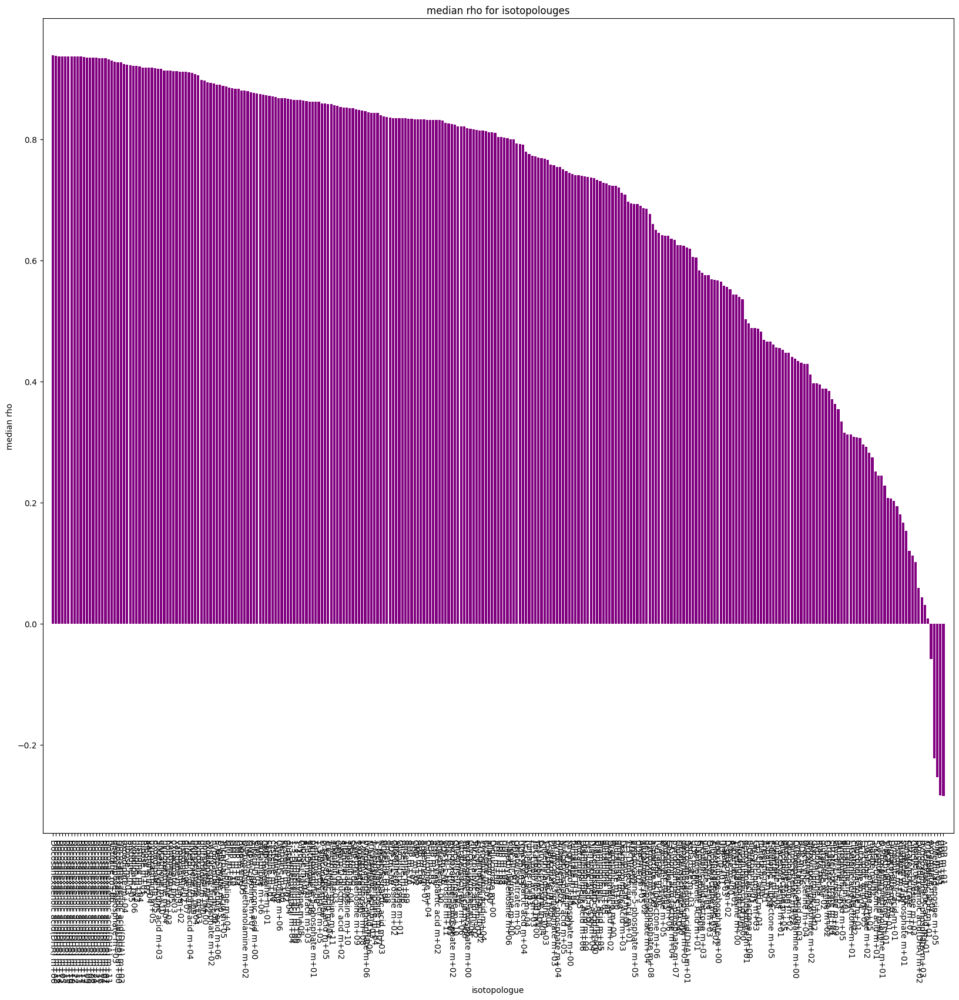

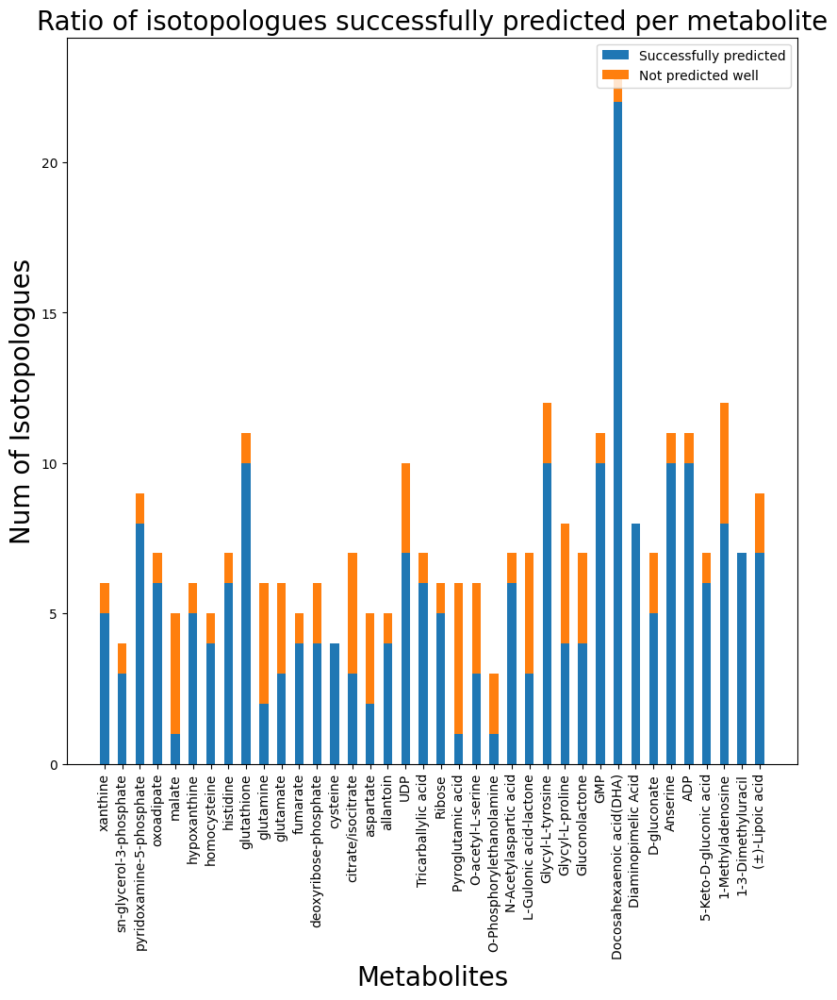

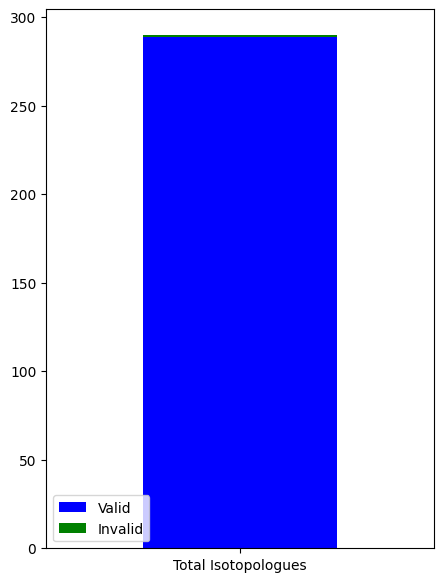

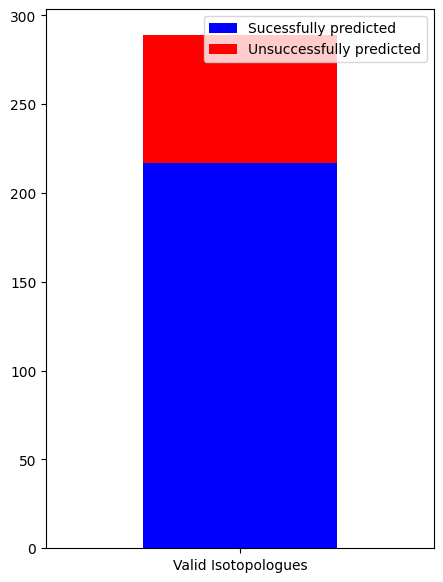

In [129]:
spearmans_glutamine = imputer.cross_validation_eval_metrics(val_glutamine_ground, val_glutamine_predicted, num_bars=38)

In [122]:
print(spearmans_glutamine[0:20])


234    Docosahexaenoic acid(DHA) m+06
246    Docosahexaenoic acid(DHA) m+18
242    Docosahexaenoic acid(DHA) m+14
233    Docosahexaenoic acid(DHA) m+05
243    Docosahexaenoic acid(DHA) m+15
247    Docosahexaenoic acid(DHA) m+19
238    Docosahexaenoic acid(DHA) m+10
250    Docosahexaenoic acid(DHA) m+22
241    Docosahexaenoic acid(DHA) m+13
245    Docosahexaenoic acid(DHA) m+17
240    Docosahexaenoic acid(DHA) m+12
237    Docosahexaenoic acid(DHA) m+09
236    Docosahexaenoic acid(DHA) m+08
248    Docosahexaenoic acid(DHA) m+20
249    Docosahexaenoic acid(DHA) m+21
244    Docosahexaenoic acid(DHA) m+16
232    Docosahexaenoic acid(DHA) m+04
235    Docosahexaenoic acid(DHA) m+07
239    Docosahexaenoic acid(DHA) m+11
76                     histidine m+06
Name: isotopologue, dtype: object


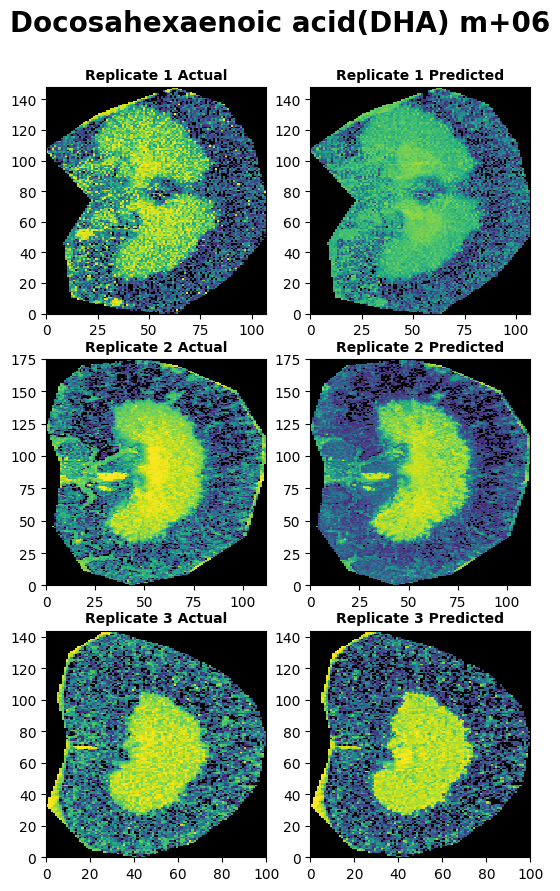

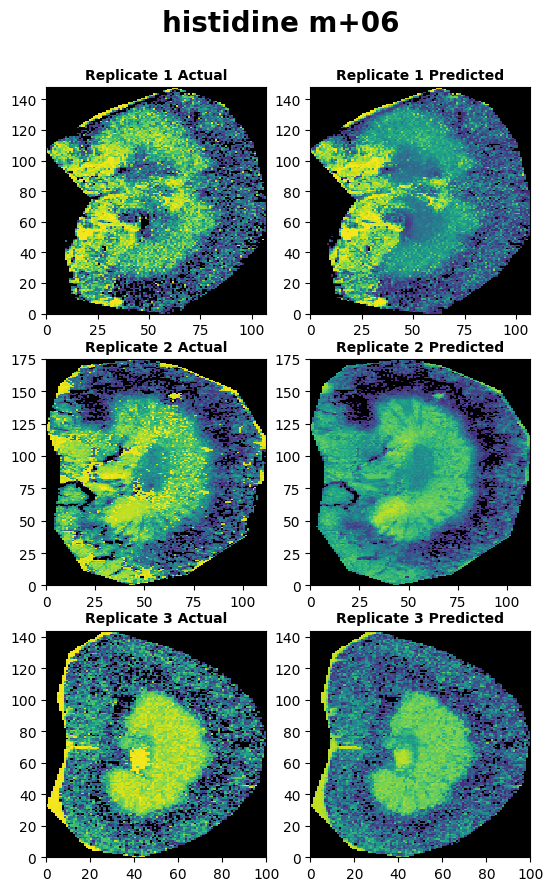

In [123]:
vis.cross_validation_results(val_glutamine_ground, val_glutamine_predicted, coords_df = coords_df_glutamine, iso_to_plot = 'Docosahexaenoic acid(DHA) m+06', limited = True)
vis.cross_validation_results(val_glutamine_ground, val_glutamine_predicted, coords_df = coords_df_glutamine, iso_to_plot = 'histidine m+06', limited = True)


# Lactate

In [131]:
M1_lactate_metab_names = ['Glyoxylic acid', 'Glycolamide', 'glycine', 'Trimethylamine N-oxide', 'Glycocholic acid', 'Glycolic acid', 'Cysteamine', 'pyruvate', 'alanine', 'lactate', '2-hydroxypyridine', 'Tiglic acid', 'acetoacetate', '2-Ketobutyric acid', 'Isovaleric acid', 'dimethylglycine', 'Malonic acid', '2-Hydroxybutyric acid', 'serine', 'Diethanolamine', 'glycerate', 'p-Benzoquinone', 'o-Cresol', 'Hypotaurine', 'Hydroquinone', 'cytosine', 'Histamine', '3-Furoic acid', 'uracil', 'Creatinine', 'Dihydrouracil', 'proline', 'fumarate', '2-Oxoisopentanoic acid', '4-Methylvaleric acid', 'N-Acetylglycine', 'Guanidoacetic acid', 'indole', 'betaine', 'succinate', '2-Hydroxyvaleric acid', 'Aminomalonic acid', 'homoserine', 'purine', 'cysteine', 'Benzoic acid', 'nicotinamide', 'nicotinate', 'Guaiacol', 'taurine', '5-Methylcytosine', 'thymine', '5-6-Dihydro Thymine', 'Pyroglutamic acid', 'DL-Pipecolic acid', 'Glutaconic acid', 'Methyloxovaleric acid (Ketoleucine)', 'N-Acetylputrescine', 'hydroxyproline', 'creatine', '3-Methylindole', 'leucine', 'Glutaric acid', 'asparagine', '2-Hydroxycaproic acid', 'ornithine', 'aspartate', 'malate', '2-Deoxy-D-ribose', 'homocysteine', 'adenine', 'L-Threonic acid', 'hypoxanthine', "N'-Methylnicotinamide", 'anthranilate', 'Phenylethanolamine', '3-Hydroxybenzoic acid', 'Urocanic acid', '6-Hydroxynicotinic acid', 'acetylphosphate', '1-3-Dimethyluracil', 'O-Phosphorylethanolamine', '5-Hydroxymethyluracil', '3-Methylglutaconic Acid', 'trans-4-Hydroxycyclohexanecarboxylic Acid', 'N-(5-Aminopentyl)acetamide', 'N-Butyrylglycine', '4-Guanidinobutanoic acid', 'Acetylcholine', 'a-ketoglutarate', 'Adipic acid', 'glutamine', 'lysine', 'glutamate', '2-hydroxyglutarate', 'methionine', 'Triethanolamine', 'Tartaric acid', 'Phenylglyoxylic acid', 'Ribose', '2-Phenylpropionic acid', 'guanine', 'N-Methyltyramine', 'xanthine', 'Mandelic acid', 'Adonitol', '3-Hydroxyanthranilic acid', 'Dopamine', 'Gentisic acid', 'histidine', '2-5-Furandicarboxylic acid', 'orotate', 'N-Tiglylglycine', 'L-Hydroorotic acid', 'allantoin', '4-6-Dioxoheptanoic acid', 'Indole-3-acetaldehyde', '2-Methylbutyrylglycine', 'Pargyline', 'DL-2-Aminooctanoic acid', 'oxoadipate', 'Pimelic acid', 'Tryptamine', '2-Hydroxyoctanoic acid', 'Indole-2-carboxylic acid', 'Aminoadipic acid', 'Indole-3-ethanol', 'carnitine', '2-Hydroxyhexanedioic Acid', 'DL-5-Hydroxylysine', '6-Dimethylaminopurine', 'phenylpyruvate', 'L-Fucose', '2-Phenylbutyric acid', 'Methionine sulfoxide', 'phenylalanine', 'L-(?)-3-Phenyllactic acid', 'D-Phenyllactic acid', 'quinolinate', 'Pyridoxal', 'Synephrine', '3-Methoxytyramine', 'PEP', 'Uric acid', 'Homogentisic acid', 'Pyridoxamine', 'L-Cysteic acid', '2-Amino-3-phosphonopropionic acid', '2-Furoylglycine', 'pyridoxine', '1-Methyl-Histidine', 'D-glyceraldehdye-3-phosphate', 'Diethylthiophosphate', 'sn-glycerol-3-phosphate', 'Menadione', 'Glycyl-L-proline', 'Quinaldic acid', 'Hexanoyl Glycine', 'aconitate', 'Shikimic acid', 'Suberic acid', 'arginine', 'N-Acetylaspartic acid', 'Indole-3-acetic acid', 'citrulline', 'Tricarballylic acid', 'N-carbamoyl-L-aspartate', '2-Isopropylmalic acid', 'Serotonin', 'N-Formyl-L-methionine', 'L-Gulonic acid-lactone', 'Gluconolactone', '5-Phenylvaleric acid', 'Isoxanthopterin', 'hydroxyphenylpyruvate', 'Nicotinuric acid', 'Glucose', '3-(3-Methoxyphenyl)propionic acid', 'tyrosine', 'Hydroxyphenyllactic acid', '4-Pyridoxic acid', 'Phosphorylcholine', 'DL -3-4-Dihydroxymandelic acid', 'Phosphoserine', 'Undecanoic acid', 'trans-3-Indoleacrylic acid', 'Glycyl-L-leucine', 'Homoarginine', 'N6-N6-N6-Trimethyllysine', 'Kynurenic acid', 'N-acetyl-glutamate', '3-Indolepropionic acid', 'Homocitrulline', 'Diaminopimelic Acid', '5-Methoxytryptamine', 'Hydroxyindoleacetic acid', 'N-Acetyl-L-methionine', 'citrate/isocitrate', 'Quinic acid', 'Phenylacetylglycine', '5-Keto-D-gluconic acid', '4-Aminohippuric acid', '2-Hydroxy Hippuric Acid', 'D-gluconate', '3-4-Dimethoxyphenylacetic acid', 'L-Dopa', 'DL-4-Hydroxy-3-methoxymandelic acid', 'O-phosphohomoserine', 'D-erythrose-4-phosphate', 'Cysteine S-sulfate', 'Capryloyl glycine', 'Sebacic acid', 'Indole-3-pyruvic acid', '3-Indolebutyric acid', 'N-Acetylcarnitine', 'tryptophan', 'Xanthurenic acid', 'DL-Indole-3-lactic acid', '(±)-Lipoic acid', 'N-Acetyl-L-phenylalanine', 'DL-Benzylsuccinic acid', 'L-Kynurenine', 'Mucic acid', 'Creatine phosphate', '3-Indoxyl sulfate', 'deoxyribose-phosphate', 'N-Acetylserotonin', 'pantothenate', '5-L-Hydroxytryptophan', '?-N-Acetylglucosamine', 'cystathionine', 'N-Acetyltyrosine', '3-Nitro-L- tyrosine', 'Carnosine', 'deoxyuridine', 'Myristic acid', 'ribose-phosphate', 'Suberyl Glycine', 'Melatonin', '5-Methoxytryptophan', 'Sepiapterin', '3-4-5-Trimethoxycinnamic acid', 'Glycyl-L-tyrosine', 'Anserine', 'thymidine', 'cytidine', 'uridine', 'biotin', 'Pyridoxal 5-phosphate', 'pyridoxamine-5-phosphate', 'Muramic acid', 'deoxyadenosine', 'deoxyinosine', 'Ribothymidine', 'glucosamine-6-phosphate', 'glucose-1-phosphate', 'Mannitol-1-phosphate', 'adenosine', 'homocystine', 'inosine', 'L-Aspartyl-L-phenylalanine', 'Linoleic acid', '1-Methyladenosine', 'guanosine', 'xanthosine', 'Stearic acid', "5'-Methylthioadenosine", '7-methylguanosine', 'Retinoic Acid', 'elcosapentaenoic acid', 'dCMP', 'glutathione', 'dUMP', 'N-Acetylneuraminic acid', 'Arachidic acid', 'CMP', 'UMP', 'Docosahexaenoic acid(DHA)', 'cyclic-AMP', 'dAMP', 'fructose-1-6-bisphosphate', 'Sucrose', 'AMP', 'dGMP', 'IMP', 'GMP', 'riboflavin', 'Lithocholic acid', 'S-adenosyl-L-homoCysteine', 'dCDP', 'Chenodeoxycholic acid', 'S-Adenosylmethionine', 'dTDP', 'CDP', 'UDP', 'Cholic acid', 'trehalose-6-Phosphate', 'Cysteine-glutathione disulphide', "adenosine 5'-phosphosulfate", 'ADP', 'IDP', 'folate', 'GDP', 'Glycodeoxycholic acid', 'Glycoursodeoxycholic acid', 'FMN', '5-methyl-THF', 'dCTP', 'dUTP', 'Folinic acid', 'dTTP', 'CTP', 'UTP', 'CDP-choline', 'dATP', 'Taurodeoxycholic acid', 'ATP', 'Inosine 5-triphosphate', 'GTP', 'Cyclic-ADP-ribose', 'D-Pantethine', 'UDP-D-glucose', 'Bilirubin', 'ADP-D-glucose', 'glutathione disulfide', 'NAD+', 'NADH', 'dephospho-CoA', 'NADP+', 'NADPH', 'coenzyme A', 'hyaluronate', 'FAD', 'acetyl-CoA', 'propionyl-CoA', 'butyryl-CoA', 'acetoacetyl-CoA', 'malonyl-CoA', 'Butyric acid', 'N-Acetyl-cysteine', 'N-Acetyl-L-arginine', 'N-Acetyl-L-asparagine', 'N-acetyl-L-glutamine', 'N-Acetyl-L-leucine', 'N-Acetyl-L-isoleucine', 'N-acetyl-L-ornithine', 'N-Acetyl-L-phenylalanine m', 'N-Acetyl-L-proline', 'O-acetyl-L-serine', 'Ala-Ala', 'Glycerophosphocholine', '2-Furoylglycine m', 'N-Iso valerylglycine', 'x', 'y']
M1_lactate_moransi_scores = [0.5995, 0.6051, 0.5914, 0.6004, 0.6545, 0.5947, 0.6005, 0.4884, 0.5109, 0.5089, 0.6222, 0.6221, 0.5084, 0.5085, 0.6216, 0.4777, 0.5447, 0.6142, 0.4505, 0.6219, 0.6229, 0.6366, 0.6379, 0.598, 0.6322, 0.6353, 0.63, 0.7417, 0.5341, 0.6278, 0.5646, 0.6236, 0.7604, 0.6034, 0.6379, 0.5464, 0.6137, 0.6431, 0.6351, 0.4925, 0.6361, 0.6235, 0.483, 0.6038, 0.9057, 0.6438, 0.6359, 0.6403, 0.6436, 0.628, 0.6388, 0.605, 0.519, 0.8883, 0.6367, 0.501, 0.6389, 0.6369, 0.4996, 0.6625, 0.6527, 0.6399, 0.5364, 0.439, 0.6453, 0.6282, 0.7933, 0.8452, 0.6277, 0.8169, 0.5914, 0.5958, 0.8168, 0.6448, 0.6358, 0.6493, 0.6409, 0.6495, 0.5932, 0.4634, 0.7196, 0.8052, 0.6348, 0.5361, 0.6478, 0.6425, 0.5803, 0.6446, 0.6462, 0.6292, 0.6289, 0.8794, 0.6358, 0.7128, 0.6618, 0.6419, 0.6396, 0.6363, 0.6272, 0.7357, 0.6527, 0.5159, 0.6516, 0.7651, 0.6237, 0.6442, 0.6209, 0.6484, 0.6046, 0.75, 0.6317, 0.6387, 0.642, 0.6309, 0.7595, 0.623, 0.6548, 0.6431, 0.6557, 0.646, 0.8309, 0.6433, 0.6512, 0.6506, 0.648, 0.5364, 0.6556, 0.6501, 0.5137, 0.6355, 0.6466, 0.6518, 0.6422, 0.659, 0.6143, 0.6114, 0.6329, 0.64, 0.6482, 0.6137, 0.6585, 0.6588, 0.5454, 0.5107, 0.5979, 0.6546, 0.5372, 0.5836, 0.629, 0.6242, 0.6463, 0.4809, 0.6541, 0.8831, 0.6548, 0.9119, 0.6493, 0.6045, 0.7228, 0.5999, 0.6532, 0.618, 0.7055, 0.655, 0.5599, 0.7437, 0.6427, 0.6432, 0.655, 0.6022, 0.7581, 0.7585, 0.6543, 0.6817, 0.61, 0.5583, 0.6245, 0.6287, 0.6361, 0.6312, 0.8843, 0.6169, 0.5177, 0.541, 0.6577, 0.6541, 0.6891, 0.6479, 0.6536, 0.6493, 0.6663, 0.6573, 0.6483, 0.6623, 0.6595, 0.6435, 0.5832, 0.7629, 0.6422, 0.6262, 0.8661, 0.6332, 0.5469, 0.8871, 0.6431, 0.5655, 0.549, 0.6258, 0.5941, 0.6464, 0.6571, 0.6575, 0.642, 0.658, 0.6569, 0.6554, 0.6243, 0.6339, 0.6299, 0.6666, 0.6391, 0.6409, 0.5704, 0.6416, 0.6367, 0.9009, 0.6568, 0.6257, 0.6395, 0.6282, 0.6355, 0.6582, 0.6131, 0.6353, 0.6493, 0.6628, 0.5112, 0.6543, 0.658, 0.6387, 0.6459, 0.6623, 0.7955, 0.7039, 0.6407, 0.6435, 0.5209, 0.6451, 0.6463, 0.8728, 0.6619, 0.66, 0.6468, 0.6203, 0.5782, 0.6711, 0.5958, 0.6177, 0.6443, 0.8547, 0.5246, 0.6358, 0.6265, 0.6328, 0.6517, 0.605, 0.6301, 0.6627, 0.6665, 0.6714, 0.6598, 0.8587, 0.6497, 0.5303, 0.6683, 0.6383, 0.5885, 0.7434, 0.6453, 0.6433, 0.622, 0.6783, 0.6257, 0.6257, 0.6759, 0.6877, 0.6766, 0.6687, 0.798, 0.6661, 0.6688, 0.7758, 0.6622, 0.6658, 0.6975, 0.6678, 0.6657, 0.6608, 0.6664, 0.7604, 0.6654, 0.6664, 0.6641, 0.6696, 0.6696, 0.6661, 0.7505, 0.6659, 0.6667, 0.666, 0.6657, 0.667, 0.6651, 0.6672, 0.6657, 0.671, 0.6828, 0.6681, 0.6667, 0.6688, 0.6694, 0.6668, 0.6712, 0.6674, 0.6688, 0.6695, 0.6684, 0.6696, 0.6713, 0.6707, 0.6698, 0.6712, 0.6711, 0.6703, 0.6716, 0.6714, 0.6719, 0.6719, 0.5971, 0.5697, 0.659, 0.6238, 0.5515, 0.6045, 0.6045, 0.6306, 0.6666, 0.6359, 0.7128, 0.7465, 0.6544, 0.6291, 0.6402]
M2_lactate_metab_names = ['Glyoxylic acid', 'Glycolamide', 'glycine', 'Trimethylamine N-oxide', 'Glycocholic acid', 'Glycolic acid', 'Cysteamine', 'pyruvate', 'alanine', 'lactate', '2-hydroxypyridine', 'Tiglic acid', 'acetoacetate', '2-Ketobutyric acid', 'Isovaleric acid', 'dimethylglycine', 'Malonic acid', '2-Hydroxybutyric acid', 'serine', 'Diethanolamine', 'glycerate', 'p-Benzoquinone', 'o-Cresol', 'Hypotaurine', 'Hydroquinone', 'cytosine', 'Histamine', '3-Furoic acid', 'uracil', 'Creatinine', 'Dihydrouracil', 'proline', 'fumarate', '2-Oxoisopentanoic acid', '4-Methylvaleric acid', 'N-Acetylglycine', 'Guanidoacetic acid', 'indole', 'betaine', 'succinate', '2-Hydroxyvaleric acid', 'Aminomalonic acid', 'homoserine', 'purine', 'cysteine', 'Benzoic acid', 'nicotinamide', 'nicotinate', 'Guaiacol', 'taurine', '5-Methylcytosine', 'thymine', '5-6-Dihydro Thymine', 'Pyroglutamic acid', 'DL-Pipecolic acid', 'Glutaconic acid', 'Methyloxovaleric acid (Ketoleucine)', 'N-Acetylputrescine', 'hydroxyproline', 'creatine', '3-Methylindole', 'leucine', 'Glutaric acid', 'asparagine', '2-Hydroxycaproic acid', 'ornithine', 'aspartate', 'malate', '2-Deoxy-D-ribose', 'homocysteine', 'adenine', 'L-Threonic acid', 'hypoxanthine', "N'-Methylnicotinamide", 'anthranilate', 'Phenylethanolamine', '3-Hydroxybenzoic acid', 'Urocanic acid', '6-Hydroxynicotinic acid', 'acetylphosphate', '1-3-Dimethyluracil', 'O-Phosphorylethanolamine', '5-Hydroxymethyluracil', '3-Methylglutaconic Acid', 'trans-4-Hydroxycyclohexanecarboxylic Acid', 'N-(5-Aminopentyl)acetamide', 'N-Butyrylglycine', '4-Guanidinobutanoic acid', 'Acetylcholine', 'a-ketoglutarate', 'Adipic acid', 'glutamine', 'lysine', 'glutamate', '2-hydroxyglutarate', 'methionine', 'Triethanolamine', 'Tartaric acid', 'Phenylglyoxylic acid', 'Ribose', '2-Phenylpropionic acid', 'guanine', 'N-Methyltyramine', 'xanthine', 'Mandelic acid', 'Adonitol', '3-Hydroxyanthranilic acid', 'Dopamine', 'Gentisic acid', 'histidine', '2-5-Furandicarboxylic acid', 'orotate', 'N-Tiglylglycine', 'L-Hydroorotic acid', 'allantoin', '4-6-Dioxoheptanoic acid', 'Indole-3-acetaldehyde', '2-Methylbutyrylglycine', 'Pargyline', 'DL-2-Aminooctanoic acid', 'oxoadipate', 'Pimelic acid', 'Tryptamine', '2-Hydroxyoctanoic acid', 'Indole-2-carboxylic acid', 'Aminoadipic acid', 'Indole-3-ethanol', 'carnitine', '2-Hydroxyhexanedioic Acid', 'DL-5-Hydroxylysine', '6-Dimethylaminopurine', 'phenylpyruvate', 'L-Fucose', '2-Phenylbutyric acid', 'Methionine sulfoxide', 'phenylalanine', 'L-(?)-3-Phenyllactic acid', 'D-Phenyllactic acid', 'quinolinate', 'Pyridoxal', 'Synephrine', '3-Methoxytyramine', 'PEP', 'Uric acid', 'Homogentisic acid', 'Pyridoxamine', 'L-Cysteic acid', '2-Amino-3-phosphonopropionic acid', '2-Furoylglycine', 'pyridoxine', '1-Methyl-Histidine', 'D-glyceraldehdye-3-phosphate', 'Diethylthiophosphate', 'sn-glycerol-3-phosphate', 'Menadione', 'Glycyl-L-proline', 'Quinaldic acid', 'Hexanoyl Glycine', 'aconitate', 'Shikimic acid', 'Suberic acid', 'arginine', 'N-Acetylaspartic acid', 'Indole-3-acetic acid', 'citrulline', 'Tricarballylic acid', 'N-carbamoyl-L-aspartate', '2-Isopropylmalic acid', 'Serotonin', 'N-Formyl-L-methionine', 'L-Gulonic acid-lactone', 'Gluconolactone', '5-Phenylvaleric acid', 'Isoxanthopterin', 'hydroxyphenylpyruvate', 'Nicotinuric acid', 'Glucose', '3-(3-Methoxyphenyl)propionic acid', 'tyrosine', 'Hydroxyphenyllactic acid', '4-Pyridoxic acid', 'Phosphorylcholine', 'DL -3-4-Dihydroxymandelic acid', 'Phosphoserine', 'Undecanoic acid', 'trans-3-Indoleacrylic acid', 'Glycyl-L-leucine', 'Homoarginine', 'N6-N6-N6-Trimethyllysine', 'Kynurenic acid', 'N-acetyl-glutamate', '3-Indolepropionic acid', 'Homocitrulline', 'Diaminopimelic Acid', '5-Methoxytryptamine', 'Hydroxyindoleacetic acid', 'N-Acetyl-L-methionine', 'citrate/isocitrate', 'Quinic acid', 'Phenylacetylglycine', '5-Keto-D-gluconic acid', '4-Aminohippuric acid', '2-Hydroxy Hippuric Acid', 'D-gluconate', '3-4-Dimethoxyphenylacetic acid', 'L-Dopa', 'DL-4-Hydroxy-3-methoxymandelic acid', 'O-phosphohomoserine', 'D-erythrose-4-phosphate', 'Cysteine S-sulfate', 'Capryloyl glycine', 'Sebacic acid', 'Indole-3-pyruvic acid', '3-Indolebutyric acid', 'N-Acetylcarnitine', 'tryptophan', 'Xanthurenic acid', 'DL-Indole-3-lactic acid', '(±)-Lipoic acid', 'N-Acetyl-L-phenylalanine', 'DL-Benzylsuccinic acid', 'L-Kynurenine', 'Mucic acid', 'Creatine phosphate', '3-Indoxyl sulfate', 'deoxyribose-phosphate', 'N-Acetylserotonin', 'pantothenate', '5-L-Hydroxytryptophan', '?-N-Acetylglucosamine', 'cystathionine', 'N-Acetyltyrosine', '3-Nitro-L- tyrosine', 'Carnosine', 'deoxyuridine', 'Myristic acid', 'ribose-phosphate', 'Suberyl Glycine', 'Melatonin', '5-Methoxytryptophan', 'Sepiapterin', '3-4-5-Trimethoxycinnamic acid', 'Glycyl-L-tyrosine', 'Anserine', 'thymidine', 'cytidine', 'uridine', 'biotin', 'Pyridoxal 5-phosphate', 'pyridoxamine-5-phosphate', 'Muramic acid', 'deoxyadenosine', 'deoxyinosine', 'Ribothymidine', 'glucosamine-6-phosphate', 'glucose-1-phosphate', 'Mannitol-1-phosphate', 'adenosine', 'homocystine', 'inosine', 'L-Aspartyl-L-phenylalanine', 'Linoleic acid', '1-Methyladenosine', 'guanosine', 'xanthosine', 'Stearic acid', "5'-Methylthioadenosine", '7-methylguanosine', 'Retinoic Acid', 'elcosapentaenoic acid', 'dCMP', 'glutathione', 'dUMP', 'N-Acetylneuraminic acid', 'Arachidic acid', 'CMP', 'UMP', 'Docosahexaenoic acid(DHA)', 'cyclic-AMP', 'dAMP', 'fructose-1-6-bisphosphate', 'Sucrose', 'AMP', 'dGMP', 'IMP', 'GMP', 'riboflavin', 'Lithocholic acid', 'S-adenosyl-L-homoCysteine', 'dCDP', 'Chenodeoxycholic acid', 'S-Adenosylmethionine', 'dTDP', 'CDP', 'UDP', 'Cholic acid', 'trehalose-6-Phosphate', 'Cysteine-glutathione disulphide', "adenosine 5'-phosphosulfate", 'ADP', 'IDP', 'folate', 'GDP', 'Glycodeoxycholic acid', 'Glycoursodeoxycholic acid', 'FMN', '5-methyl-THF', 'dCTP', 'dUTP', 'Folinic acid', 'dTTP', 'CTP', 'UTP', 'CDP-choline', 'dATP', 'Taurodeoxycholic acid', 'ATP', 'Inosine 5-triphosphate', 'GTP', 'Cyclic-ADP-ribose', 'D-Pantethine', 'UDP-D-glucose', 'Bilirubin', 'ADP-D-glucose', 'glutathione disulfide', 'NAD+', 'NADH', 'dephospho-CoA', 'NADP+', 'NADPH', 'coenzyme A', 'hyaluronate', 'FAD', 'acetyl-CoA', 'propionyl-CoA', 'butyryl-CoA', 'acetoacetyl-CoA', 'malonyl-CoA', 'Butyric acid', 'N-Acetyl-cysteine', 'N-Acetyl-L-arginine', 'N-Acetyl-L-asparagine', 'N-acetyl-L-glutamine', 'N-Acetyl-L-leucine', 'N-Acetyl-L-isoleucine', 'N-acetyl-L-ornithine', 'N-Acetyl-L-phenylalanine m', 'N-Acetyl-L-proline', 'O-acetyl-L-serine', 'Ala-Ala', 'Glycerophosphocholine', '2-Furoylglycine m', 'N-Iso valerylglycine', 'x', 'y']
M2_lactate_moransi_scores = [0.5915, 0.5981, 0.6097, 0.6003, 0.6483, 0.5756, 0.5915, 0.5802, 0.5052, 0.6134, 0.6091, 0.5943, 0.4873, 0.4872, 0.6178, 0.523, 0.4957, 0.5992, 0.5028, 0.6143, 0.5961, 0.6296, 0.6104, 0.5638, 0.6149, 0.6278, 0.63, 0.6863, 0.5242, 0.6182, 0.5351, 0.5647, 0.7411, 0.5483, 0.6131, 0.5747, 0.5712, 0.6276, 0.6222, 0.6653, 0.6187, 0.6251, 0.5179, 0.5433, 0.879, 0.6291, 0.641, 0.621, 0.6344, 0.7627, 0.6248, 0.554, 0.6134, 0.8963, 0.6067, 0.5397, 0.6197, 0.6337, 0.5514, 0.6776, 0.6482, 0.6342, 0.5313, 0.4955, 0.6899, 0.6037, 0.8815, 0.8707, 0.6227, 0.8239, 0.6529, 0.6274, 0.8239, 0.6358, 0.5831, 0.6443, 0.6, 0.6757, 0.4497, 0.5571, 0.7583, 0.8363, 0.5721, 0.5566, 0.6085, 0.638, 0.549, 0.6358, 0.6423, 0.5349, 0.5648, 0.9022, 0.561, 0.7116, 0.7213, 0.6197, 0.6397, 0.5057, 0.602, 0.702, 0.6476, 0.6606, 0.6399, 0.7688, 0.6115, 0.5913, 0.575, 0.611, 0.5766, 0.7084, 0.5688, 0.6002, 0.6617, 0.5439, 0.7667, 0.6076, 0.6373, 0.5869, 0.6223, 0.6415, 0.7825, 0.6125, 0.6526, 0.6418, 0.6169, 0.5973, 0.6454, 0.6513, 0.5375, 0.6614, 0.6534, 0.5353, 0.5885, 0.6439, 0.5061, 0.6686, 0.4664, 0.5471, 0.6211, 0.5174, 0.6462, 0.6461, 0.6589, 0.6157, 0.5154, 0.618, 0.5636, 0.5911, 0.5533, 0.5094, 0.6037, 0.6152, 0.5861, 0.9407, 0.6345, 0.9393, 0.5913, 0.677, 0.687, 0.5295, 0.6126, 0.6153, 0.7719, 0.6436, 0.5836, 0.729, 0.5353, 0.5715, 0.6357, 0.6593, 0.7344, 0.7353, 0.6431, 0.777, 0.5678, 0.5165, 0.6852, 0.5375, 0.5929, 0.5496, 0.614, 0.6786, 0.5193, 0.6799, 0.6507, 0.5923, 0.7466, 0.645, 0.6493, 0.5531, 0.652, 0.602, 0.6013, 0.707, 0.6483, 0.5915, 0.5948, 0.7858, 0.6172, 0.6405, 0.9211, 0.6202, 0.4874, 0.9317, 0.5926, 0.5336, 0.595, 0.4613, 0.6193, 0.6372, 0.6442, 0.6468, 0.6349, 0.6265, 0.6428, 0.6017, 0.6006, 0.6103, 0.5635, 0.6448, 0.5442, 0.5979, 0.7175, 0.6024, 0.6045, 0.8603, 0.616, 0.5551, 0.6399, 0.635, 0.5789, 0.6187, 0.5101, 0.6267, 0.5143, 0.6484, 0.5896, 0.6185, 0.6517, 0.595, 0.5615, 0.6155, 0.8179, 0.6795, 0.5779, 0.6025, 0.5441, 0.5686, 0.5794, 0.8847, 0.6805, 0.5854, 0.5186, 0.6219, 0.5591, 0.6819, 0.7176, 0.5611, 0.531, 0.8442, 0.5749, 0.5966, 0.6106, 0.5904, 0.5852, 0.5483, 0.5732, 0.6422, 0.6639, 0.7119, 0.618, 0.8577, 0.542, 0.5696, 0.6643, 0.6841, 0.6224, 0.7218, 0.6034, 0.5873, 0.5782, 0.6061, 0.7179, 0.7179, 0.8206, 0.7409, 0.7012, 0.6676, 0.6998, 0.6521, 0.6669, 0.6965, 0.5888, 0.6537, 0.6877, 0.6658, 0.6644, 0.6561, 0.6655, 0.7285, 0.6649, 0.6046, 0.6492, 0.6673, 0.6673, 0.6342, 0.6904, 0.6656, 0.6655, 0.559, 0.6605, 0.6616, 0.6561, 0.6574, 0.6661, 0.6501, 0.7038, 0.666, 0.6641, 0.6649, 0.6652, 0.6642, 0.6663, 0.6642, 0.665, 0.6637, 0.6648, 0.665, 0.6658, 0.6646, 0.666, 0.6671, 0.6651, 0.6663, 0.6663, 0.6657, 0.665, 0.6668, 0.5669, 0.7201, 0.6441, 0.5487, 0.5167, 0.677, 0.677, 0.6201, 0.6448, 0.6551, 0.7116, 0.787, 0.5964, 0.5538, 0.5692]
M3_lactate_metab_names = ['Glyoxylic acid', 'Glycolamide', 'glycine', 'Trimethylamine N-oxide', 'Glycocholic acid', 'Glycolic acid', 'Cysteamine', 'pyruvate', 'alanine', 'lactate', '2-hydroxypyridine', 'Tiglic acid', 'acetoacetate', '2-Ketobutyric acid', 'Isovaleric acid', 'dimethylglycine', 'Malonic acid', '2-Hydroxybutyric acid', 'serine', 'Diethanolamine', 'glycerate', 'p-Benzoquinone', 'o-Cresol', 'Hypotaurine', 'Hydroquinone', 'cytosine', 'Histamine', '3-Furoic acid', 'uracil', 'Creatinine', 'Dihydrouracil', 'proline', 'fumarate', '2-Oxoisopentanoic acid', '4-Methylvaleric acid', 'N-Acetylglycine', 'Guanidoacetic acid', 'indole', 'betaine', 'succinate', '2-Hydroxyvaleric acid', 'Aminomalonic acid', 'homoserine', 'purine', 'cysteine', 'Benzoic acid', 'nicotinamide', 'nicotinate', 'Guaiacol', 'taurine', '5-Methylcytosine', 'thymine', '5-6-Dihydro Thymine', 'Pyroglutamic acid', 'DL-Pipecolic acid', 'Glutaconic acid', 'Methyloxovaleric acid (Ketoleucine)', 'N-Acetylputrescine', 'hydroxyproline', 'creatine', '3-Methylindole', 'leucine', 'Glutaric acid', 'asparagine', '2-Hydroxycaproic acid', 'ornithine', 'aspartate', 'malate', '2-Deoxy-D-ribose', 'homocysteine', 'adenine', 'L-Threonic acid', 'hypoxanthine', "N'-Methylnicotinamide", 'anthranilate', 'Phenylethanolamine', '3-Hydroxybenzoic acid', 'Urocanic acid', '6-Hydroxynicotinic acid', 'acetylphosphate', '1-3-Dimethyluracil', 'O-Phosphorylethanolamine', '5-Hydroxymethyluracil', '3-Methylglutaconic Acid', 'trans-4-Hydroxycyclohexanecarboxylic Acid', 'N-(5-Aminopentyl)acetamide', 'N-Butyrylglycine', '4-Guanidinobutanoic acid', 'Acetylcholine', 'a-ketoglutarate', 'Adipic acid', 'glutamine', 'lysine', 'glutamate', '2-hydroxyglutarate', 'methionine', 'Triethanolamine', 'Tartaric acid', 'Phenylglyoxylic acid', 'Ribose', '2-Phenylpropionic acid', 'guanine', 'N-Methyltyramine', 'xanthine', 'Mandelic acid', 'Adonitol', '3-Hydroxyanthranilic acid', 'Dopamine', 'Gentisic acid', 'histidine', '2-5-Furandicarboxylic acid', 'orotate', 'N-Tiglylglycine', 'L-Hydroorotic acid', 'allantoin', '4-6-Dioxoheptanoic acid', 'Indole-3-acetaldehyde', '2-Methylbutyrylglycine', 'Pargyline', 'DL-2-Aminooctanoic acid', 'oxoadipate', 'Pimelic acid', 'Tryptamine', '2-Hydroxyoctanoic acid', 'Indole-2-carboxylic acid', 'Aminoadipic acid', 'Indole-3-ethanol', 'carnitine', '2-Hydroxyhexanedioic Acid', 'DL-5-Hydroxylysine', '6-Dimethylaminopurine', 'phenylpyruvate', 'L-Fucose', '2-Phenylbutyric acid', 'Methionine sulfoxide', 'phenylalanine', 'L-(?)-3-Phenyllactic acid', 'D-Phenyllactic acid', 'quinolinate', 'Pyridoxal', 'Synephrine', '3-Methoxytyramine', 'PEP', 'Uric acid', 'Homogentisic acid', 'Pyridoxamine', 'L-Cysteic acid', '2-Amino-3-phosphonopropionic acid', '2-Furoylglycine', 'pyridoxine', '1-Methyl-Histidine', 'D-glyceraldehdye-3-phosphate', 'Diethylthiophosphate', 'sn-glycerol-3-phosphate', 'Menadione', 'Glycyl-L-proline', 'Quinaldic acid', 'Hexanoyl Glycine', 'aconitate', 'Shikimic acid', 'Suberic acid', 'arginine', 'N-Acetylaspartic acid', 'Indole-3-acetic acid', 'citrulline', 'Tricarballylic acid', 'N-carbamoyl-L-aspartate', '2-Isopropylmalic acid', 'Serotonin', 'N-Formyl-L-methionine', 'L-Gulonic acid-lactone', 'Gluconolactone', '5-Phenylvaleric acid', 'Isoxanthopterin', 'hydroxyphenylpyruvate', 'Nicotinuric acid', 'Glucose', '3-(3-Methoxyphenyl)propionic acid', 'tyrosine', 'Hydroxyphenyllactic acid', '4-Pyridoxic acid', 'Phosphorylcholine', 'DL -3-4-Dihydroxymandelic acid', 'Phosphoserine', 'Undecanoic acid', 'trans-3-Indoleacrylic acid', 'Glycyl-L-leucine', 'Homoarginine', 'N6-N6-N6-Trimethyllysine', 'Kynurenic acid', 'N-acetyl-glutamate', '3-Indolepropionic acid', 'Homocitrulline', 'Diaminopimelic Acid', '5-Methoxytryptamine', 'Hydroxyindoleacetic acid', 'N-Acetyl-L-methionine', 'citrate/isocitrate', 'Quinic acid', 'Phenylacetylglycine', '5-Keto-D-gluconic acid', '4-Aminohippuric acid', '2-Hydroxy Hippuric Acid', 'D-gluconate', '3-4-Dimethoxyphenylacetic acid', 'L-Dopa', 'DL-4-Hydroxy-3-methoxymandelic acid', 'O-phosphohomoserine', 'D-erythrose-4-phosphate', 'Cysteine S-sulfate', 'Capryloyl glycine', 'Sebacic acid', 'Indole-3-pyruvic acid', '3-Indolebutyric acid', 'N-Acetylcarnitine', 'tryptophan', 'Xanthurenic acid', 'DL-Indole-3-lactic acid', '(±)-Lipoic acid', 'N-Acetyl-L-phenylalanine', 'DL-Benzylsuccinic acid', 'L-Kynurenine', 'Mucic acid', 'Creatine phosphate', '3-Indoxyl sulfate', 'deoxyribose-phosphate', 'N-Acetylserotonin', 'pantothenate', '5-L-Hydroxytryptophan', '?-N-Acetylglucosamine', 'cystathionine', 'N-Acetyltyrosine', '3-Nitro-L- tyrosine', 'Carnosine', 'deoxyuridine', 'Myristic acid', 'ribose-phosphate', 'Suberyl Glycine', 'Melatonin', '5-Methoxytryptophan', 'Sepiapterin', '3-4-5-Trimethoxycinnamic acid', 'Glycyl-L-tyrosine', 'Anserine', 'thymidine', 'cytidine', 'uridine', 'biotin', 'Pyridoxal 5-phosphate', 'pyridoxamine-5-phosphate', 'Muramic acid', 'deoxyadenosine', 'deoxyinosine', 'Ribothymidine', 'glucosamine-6-phosphate', 'glucose-1-phosphate', 'Mannitol-1-phosphate', 'adenosine', 'homocystine', 'inosine', 'L-Aspartyl-L-phenylalanine', 'Linoleic acid', '1-Methyladenosine', 'guanosine', 'xanthosine', 'Stearic acid', "5'-Methylthioadenosine", '7-methylguanosine', 'Retinoic Acid', 'elcosapentaenoic acid', 'dCMP', 'glutathione', 'dUMP', 'N-Acetylneuraminic acid', 'Arachidic acid', 'CMP', 'UMP', 'Docosahexaenoic acid(DHA)', 'cyclic-AMP', 'dAMP', 'fructose-1-6-bisphosphate', 'Sucrose', 'AMP', 'dGMP', 'IMP', 'GMP', 'riboflavin', 'Lithocholic acid', 'S-adenosyl-L-homoCysteine', 'dCDP', 'Chenodeoxycholic acid', 'S-Adenosylmethionine', 'dTDP', 'CDP', 'UDP', 'Cholic acid', 'trehalose-6-Phosphate', 'Cysteine-glutathione disulphide', "adenosine 5'-phosphosulfate", 'ADP', 'IDP', 'folate', 'GDP', 'Glycodeoxycholic acid', 'Glycoursodeoxycholic acid', 'FMN', '5-methyl-THF', 'dCTP', 'dUTP', 'Folinic acid', 'dTTP', 'CTP', 'UTP', 'CDP-choline', 'dATP', 'Taurodeoxycholic acid', 'ATP', 'Inosine 5-triphosphate', 'GTP', 'Cyclic-ADP-ribose', 'D-Pantethine', 'UDP-D-glucose', 'Bilirubin', 'ADP-D-glucose', 'glutathione disulfide', 'NAD+', 'NADH', 'dephospho-CoA', 'NADP+', 'NADPH', 'coenzyme A', 'hyaluronate', 'FAD', 'acetyl-CoA', 'propionyl-CoA', 'butyryl-CoA', 'acetoacetyl-CoA', 'malonyl-CoA', 'Butyric acid', 'N-Acetyl-cysteine', 'N-Acetyl-L-arginine', 'N-Acetyl-L-asparagine', 'N-acetyl-L-glutamine', 'N-Acetyl-L-leucine', 'N-Acetyl-L-isoleucine', 'N-acetyl-L-ornithine', 'N-Acetyl-L-phenylalanine m', 'N-Acetyl-L-proline', 'O-acetyl-L-serine', 'Ala-Ala', 'Glycerophosphocholine', '2-Furoylglycine m', 'N-Iso valerylglycine', 'x', 'y']
M3_lactate_moransi_scores = [0.6437, 0.6414, 0.6329, 0.6469, 0.6832, 0.6295, 0.6402, 0.5071, 0.5608, 0.6683, 0.666, 0.6652, 0.5299, 0.5298, 0.6648, 0.5254, 0.5917, 0.653, 0.5556, 0.6594, 0.661, 0.6717, 0.6784, 0.606, 0.6728, 0.6659, 0.6689, 0.7918, 0.5988, 0.6653, 0.5888, 0.6516, 0.8124, 0.6387, 0.6718, 0.6698, 0.6486, 0.6758, 0.6701, 0.6221, 0.6738, 0.664, 0.5771, 0.6536, 0.9117, 0.6756, 0.6706, 0.6749, 0.6765, 0.66, 0.6706, 0.6331, 0.5073, 0.9312, 0.6646, 0.487, 0.6743, 0.6778, 0.5805, 0.6955, 0.6808, 0.6733, 0.5627, 0.5427, 0.6767, 0.6584, 0.8629, 0.8842, 0.6558, 0.893, 0.7072, 0.7124, 0.894, 0.6773, 0.6704, 0.6812, 0.6735, 0.7589, 0.5851, 0.477, 0.7608, 0.9094, 0.6655, 0.6092, 0.6785, 0.6791, 0.6488, 0.6761, 0.6777, 0.5957, 0.6756, 0.8325, 0.6697, 0.7495, 0.6876, 0.6747, 0.6765, 0.6603, 0.6658, 0.8084, 0.6821, 0.5506, 0.6809, 0.8631, 0.6641, 0.6709, 0.6555, 0.6784, 0.6015, 0.8148, 0.6597, 0.6552, 0.7004, 0.6686, 0.7239, 0.6637, 0.6822, 0.6738, 0.6806, 0.6826, 0.8492, 0.6689, 0.6829, 0.6809, 0.6745, 0.6223, 0.6858, 0.68, 0.6181, 0.6748, 0.677, 0.6824, 0.6885, 0.6804, 0.6438, 0.6705, 0.6355, 0.6646, 0.6772, 0.6344, 0.6841, 0.6839, 0.6584, 0.6518, 0.5988, 0.6817, 0.4525, 0.619, 0.6404, 0.5746, 0.6942, 0.5697, 0.6805, 0.8954, 0.6827, 0.9359, 0.679, 0.6665, 0.8041, 0.6158, 0.6791, 0.6782, 0.7416, 0.6838, 0.5898, 0.7941, 0.6696, 0.6775, 0.6842, 0.6565, 0.6906, 0.6902, 0.6852, 0.6509, 0.6232, 0.6278, 0.7689, 0.6772, 0.6688, 0.6524, 0.9111, 0.6553, 0.5098, 0.5653, 0.6823, 0.6811, 0.764, 0.6788, 0.6831, 0.6719, 0.7424, 0.6844, 0.6781, 0.7502, 0.6828, 0.6738, 0.6329, 0.8567, 0.7015, 0.6228, 0.8949, 0.675, 0.5651, 0.919, 0.6772, 0.5803, 0.6103, 0.6326, 0.6525, 0.676, 0.6852, 0.6862, 0.6889, 0.6842, 0.6837, 0.6865, 0.6403, 0.6715, 0.6651, 0.7607, 0.6708, 0.6931, 0.6038, 0.6711, 0.6543, 0.8971, 0.6786, 0.6577, 0.6758, 0.6918, 0.647, 0.6941, 0.6577, 0.6957, 0.6628, 0.6897, 0.5155, 0.6884, 0.687, 0.687, 0.67, 0.686, 0.843, 0.7317, 0.6973, 0.6626, 0.5969, 0.6668, 0.6614, 0.9266, 0.742, 0.6796, 0.6536, 0.7979, 0.5919, 0.7006, 0.6623, 0.6165, 0.6351, 0.8892, 0.4622, 0.6496, 0.6785, 0.6969, 0.6628, 0.5922, 0.6598, 0.7464, 0.689, 0.6935, 0.6846, 0.8541, 0.6676, 0.6048, 0.6915, 0.7371, 0.6351, 0.7503, 0.6841, 0.6638, 0.645, 0.6649, 0.7016, 0.7016, 0.7738, 0.728, 0.6838, 0.6914, 0.6511, 0.689, 0.6902, 0.6441, 0.6833, 0.6875, 0.7438, 0.6906, 0.6899, 0.6843, 0.6887, 0.77, 0.6893, 0.6897, 0.6856, 0.6914, 0.6914, 0.6898, 0.6293, 0.6896, 0.6893, 0.6863, 0.6884, 0.6891, 0.6893, 0.6899, 0.6892, 0.6896, 0.6986, 0.6899, 0.69, 0.6901, 0.6906, 0.6899, 0.6913, 0.6892, 0.69, 0.6912, 0.6908, 0.6912, 0.6919, 0.6909, 0.691, 0.6911, 0.6912, 0.6903, 0.6913, 0.6925, 0.6916, 0.6914, 0.6367, 0.5915, 0.6861, 0.6512, 0.6351, 0.6665, 0.6665, 0.694, 0.7607, 0.6902, 0.7495, 0.7968, 0.6779, 0.6406, 0.6705]

lactate_metab_names = [M1_lactate_metab_names[0:-2], M2_lactate_metab_names[0:-2], M3_lactate_metab_names[0:-2]]
lactate_moransi_scores = [M1_lactate_moransi_scores, M2_lactate_moransi_scores, M3_lactate_moransi_scores]

lactate_good_metabs = imputer.map_poor_unlabeled_metabolites(lactate_metab_names, lactate_moransi_scores)
print(len(lactate_good_metabs))

print("Generating coord files")
_, coords_dfs_paths_lactate = imputer.generate_filepath_list(data_path = '/kidney-m0-no-log', FML = True, tracer = 'lactate')
print(coords_dfs_paths_lactate)
coords_df_lactate = [imputer.get_data(file_name=f"{path}", keep_coord=True).loc[:, ['x', 'y']] for path in coords_dfs_paths_lactate]

Working on replicate 0
Working on replicate 1
Working on replicate 2
20
Generating coord files
['/kidney-m0-no-log/lactate-ND-M1-FML-isotopolouges-ranks.csv', '/kidney-m0-no-log/lactate-ND-M2-FML-isotopolouges-ranks.csv', '/kidney-m0-no-log/lactate-ND-M3-FML-isotopolouges-ranks.csv']


Inconsistencies found: 0 metabolites, 21 isotopolouges
Removing 3310 isotopolouges
File 0: /kidney-m0-no-log/lactate-ND-M1-FML-ioncounts-ranks.csv || 0 to drop || 0 dropped
File 1: /kidney-m0-no-log/lactate-ND-M2-FML-ioncounts-ranks.csv || 0 to drop || 0 dropped
File 2: /kidney-m0-no-log/lactate-ND-M3-FML-ioncounts-ranks.csv || 0 to drop || 0 dropped
Ion-Data is all consistent! Time to train a model!
File 0: /kidney-m0-no-log/lactate-ND-M1-FML-isotopolouges-ranks.csv || 3310 to drop || 3310 dropped
File 1: /kidney-m0-no-log/lactate-ND-M2-FML-isotopolouges-ranks.csv || 3289 to drop || 3289 dropped
File 2: /kidney-m0-no-log/lactate-ND-M3-FML-isotopolouges-ranks.csv || 3308 to drop || 3308 dropped
Iso-Data is all consistent! Time to train a model!
Training with replicate 0 heldout. # samples = 11393
HI
Epoch 1/250
72/72 [==============================] - 1s 6ms/step - loss: 32.7964 - mse: 2.2614 - mae: 1.1868 - val_loss: 30.6972 - val_mse: 0.4988 - val_mae: 0.5833
Epoch 2/250
72/72 [=====

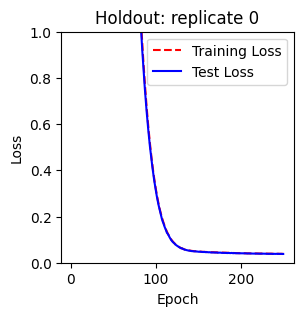

Training with replicate 1 heldout. # samples = 11258
HI
Epoch 1/250
71/71 [==============================] - 1s 6ms/step - loss: 32.7474 - mse: 2.2524 - mae: 1.1847 - val_loss: 30.6617 - val_mse: 0.4946 - val_mae: 0.5800
Epoch 2/250
71/71 [==============================] - 0s 4ms/step - loss: 31.9731 - mse: 2.1157 - mae: 1.1479 - val_loss: 30.1942 - val_mse: 0.6603 - val_mae: 0.6570
Epoch 3/250
71/71 [==============================] - 0s 4ms/step - loss: 31.2097 - mse: 1.9820 - mae: 1.1096 - val_loss: 29.6662 - val_mse: 0.7583 - val_mae: 0.7003
Epoch 4/250
71/71 [==============================] - 0s 4ms/step - loss: 30.4353 - mse: 1.8303 - mae: 1.0645 - val_loss: 29.1101 - val_mse: 0.8211 - val_mae: 0.7242
Epoch 5/250
71/71 [==============================] - 0s 4ms/step - loss: 29.6547 - mse: 1.6656 - mae: 1.0132 - val_loss: 28.5443 - val_mse: 0.8685 - val_mae: 0.7369
Epoch 6/250
71/71 [==============================] - 0s 4ms/step - loss: 28.8789 - mse: 1.5014 - mae: 0.9605 - val_loss

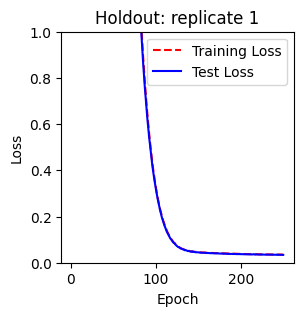

Training with replicate 2 heldout. # samples = 11258
HI
Epoch 1/250
71/71 [==============================] - 1s 6ms/step - loss: 32.6905 - mse: 2.2302 - mae: 1.1616 - val_loss: 30.5725 - val_mse: 0.4358 - val_mae: 0.5402
Epoch 2/250
71/71 [==============================] - 0s 4ms/step - loss: 31.8969 - mse: 2.0654 - mae: 1.1172 - val_loss: 30.0672 - val_mse: 0.5548 - val_mae: 0.6016
Epoch 3/250
71/71 [==============================] - 0s 4ms/step - loss: 31.1237 - mse: 1.9140 - mae: 1.0755 - val_loss: 29.5105 - val_mse: 0.6173 - val_mae: 0.6328
Epoch 4/250
71/71 [==============================] - 0s 4ms/step - loss: 30.3526 - mse: 1.7602 - mae: 1.0294 - val_loss: 28.9328 - val_mse: 0.6551 - val_mae: 0.6511
Epoch 5/250
71/71 [==============================] - 0s 4ms/step - loss: 29.5845 - mse: 1.6061 - mae: 0.9830 - val_loss: 28.3481 - val_mse: 0.6829 - val_mae: 0.6628
Epoch 6/250
71/71 [==============================] - 0s 4ms/step - loss: 28.8211 - mse: 1.4541 - mae: 0.9338 - val_loss

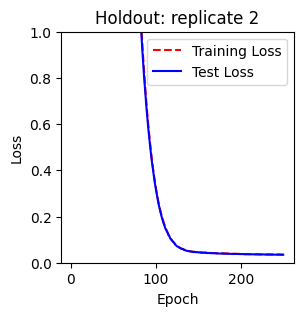

0

In [132]:
imputer.cross_validation_training_kidney(lactate_good_metabs, FML = True, tracer = 'lactate', checkpoints_dir_label = "kidney-lactate", EPOCHS = 250)

In [133]:
lactate_val_ground, lactate_val_predicted = imputer.cross_validation_testing_kidney(lactate_good_metabs, FML = True, tracer = 'lactate', checkpoints_dir_label = "kidney-lactate")

Inconsistencies found: 0 metabolites, 21 isotopolouges
Removing 3310 isotopolouges
File 0: /kidney-m0-no-log/lactate-ND-M1-FML-ioncounts-ranks.csv || 0 to drop || 0 dropped
File 1: /kidney-m0-no-log/lactate-ND-M2-FML-ioncounts-ranks.csv || 0 to drop || 0 dropped
File 2: /kidney-m0-no-log/lactate-ND-M3-FML-ioncounts-ranks.csv || 0 to drop || 0 dropped
Ion-Data is all consistent! Time to train a model!
File 0: /kidney-m0-no-log/lactate-ND-M1-FML-isotopolouges-ranks.csv || 3310 to drop || 3310 dropped
File 1: /kidney-m0-no-log/lactate-ND-M2-FML-isotopolouges-ranks.csv || 3289 to drop || 3289 dropped
File 2: /kidney-m0-no-log/lactate-ND-M3-FML-isotopolouges-ranks.csv || 3308 to drop || 3308 dropped
Iso-Data is all consistent! Time to train a model!
Testing with replicate 0 heldout. # samples = 11258
352/352 [==============================] - 0s 721us/step
Testing with replicate 1 heldout. # samples = 11393
357/357 [==============================] - 0s 668us/step
Testing with replicate 2 he

(34146, 134) (34146, 134)


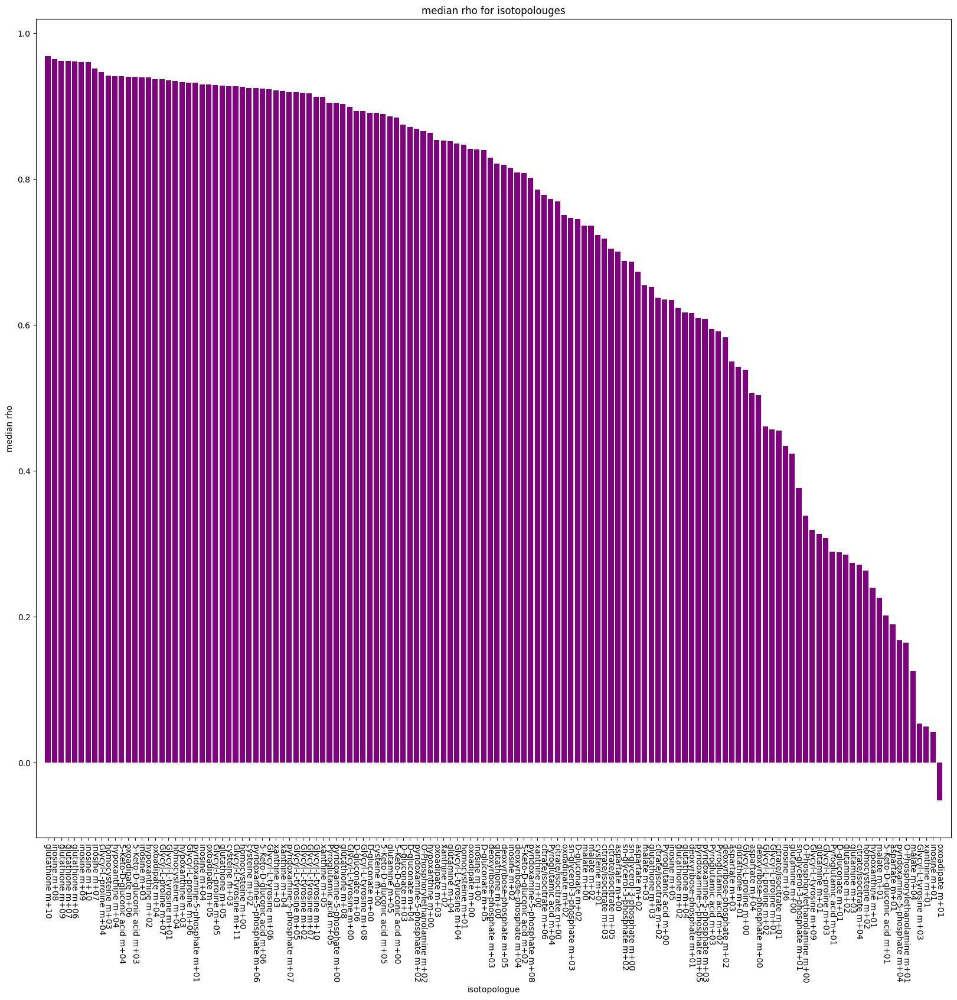

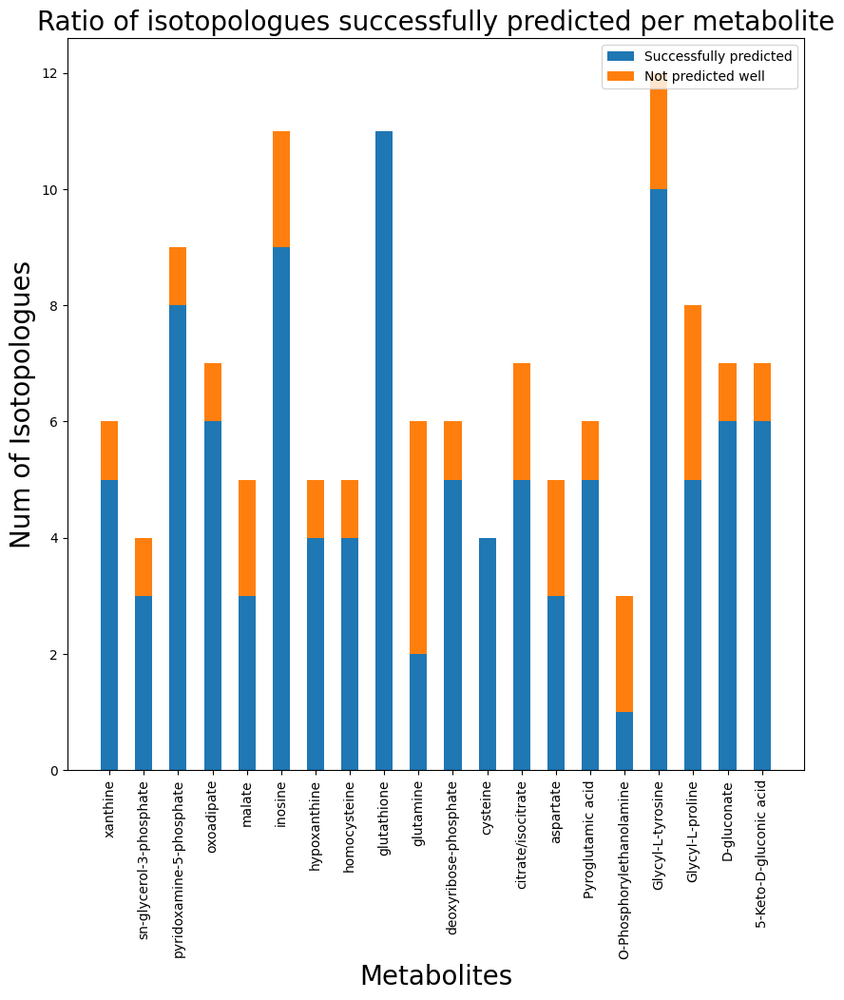

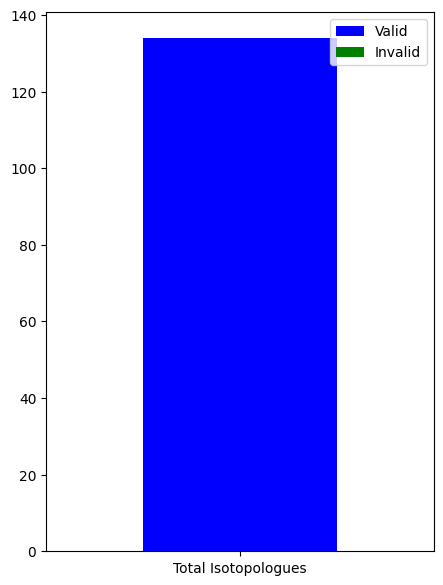

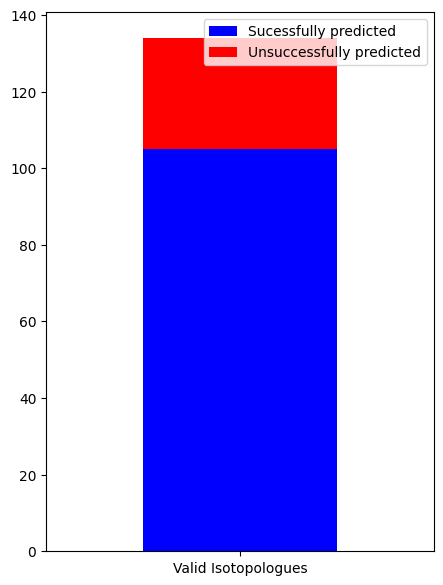

In [134]:
spearmans_lactate = imputer.cross_validation_eval_metrics(lactate_val_ground, lactate_val_predicted, num_bars=20)

In [135]:
print(spearmans_lactate[0:20])

133               glutathione m+10
120                   inosine m+08
132               glutathione m+09
130               glutathione m+07
129               glutathione m+06
121                   inosine m+09
122                   inosine m+10
119                   inosine m+07
60           Glycyl-L-proline m+04
23               homocysteine m+03
29               hypoxanthine m+04
75     5-Keto-D-gluconic acid m+04
51                 oxoadipate m+06
74     5-Keto-D-gluconic acid m+03
115                   inosine m+03
27               hypoxanthine m+02
49                 oxoadipate m+04
63           Glycyl-L-proline m+07
92          Glycyl-L-tyrosine m+01
24               homocysteine m+04
Name: isotopologue, dtype: object


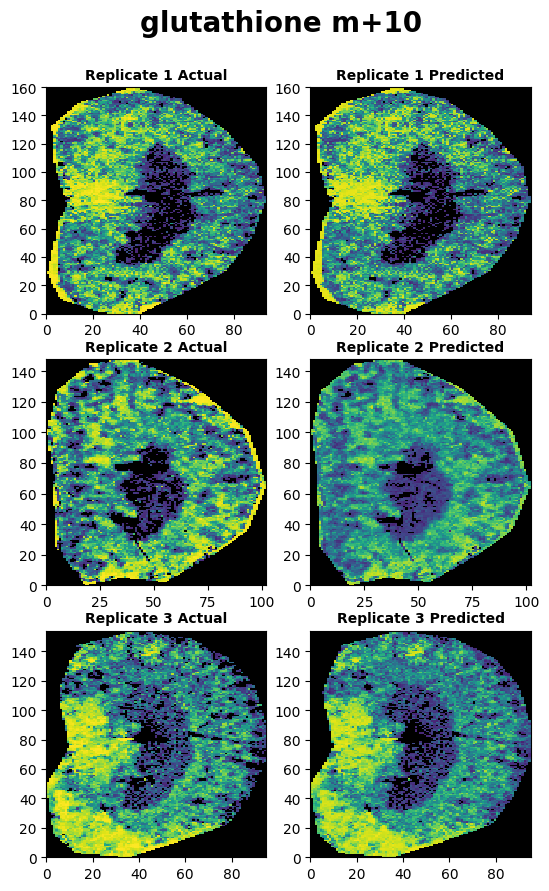

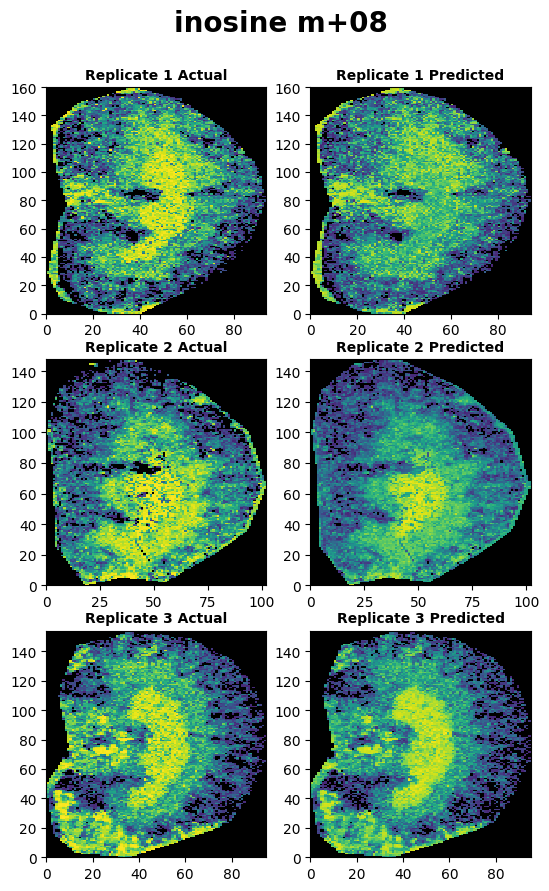

In [136]:
vis.cross_validation_results(lactate_val_ground, lactate_val_predicted, coords_df = coords_df_lactate, iso_to_plot = 'glutathione m+10', limited = True)
vis.cross_validation_results(lactate_val_ground, lactate_val_predicted, coords_df = coords_df_lactate, iso_to_plot = 'inosine m+08', limited = True)

# Glycerol

In [ ]:
M1_metab_names = ['Glyoxylic acid', 'Glycolamide', 'glycine', 'Trimethylamine N-oxide', 'Glycocholic acid', 'Glycolic acid', 'Cysteamine', 'pyruvate', 'alanine', 'lactate', '2-hydroxypyridine', 'Tiglic acid', 'acetoacetate', '2-Ketobutyric acid', 'Isovaleric acid', 'dimethylglycine', 'Malonic acid', '2-Hydroxybutyric acid', 'serine', 'Diethanolamine', 'glycerate', 'p-Benzoquinone', 'o-Cresol', 'Hypotaurine', 'Hydroquinone', 'cytosine', 'Histamine', '3-Furoic acid', 'uracil', 'Creatinine', 'Dihydrouracil', 'proline', 'fumarate', '2-Oxoisopentanoic acid', '4-Methylvaleric acid', 'N-Acetylglycine', 'Guanidoacetic acid', 'indole', 'betaine', 'succinate', '2-Hydroxyvaleric acid', 'Aminomalonic acid', 'homoserine', 'purine', 'cysteine', 'Benzoic acid', 'nicotinamide', 'nicotinate', 'Guaiacol', 'taurine', '5-Methylcytosine', 'thymine', '5-6-Dihydro Thymine', 'Pyroglutamic acid', 'DL-Pipecolic acid', 'Glutaconic acid', 'Methyloxovaleric acid (Ketoleucine)', 'N-Acetylputrescine', 'hydroxyproline', 'creatine', '3-Methylindole', 'leucine', 'Glutaric acid', 'asparagine', '2-Hydroxycaproic acid', 'ornithine', 'aspartate', 'malate', '2-Deoxy-D-ribose', 'homocysteine', 'adenine', 'L-Threonic acid', 'hypoxanthine', "N'-Methylnicotinamide", 'anthranilate', 'Phenylethanolamine', '3-Hydroxybenzoic acid', 'Urocanic acid', '6-Hydroxynicotinic acid', 'acetylphosphate', '1-3-Dimethyluracil', 'O-Phosphorylethanolamine', '5-Hydroxymethyluracil', '3-Methylglutaconic Acid', 'trans-4-Hydroxycyclohexanecarboxylic Acid', 'N-(5-Aminopentyl)acetamide', 'N-Butyrylglycine', '4-Guanidinobutanoic acid', 'Acetylcholine', 'a-ketoglutarate', 'Adipic acid', 'glutamine', 'lysine', 'glutamate', '2-hydroxyglutarate', 'methionine', 'Triethanolamine', 'Tartaric acid', 'Phenylglyoxylic acid', 'Ribose', '2-Phenylpropionic acid', 'guanine', 'N-Methyltyramine', 'xanthine', 'Mandelic acid', 'Adonitol', '3-Hydroxyanthranilic acid', 'Dopamine', 'Gentisic acid', 'histidine', '2-5-Furandicarboxylic acid', 'orotate', 'N-Tiglylglycine', 'L-Hydroorotic acid', 'allantoin', '4-6-Dioxoheptanoic acid', 'Indole-3-acetaldehyde', '2-Methylbutyrylglycine', 'Pargyline', 'DL-2-Aminooctanoic acid', 'oxoadipate', 'Pimelic acid', 'Tryptamine', '2-Hydroxyoctanoic acid', 'Indole-2-carboxylic acid', 'Aminoadipic acid', 'Indole-3-ethanol', 'carnitine', '2-Hydroxyhexanedioic Acid', 'DL-5-Hydroxylysine', '6-Dimethylaminopurine', 'phenylpyruvate', 'L-Fucose', '2-Phenylbutyric acid', 'Methionine sulfoxide', 'phenylalanine', 'L-(?)-3-Phenyllactic acid', 'D-Phenyllactic acid', 'quinolinate', 'Pyridoxal', 'Synephrine', '3-Methoxytyramine', 'PEP', 'Uric acid', 'Homogentisic acid', 'Pyridoxamine', 'L-Cysteic acid', '2-Amino-3-phosphonopropionic acid', '2-Furoylglycine', 'pyridoxine', '1-Methyl-Histidine', 'D-glyceraldehdye-3-phosphate', 'Diethylthiophosphate', 'sn-glycerol-3-phosphate', 'Menadione', 'Glycyl-L-proline', 'Quinaldic acid', 'Hexanoyl Glycine', 'aconitate', 'Shikimic acid', 'Suberic acid', 'arginine', 'N-Acetylaspartic acid', 'Indole-3-acetic acid', 'citrulline', 'Tricarballylic acid', 'N-carbamoyl-L-aspartate', '2-Isopropylmalic acid', 'Serotonin', 'N-Formyl-L-methionine', 'L-Gulonic acid-lactone', 'Gluconolactone', '5-Phenylvaleric acid', 'Isoxanthopterin', 'hydroxyphenylpyruvate', 'Nicotinuric acid', 'Glucose', '3-(3-Methoxyphenyl)propionic acid', 'tyrosine', 'Hydroxyphenyllactic acid', '4-Pyridoxic acid', 'Phosphorylcholine', 'DL -3-4-Dihydroxymandelic acid', 'Phosphoserine', 'Undecanoic acid', 'trans-3-Indoleacrylic acid', 'Glycyl-L-leucine', 'Homoarginine', 'N6-N6-N6-Trimethyllysine', 'Kynurenic acid', 'N-acetyl-glutamate', '3-Indolepropionic acid', 'Homocitrulline', 'Diaminopimelic Acid', '5-Methoxytryptamine', 'Hydroxyindoleacetic acid', 'N-Acetyl-L-methionine', 'citrate/isocitrate', 'Quinic acid', 'Phenylacetylglycine', '5-Keto-D-gluconic acid', '4-Aminohippuric acid', '2-Hydroxy Hippuric Acid', 'D-gluconate', '3-4-Dimethoxyphenylacetic acid', 'L-Dopa', 'DL-4-Hydroxy-3-methoxymandelic acid', 'O-phosphohomoserine', 'D-erythrose-4-phosphate', 'Cysteine S-sulfate', 'Capryloyl glycine', 'Sebacic acid', 'Indole-3-pyruvic acid', '3-Indolebutyric acid', 'N-Acetylcarnitine', 'tryptophan', 'Xanthurenic acid', 'DL-Indole-3-lactic acid', '(±)-Lipoic acid', 'N-Acetyl-L-phenylalanine', 'DL-Benzylsuccinic acid', 'L-Kynurenine', 'Mucic acid', 'Creatine phosphate', '3-Indoxyl sulfate', 'deoxyribose-phosphate', 'N-Acetylserotonin', 'pantothenate', '5-L-Hydroxytryptophan', '?-N-Acetylglucosamine', 'cystathionine', 'N-Acetyltyrosine', '3-Nitro-L- tyrosine', 'Carnosine', 'deoxyuridine', 'Myristic acid', 'ribose-phosphate', 'Suberyl Glycine', 'Melatonin', '5-Methoxytryptophan', 'Sepiapterin', '3-4-5-Trimethoxycinnamic acid', 'Glycyl-L-tyrosine', 'Anserine', 'thymidine', 'cytidine', 'uridine', 'biotin', 'Pyridoxal 5-phosphate', 'pyridoxamine-5-phosphate', 'Muramic acid', 'deoxyadenosine', 'deoxyinosine', 'Ribothymidine', 'glucosamine-6-phosphate', 'glucose-1-phosphate', 'Mannitol-1-phosphate', 'adenosine', 'homocystine', 'inosine', 'L-Aspartyl-L-phenylalanine', 'Linoleic acid', '1-Methyladenosine', 'guanosine', 'xanthosine', 'Stearic acid', "5'-Methylthioadenosine", '7-methylguanosine', 'Retinoic Acid', 'elcosapentaenoic acid', 'dCMP', 'glutathione', 'dUMP', 'N-Acetylneuraminic acid', 'Arachidic acid', 'CMP', 'UMP', 'Docosahexaenoic acid(DHA)', 'cyclic-AMP', 'dAMP', 'fructose-1-6-bisphosphate', 'Sucrose', 'AMP', 'dGMP', 'IMP', 'GMP', 'riboflavin', 'Lithocholic acid', 'S-adenosyl-L-homoCysteine', 'dCDP', 'Chenodeoxycholic acid', 'S-Adenosylmethionine', 'dTDP', 'CDP', 'UDP', 'Cholic acid', 'trehalose-6-Phosphate', 'Cysteine-glutathione disulphide', "adenosine 5'-phosphosulfate", 'ADP', 'IDP', 'folate', 'GDP', 'Glycodeoxycholic acid', 'Glycoursodeoxycholic acid', 'FMN', '5-methyl-THF', 'dCTP', 'dUTP', 'Folinic acid', 'dTTP', 'CTP', 'UTP', 'CDP-choline', 'dATP', 'Taurodeoxycholic acid', 'ATP', 'Inosine 5-triphosphate', 'GTP', 'Cyclic-ADP-ribose', 'D-Pantethine', 'UDP-D-glucose', 'Bilirubin', 'ADP-D-glucose', 'glutathione disulfide', 'NAD+', 'NADH', 'dephospho-CoA', 'NADP+', 'NADPH', 'coenzyme A', 'hyaluronate', 'FAD', 'acetyl-CoA', 'propionyl-CoA', 'butyryl-CoA', 'acetoacetyl-CoA', 'malonyl-CoA', 'Butyric acid', 'N-Acetyl-cysteine', 'N-Acetyl-L-arginine', 'N-Acetyl-L-asparagine', 'N-acetyl-L-glutamine', 'N-Acetyl-L-leucine', 'N-Acetyl-L-isoleucine', 'N-acetyl-L-ornithine', 'N-Acetyl-L-phenylalanine m', 'N-Acetyl-L-proline', 'O-acetyl-L-serine', 'Ala-Ala', 'Glycerophosphocholine', '2-Furoylglycine m', 'N-Iso valerylglycine', 'x', 'y']
M1_moransi_scores = [0.6313, 0.6221, 0.6077, 0.6305, 0.6694, 0.6233, 0.6252, 0.5584, 0.5554, 0.5971, 0.6447, 0.6459, 0.5513, 0.5513, 0.6521, 0.5517, 0.592, 0.644, 0.567, 0.6483, 0.6465, 0.6508, 0.6621, 0.6929, 0.6547, 0.6496, 0.6545, 0.6745, 0.5792, 0.6453, 0.5919, 0.6452, 0.8147, 0.6398, 0.6535, 0.5892, 0.6396, 0.6594, 0.6552, 0.6414, 0.6601, 0.6516, 0.5834, 0.6532, 0.9101, 0.6605, 0.6585, 0.6609, 0.6598, 0.7293, 0.6557, 0.6302, 0.6088, 0.8323, 0.6589, 0.5615, 0.656, 0.6594, 0.5817, 0.6605, 0.6656, 0.661, 0.6582, 0.6484, 0.6533, 0.6472, 0.8578, 0.898, 0.6492, 0.7827, 0.7536, 0.7143, 0.783, 0.6595, 0.6529, 0.6629, 0.659, 0.6988, 0.6166, 0.479, 0.8228, 0.7657, 0.639, 0.6015, 0.6625, 0.6624, 0.6369, 0.659, 0.6593, 0.6275, 0.6568, 0.8782, 0.6629, 0.7572, 0.7045, 0.66, 0.6642, 0.6586, 0.6542, 0.8419, 0.6688, 0.5708, 0.6668, 0.819, 0.6355, 0.663, 0.6449, 0.6625, 0.6235, 0.8607, 0.6554, 0.6377, 0.6301, 0.6612, 0.8707, 0.6471, 0.6689, 0.6482, 0.6701, 0.6675, 0.9187, 0.6602, 0.669, 0.6686, 0.6493, 0.5869, 0.6691, 0.6651, 0.5951, 0.6568, 0.6655, 0.667, 0.663, 0.6719, 0.643, 0.6933, 0.6531, 0.665, 0.6581, 0.6325, 0.6722, 0.6718, 0.6074, 0.7548, 0.6394, 0.671, 0.52, 0.6289, 0.6292, 0.5585, 0.6684, 0.546, 0.6674, 0.8808, 0.6714, 0.8444, 0.6639, 0.6972, 0.7753, 0.6363, 0.6676, 0.6512, 0.7229, 0.6728, 0.6341, 0.8177, 0.6506, 0.6667, 0.6713, 0.6351, 0.8553, 0.8551, 0.6729, 0.7535, 0.6527, 0.6484, 0.7357, 0.6662, 0.6666, 0.6415, 0.8925, 0.651, 0.5902, 0.6095, 0.6716, 0.6645, 0.7237, 0.6669, 0.6715, 0.6467, 0.6922, 0.6712, 0.6661, 0.706, 0.6682, 0.6681, 0.6401, 0.7743, 0.653, 0.6965, 0.8692, 0.6512, 0.585, 0.902, 0.661, 0.5692, 0.6176, 0.6518, 0.6281, 0.6634, 0.6721, 0.6729, 0.6707, 0.6658, 0.6703, 0.6696, 0.6858, 0.6575, 0.7199, 0.7358, 0.6683, 0.6686, 0.6528, 0.6579, 0.6415, 0.9265, 0.6686, 0.6662, 0.6419, 0.6723, 0.658, 0.6734, 0.6435, 0.6741, 0.6669, 0.6762, 0.5748, 0.6755, 0.6724, 0.6674, 0.6664, 0.6688, 0.8154, 0.7081, 0.6658, 0.6661, 0.6382, 0.6638, 0.6674, 0.8508, 0.6788, 0.6791, 0.6716, 0.6567, 0.6115, 0.6339, 0.7012, 0.6853, 0.6984, 0.847, 0.5979, 0.6818, 0.6431, 0.6629, 0.6591, 0.6839, 0.6535, 0.6891, 0.6801, 0.6816, 0.6736, 0.91, 0.6676, 0.6622, 0.6773, 0.6787, 0.6363, 0.8227, 0.649, 0.6622, 0.632, 0.6606, 0.7205, 0.7205, 0.7319, 0.7179, 0.6815, 0.6802, 0.6815, 0.6788, 0.6789, 0.6697, 0.6729, 0.6735, 0.6916, 0.6802, 0.6789, 0.6702, 0.6783, 0.7523, 0.6773, 0.6786, 0.6755, 0.6808, 0.6808, 0.6714, 0.6363, 0.6793, 0.6758, 0.6716, 0.6788, 0.6783, 0.677, 0.6785, 0.6772, 0.6793, 0.6807, 0.6772, 0.6781, 0.679, 0.6806, 0.6803, 0.6818, 0.6797, 0.6797, 0.6793, 0.681, 0.6807, 0.6798, 0.6803, 0.6806, 0.6807, 0.6814, 0.6797, 0.6807, 0.6815, 0.6823, 0.6811, 0.6266, 0.6156, 0.6716, 0.638, 0.6559, 0.6972, 0.6972, 0.6709, 0.7358, 0.6294, 0.7572, 0.7145, 0.672, 0.6299, 0.6466]
M2_metab_names = ['Glyoxylic acid', 'Glycolamide', 'glycine', 'Trimethylamine N-oxide', 'Glycocholic acid', 'Glycolic acid', 'Cysteamine', 'pyruvate', 'alanine', 'lactate', '2-hydroxypyridine', 'Tiglic acid', 'acetoacetate', '2-Ketobutyric acid', 'Isovaleric acid', 'dimethylglycine', 'Malonic acid', '2-Hydroxybutyric acid', 'serine', 'Diethanolamine', 'glycerate', 'p-Benzoquinone', 'o-Cresol', 'Hypotaurine', 'Hydroquinone', 'cytosine', 'Histamine', '3-Furoic acid', 'uracil', 'Creatinine', 'Dihydrouracil', 'proline', 'fumarate', '2-Oxoisopentanoic acid', '4-Methylvaleric acid', 'N-Acetylglycine', 'Guanidoacetic acid', 'indole', 'betaine', 'succinate', '2-Hydroxyvaleric acid', 'Aminomalonic acid', 'homoserine', 'purine', 'cysteine', 'Benzoic acid', 'nicotinamide', 'nicotinate', 'Guaiacol', 'taurine', '5-Methylcytosine', 'thymine', '5-6-Dihydro Thymine', 'Pyroglutamic acid', 'DL-Pipecolic acid', 'Glutaconic acid', 'Methyloxovaleric acid (Ketoleucine)', 'N-Acetylputrescine', 'hydroxyproline', 'creatine', '3-Methylindole', 'leucine', 'Glutaric acid', 'asparagine', '2-Hydroxycaproic acid', 'ornithine', 'aspartate', 'malate', '2-Deoxy-D-ribose', 'homocysteine', 'adenine', 'L-Threonic acid', 'hypoxanthine', "N'-Methylnicotinamide", 'anthranilate', 'Phenylethanolamine', '3-Hydroxybenzoic acid', 'Urocanic acid', '6-Hydroxynicotinic acid', 'acetylphosphate', '1-3-Dimethyluracil', 'O-Phosphorylethanolamine', '5-Hydroxymethyluracil', '3-Methylglutaconic Acid', 'trans-4-Hydroxycyclohexanecarboxylic Acid', 'N-(5-Aminopentyl)acetamide', 'N-Butyrylglycine', '4-Guanidinobutanoic acid', 'Acetylcholine', 'a-ketoglutarate', 'Adipic acid', 'glutamine', 'lysine', 'glutamate', '2-hydroxyglutarate', 'methionine', 'Triethanolamine', 'Tartaric acid', 'Phenylglyoxylic acid', 'Ribose', '2-Phenylpropionic acid', 'guanine', 'N-Methyltyramine', 'xanthine', 'Mandelic acid', 'Adonitol', '3-Hydroxyanthranilic acid', 'Dopamine', 'Gentisic acid', 'histidine', '2-5-Furandicarboxylic acid', 'orotate', 'N-Tiglylglycine', 'L-Hydroorotic acid', 'allantoin', '4-6-Dioxoheptanoic acid', 'Indole-3-acetaldehyde', '2-Methylbutyrylglycine', 'Pargyline', 'DL-2-Aminooctanoic acid', 'oxoadipate', 'Pimelic acid', 'Tryptamine', '2-Hydroxyoctanoic acid', 'Indole-2-carboxylic acid', 'Aminoadipic acid', 'Indole-3-ethanol', 'carnitine', '2-Hydroxyhexanedioic Acid', 'DL-5-Hydroxylysine', '6-Dimethylaminopurine', 'phenylpyruvate', 'L-Fucose', '2-Phenylbutyric acid', 'Methionine sulfoxide', 'phenylalanine', 'L-(?)-3-Phenyllactic acid', 'D-Phenyllactic acid', 'quinolinate', 'Pyridoxal', 'Synephrine', '3-Methoxytyramine', 'PEP', 'Uric acid', 'Homogentisic acid', 'Pyridoxamine', 'L-Cysteic acid', '2-Amino-3-phosphonopropionic acid', '2-Furoylglycine', 'pyridoxine', '1-Methyl-Histidine', 'D-glyceraldehdye-3-phosphate', 'Diethylthiophosphate', 'sn-glycerol-3-phosphate', 'Menadione', 'Glycyl-L-proline', 'Quinaldic acid', 'Hexanoyl Glycine', 'aconitate', 'Shikimic acid', 'Suberic acid', 'arginine', 'N-Acetylaspartic acid', 'Indole-3-acetic acid', 'citrulline', 'Tricarballylic acid', 'N-carbamoyl-L-aspartate', '2-Isopropylmalic acid', 'Serotonin', 'N-Formyl-L-methionine', 'L-Gulonic acid-lactone', 'Gluconolactone', '5-Phenylvaleric acid', 'Isoxanthopterin', 'hydroxyphenylpyruvate', 'Nicotinuric acid', 'Glucose', '3-(3-Methoxyphenyl)propionic acid', 'tyrosine', 'Hydroxyphenyllactic acid', '4-Pyridoxic acid', 'Phosphorylcholine', 'DL -3-4-Dihydroxymandelic acid', 'Phosphoserine', 'Undecanoic acid', 'trans-3-Indoleacrylic acid', 'Glycyl-L-leucine', 'Homoarginine', 'N6-N6-N6-Trimethyllysine', 'Kynurenic acid', 'N-acetyl-glutamate', '3-Indolepropionic acid', 'Homocitrulline', 'Diaminopimelic Acid', '5-Methoxytryptamine', 'Hydroxyindoleacetic acid', 'N-Acetyl-L-methionine', 'citrate/isocitrate', 'Quinic acid', 'Phenylacetylglycine', '5-Keto-D-gluconic acid', '4-Aminohippuric acid', '2-Hydroxy Hippuric Acid', 'D-gluconate', '3-4-Dimethoxyphenylacetic acid', 'L-Dopa', 'DL-4-Hydroxy-3-methoxymandelic acid', 'O-phosphohomoserine', 'D-erythrose-4-phosphate', 'Cysteine S-sulfate', 'Capryloyl glycine', 'Sebacic acid', 'Indole-3-pyruvic acid', '3-Indolebutyric acid', 'N-Acetylcarnitine', 'tryptophan', 'Xanthurenic acid', 'DL-Indole-3-lactic acid', '(±)-Lipoic acid', 'N-Acetyl-L-phenylalanine', 'DL-Benzylsuccinic acid', 'L-Kynurenine', 'Mucic acid', 'Creatine phosphate', '3-Indoxyl sulfate', 'deoxyribose-phosphate', 'N-Acetylserotonin', 'pantothenate', '5-L-Hydroxytryptophan', '?-N-Acetylglucosamine', 'cystathionine', 'N-Acetyltyrosine', '3-Nitro-L- tyrosine', 'Carnosine', 'deoxyuridine', 'Myristic acid', 'ribose-phosphate', 'Suberyl Glycine', 'Melatonin', '5-Methoxytryptophan', 'Sepiapterin', '3-4-5-Trimethoxycinnamic acid', 'Glycyl-L-tyrosine', 'Anserine', 'thymidine', 'cytidine', 'uridine', 'biotin', 'Pyridoxal 5-phosphate', 'pyridoxamine-5-phosphate', 'Muramic acid', 'deoxyadenosine', 'deoxyinosine', 'Ribothymidine', 'glucosamine-6-phosphate', 'glucose-1-phosphate', 'Mannitol-1-phosphate', 'adenosine', 'homocystine', 'inosine', 'L-Aspartyl-L-phenylalanine', 'Linoleic acid', '1-Methyladenosine', 'guanosine', 'xanthosine', 'Stearic acid', "5'-Methylthioadenosine", '7-methylguanosine', 'Retinoic Acid', 'elcosapentaenoic acid', 'dCMP', 'glutathione', 'dUMP', 'N-Acetylneuraminic acid', 'Arachidic acid', 'CMP', 'UMP', 'Docosahexaenoic acid(DHA)', 'cyclic-AMP', 'dAMP', 'fructose-1-6-bisphosphate', 'Sucrose', 'AMP', 'dGMP', 'IMP', 'GMP', 'riboflavin', 'Lithocholic acid', 'S-adenosyl-L-homoCysteine', 'dCDP', 'Chenodeoxycholic acid', 'S-Adenosylmethionine', 'dTDP', 'CDP', 'UDP', 'Cholic acid', 'trehalose-6-Phosphate', 'Cysteine-glutathione disulphide', "adenosine 5'-phosphosulfate", 'ADP', 'IDP', 'folate', 'GDP', 'Glycodeoxycholic acid', 'Glycoursodeoxycholic acid', 'FMN', '5-methyl-THF', 'dCTP', 'dUTP', 'Folinic acid', 'dTTP', 'CTP', 'UTP', 'CDP-choline', 'dATP', 'Taurodeoxycholic acid', 'ATP', 'Inosine 5-triphosphate', 'GTP', 'Cyclic-ADP-ribose', 'D-Pantethine', 'UDP-D-glucose', 'Bilirubin', 'ADP-D-glucose', 'glutathione disulfide', 'NAD+', 'NADH', 'dephospho-CoA', 'NADP+', 'NADPH', 'coenzyme A', 'hyaluronate', 'FAD', 'acetyl-CoA', 'propionyl-CoA', 'butyryl-CoA', 'acetoacetyl-CoA', 'malonyl-CoA', 'Butyric acid', 'N-Acetyl-cysteine', 'N-Acetyl-L-arginine', 'N-Acetyl-L-asparagine', 'N-acetyl-L-glutamine', 'N-Acetyl-L-leucine', 'N-Acetyl-L-isoleucine', 'N-acetyl-L-ornithine', 'N-Acetyl-L-phenylalanine m', 'N-Acetyl-L-proline', 'O-acetyl-L-serine', 'Ala-Ala', 'Glycerophosphocholine', '2-Furoylglycine m', 'N-Iso valerylglycine', 'x', 'y']
M2_moransi_scores = [0.7326, 0.7071, 0.6758, 0.7362, 0.8021, 0.7105, 0.7311, 0.7179, 0.602, 0.7111, 0.761, 0.7419, 0.6053, 0.6054, 0.7681, 0.6201, 0.624, 0.7611, 0.6015, 0.7643, 0.7501, 0.7809, 0.7667, 0.7373, 0.7666, 0.7687, 0.777, 0.7934, 0.6291, 0.7657, 0.6369, 0.6929, 0.8124, 0.6802, 0.7734, 0.6735, 0.7063, 0.7833, 0.7698, 0.7799, 0.7649, 0.7636, 0.6555, 0.6487, 0.939, 0.7802, 0.7937, 0.7632, 0.7896, 0.9334, 0.7776, 0.6685, 0.6989, 0.9265, 0.7578, 0.6462, 0.7709, 0.7852, 0.673, 0.729, 0.801, 0.7833, 0.6883, 0.7211, 0.817, 0.7285, 0.9449, 0.9313, 0.7773, 0.8953, 0.8135, 0.8051, 0.8934, 0.7891, 0.749, 0.8005, 0.7389, 0.7917, 0.4877, 0.6262, 0.8661, 0.943, 0.684, 0.6443, 0.7684, 0.7936, 0.7435, 0.7889, 0.7936, 0.6281, 0.6954, 0.9321, 0.7202, 0.8782, 0.8036, 0.7645, 0.7986, 0.6099, 0.7552, 0.9017, 0.7957, 0.8595, 0.7928, 0.9115, 0.7204, 0.7385, 0.7168, 0.7537, 0.6611, 0.9062, 0.7252, 0.8117, 0.6781, 0.6352, 0.9384, 0.7469, 0.7927, 0.7638, 0.7865, 0.8, 0.905, 0.6974, 0.808, 0.8009, 0.7854, 0.7102, 0.8037, 0.8023, 0.6713, 0.7558, 0.8068, 0.686, 0.7336, 0.7945, 0.6651, 0.8781, 0.5033, 0.636, 0.7451, 0.6247, 0.8034, 0.8032, 0.8139, 0.914, 0.6139, 0.7622, 0.6287, 0.7233, 0.6845, 0.5981, 0.7538, 0.7518, 0.752, 0.9534, 0.7946, 0.9589, 0.7046, 0.8845, 0.8044, 0.6074, 0.7696, 0.6987, 0.8677, 0.7955, 0.827, 0.928, 0.6746, 0.7079, 0.794, 0.7691, 0.8232, 0.828, 0.8043, 0.8644, 0.6976, 0.6711, 0.8104, 0.6981, 0.7187, 0.6397, 0.5715, 0.803, 0.5615, 0.7919, 0.8068, 0.7505, 0.8152, 0.8003, 0.8049, 0.7408, 0.7841, 0.7665, 0.7509, 0.8524, 0.806, 0.7111, 0.739, 0.9008, 0.7108, 0.7267, 0.9282, 0.6974, 0.6468, 0.9586, 0.7731, 0.5759, 0.7299, 0.5747, 0.7177, 0.7937, 0.8065, 0.8027, 0.7123, 0.778, 0.7948, 0.7484, 0.8715, 0.6813, 0.848, 0.7904, 0.717, 0.6597, 0.8102, 0.7675, 0.8387, 0.9572, 0.7728, 0.7294, 0.7358, 0.7738, 0.6867, 0.7272, 0.6913, 0.7536, 0.6401, 0.7936, 0.7738, 0.7435, 0.8062, 0.6764, 0.7143, 0.7818, 0.829, 0.772, 0.6419, 0.7803, 0.7314, 0.7432, 0.6795, 0.9487, 0.7627, 0.718, 0.599, 0.6631, 0.7424, 0.7996, 0.8418, 0.6628, 0.7134, 0.7709, 0.6764, 0.7705, 0.6791, 0.6533, 0.6999, 0.7424, 0.7131, 0.7296, 0.8197, 0.7981, 0.7453, 0.9164, 0.6471, 0.8349, 0.8165, 0.736, 0.6587, 0.8865, 0.7564, 0.6374, 0.7263, 0.6947, 0.7366, 0.7366, 0.8801, 0.8108, 0.7829, 0.8231, 0.7529, 0.8032, 0.8226, 0.7713, 0.6904, 0.8122, 0.8458, 0.8226, 0.8176, 0.7927, 0.8204, 0.8746, 0.8201, 0.7346, 0.8011, 0.8227, 0.8227, 0.7794, 0.7427, 0.8205, 0.8211, 0.7005, 0.8155, 0.8152, 0.8138, 0.8131, 0.8217, 0.8222, 0.8567, 0.8222, 0.8203, 0.8196, 0.821, 0.8198, 0.8221, 0.82, 0.8208, 0.8208, 0.8201, 0.8207, 0.8212, 0.8209, 0.8206, 0.8219, 0.8218, 0.822, 0.8222, 0.8221, 0.8225, 0.8229, 0.7068, 0.8722, 0.8054, 0.6568, 0.6999, 0.8845, 0.8845, 0.7372, 0.7904, 0.6826, 0.8782, 0.8395, 0.6763, 0.6846, 0.7477]
M3_metab_names = ['Glyoxylic acid', 'Glycolamide', 'glycine', 'Trimethylamine N-oxide', 'Glycocholic acid', 'Glycolic acid', 'Cysteamine', 'pyruvate', 'alanine', 'lactate', '2-hydroxypyridine', 'Tiglic acid', 'acetoacetate', '2-Ketobutyric acid', 'Isovaleric acid', 'dimethylglycine', 'Malonic acid', '2-Hydroxybutyric acid', 'serine', 'Diethanolamine', 'glycerate', 'p-Benzoquinone', 'o-Cresol', 'Hypotaurine', 'Hydroquinone', 'cytosine', 'Histamine', '3-Furoic acid', 'uracil', 'Creatinine', 'Dihydrouracil', 'proline', 'fumarate', '2-Oxoisopentanoic acid', '4-Methylvaleric acid', 'N-Acetylglycine', 'Guanidoacetic acid', 'indole', 'betaine', 'succinate', '2-Hydroxyvaleric acid', 'Aminomalonic acid', 'homoserine', 'purine', 'cysteine', 'Benzoic acid', 'nicotinamide', 'nicotinate', 'Guaiacol', 'taurine', '5-Methylcytosine', 'thymine', '5-6-Dihydro Thymine', 'Pyroglutamic acid', 'DL-Pipecolic acid', 'Glutaconic acid', 'Methyloxovaleric acid (Ketoleucine)', 'N-Acetylputrescine', 'hydroxyproline', 'creatine', '3-Methylindole', 'leucine', 'Glutaric acid', 'asparagine', '2-Hydroxycaproic acid', 'ornithine', 'aspartate', 'malate', '2-Deoxy-D-ribose', 'homocysteine', 'adenine', 'L-Threonic acid', 'hypoxanthine', "N'-Methylnicotinamide", 'anthranilate', 'Phenylethanolamine', '3-Hydroxybenzoic acid', 'Urocanic acid', '6-Hydroxynicotinic acid', 'acetylphosphate', '1-3-Dimethyluracil', 'O-Phosphorylethanolamine', '5-Hydroxymethyluracil', '3-Methylglutaconic Acid', 'trans-4-Hydroxycyclohexanecarboxylic Acid', 'N-(5-Aminopentyl)acetamide', 'N-Butyrylglycine', '4-Guanidinobutanoic acid', 'Acetylcholine', 'a-ketoglutarate', 'Adipic acid', 'glutamine', 'lysine', 'glutamate', '2-hydroxyglutarate', 'methionine', 'Triethanolamine', 'Tartaric acid', 'Phenylglyoxylic acid', 'Ribose', '2-Phenylpropionic acid', 'guanine', 'N-Methyltyramine', 'xanthine', 'Mandelic acid', 'Adonitol', '3-Hydroxyanthranilic acid', 'Dopamine', 'Gentisic acid', 'histidine', '2-5-Furandicarboxylic acid', 'orotate', 'N-Tiglylglycine', 'L-Hydroorotic acid', 'allantoin', '4-6-Dioxoheptanoic acid', 'Indole-3-acetaldehyde', '2-Methylbutyrylglycine', 'Pargyline', 'DL-2-Aminooctanoic acid', 'oxoadipate', 'Pimelic acid', 'Tryptamine', '2-Hydroxyoctanoic acid', 'Indole-2-carboxylic acid', 'Aminoadipic acid', 'Indole-3-ethanol', 'carnitine', '2-Hydroxyhexanedioic Acid', 'DL-5-Hydroxylysine', '6-Dimethylaminopurine', 'phenylpyruvate', 'L-Fucose', '2-Phenylbutyric acid', 'Methionine sulfoxide', 'phenylalanine', 'L-(?)-3-Phenyllactic acid', 'D-Phenyllactic acid', 'quinolinate', 'Pyridoxal', 'Synephrine', '3-Methoxytyramine', 'PEP', 'Uric acid', 'Homogentisic acid', 'Pyridoxamine', 'L-Cysteic acid', '2-Amino-3-phosphonopropionic acid', '2-Furoylglycine', 'pyridoxine', '1-Methyl-Histidine', 'D-glyceraldehdye-3-phosphate', 'Diethylthiophosphate', 'sn-glycerol-3-phosphate', 'Menadione', 'Glycyl-L-proline', 'Quinaldic acid', 'Hexanoyl Glycine', 'aconitate', 'Shikimic acid', 'Suberic acid', 'arginine', 'N-Acetylaspartic acid', 'Indole-3-acetic acid', 'citrulline', 'Tricarballylic acid', 'N-carbamoyl-L-aspartate', '2-Isopropylmalic acid', 'Serotonin', 'N-Formyl-L-methionine', 'L-Gulonic acid-lactone', 'Gluconolactone', '5-Phenylvaleric acid', 'Isoxanthopterin', 'hydroxyphenylpyruvate', 'Nicotinuric acid', 'Glucose', '3-(3-Methoxyphenyl)propionic acid', 'tyrosine', 'Hydroxyphenyllactic acid', '4-Pyridoxic acid', 'Phosphorylcholine', 'DL -3-4-Dihydroxymandelic acid', 'Phosphoserine', 'Undecanoic acid', 'trans-3-Indoleacrylic acid', 'Glycyl-L-leucine', 'Homoarginine', 'N6-N6-N6-Trimethyllysine', 'Kynurenic acid', 'N-acetyl-glutamate', '3-Indolepropionic acid', 'Homocitrulline', 'Diaminopimelic Acid', '5-Methoxytryptamine', 'Hydroxyindoleacetic acid', 'N-Acetyl-L-methionine', 'citrate/isocitrate', 'Quinic acid', 'Phenylacetylglycine', '5-Keto-D-gluconic acid', '4-Aminohippuric acid', '2-Hydroxy Hippuric Acid', 'D-gluconate', '3-4-Dimethoxyphenylacetic acid', 'L-Dopa', 'DL-4-Hydroxy-3-methoxymandelic acid', 'O-phosphohomoserine', 'D-erythrose-4-phosphate', 'Cysteine S-sulfate', 'Capryloyl glycine', 'Sebacic acid', 'Indole-3-pyruvic acid', '3-Indolebutyric acid', 'N-Acetylcarnitine', 'tryptophan', 'Xanthurenic acid', 'DL-Indole-3-lactic acid', '(±)-Lipoic acid', 'N-Acetyl-L-phenylalanine', 'DL-Benzylsuccinic acid', 'L-Kynurenine', 'Mucic acid', 'Creatine phosphate', '3-Indoxyl sulfate', 'deoxyribose-phosphate', 'N-Acetylserotonin', 'pantothenate', '5-L-Hydroxytryptophan', '?-N-Acetylglucosamine', 'cystathionine', 'N-Acetyltyrosine', '3-Nitro-L- tyrosine', 'Carnosine', 'deoxyuridine', 'Myristic acid', 'ribose-phosphate', 'Suberyl Glycine', 'Melatonin', '5-Methoxytryptophan', 'Sepiapterin', '3-4-5-Trimethoxycinnamic acid', 'Glycyl-L-tyrosine', 'Anserine', 'thymidine', 'cytidine', 'uridine', 'biotin', 'Pyridoxal 5-phosphate', 'pyridoxamine-5-phosphate', 'Muramic acid', 'deoxyadenosine', 'deoxyinosine', 'Ribothymidine', 'glucosamine-6-phosphate', 'glucose-1-phosphate', 'Mannitol-1-phosphate', 'adenosine', 'homocystine', 'inosine', 'L-Aspartyl-L-phenylalanine', 'Linoleic acid', '1-Methyladenosine', 'guanosine', 'xanthosine', 'Stearic acid', "5'-Methylthioadenosine", '7-methylguanosine', 'Retinoic Acid', 'elcosapentaenoic acid', 'dCMP', 'glutathione', 'dUMP', 'N-Acetylneuraminic acid', 'Arachidic acid', 'CMP', 'UMP', 'Docosahexaenoic acid(DHA)', 'cyclic-AMP', 'dAMP', 'fructose-1-6-bisphosphate', 'Sucrose', 'AMP', 'dGMP', 'IMP', 'GMP', 'riboflavin', 'Lithocholic acid', 'S-adenosyl-L-homoCysteine', 'dCDP', 'Chenodeoxycholic acid', 'S-Adenosylmethionine', 'dTDP', 'CDP', 'UDP', 'Cholic acid', 'trehalose-6-Phosphate', 'Cysteine-glutathione disulphide', "adenosine 5'-phosphosulfate", 'ADP', 'IDP', 'folate', 'GDP', 'Glycodeoxycholic acid', 'Glycoursodeoxycholic acid', 'FMN', '5-methyl-THF', 'dCTP', 'dUTP', 'Folinic acid', 'dTTP', 'CTP', 'UTP', 'CDP-choline', 'dATP', 'Taurodeoxycholic acid', 'ATP', 'Inosine 5-triphosphate', 'GTP', 'Cyclic-ADP-ribose', 'D-Pantethine', 'UDP-D-glucose', 'Bilirubin', 'ADP-D-glucose', 'glutathione disulfide', 'NAD+', 'NADH', 'dephospho-CoA', 'NADP+', 'NADPH', 'coenzyme A', 'hyaluronate', 'FAD', 'acetyl-CoA', 'propionyl-CoA', 'butyryl-CoA', 'acetoacetyl-CoA', 'malonyl-CoA', 'Butyric acid', 'N-Acetyl-cysteine', 'N-Acetyl-L-arginine', 'N-Acetyl-L-asparagine', 'N-acetyl-L-glutamine', 'N-Acetyl-L-leucine', 'N-Acetyl-L-isoleucine', 'N-acetyl-L-ornithine', 'N-Acetyl-L-phenylalanine m', 'N-Acetyl-L-proline', 'O-acetyl-L-serine', 'Ala-Ala', 'Glycerophosphocholine', '2-Furoylglycine m', 'N-Iso valerylglycine', 'x', 'y']
M3_moransi_scores = [0.6862, 0.6856, 0.6686, 0.6962, 0.7291, 0.677, 0.6843, 0.5868, 0.674, 0.6379, 0.7062, 0.7004, 0.5871, 0.5871, 0.7153, 0.5593, 0.6037, 0.6994, 0.6072, 0.7126, 0.7085, 0.7177, 0.7198, 0.7052, 0.7167, 0.7121, 0.7144, 0.7172, 0.5755, 0.7122, 0.6156, 0.6866, 0.8139, 0.6826, 0.7178, 0.6051, 0.692, 0.7224, 0.7176, 0.6772, 0.7177, 0.7063, 0.617, 0.6696, 0.8422, 0.7189, 0.7219, 0.7198, 0.7241, 0.8367, 0.719, 0.6835, 0.5749, 0.9052, 0.7169, 0.6874, 0.7183, 0.7221, 0.5691, 0.7124, 0.7262, 0.7185, 0.5824, 0.5814, 0.7162, 0.7076, 0.9069, 0.9246, 0.7101, 0.8399, 0.6811, 0.7822, 0.8352, 0.7259, 0.7093, 0.7251, 0.7166, 0.7657, 0.6294, 0.4419, 0.7471, 0.8686, 0.7091, 0.6875, 0.7205, 0.7201, 0.683, 0.7204, 0.7242, 0.651, 0.697, 0.8743, 0.7034, 0.7953, 0.7483, 0.7163, 0.7249, 0.6986, 0.7274, 0.8926, 0.7264, 0.6074, 0.7264, 0.8627, 0.7078, 0.714, 0.7195, 0.7259, 0.6075, 0.8968, 0.7131, 0.7158, 0.654, 0.7019, 0.8572, 0.7082, 0.7269, 0.7172, 0.7287, 0.7272, 0.8599, 0.7158, 0.7304, 0.7284, 0.7213, 0.6062, 0.7305, 0.725, 0.6083, 0.6935, 0.7243, 0.7226, 0.7148, 0.729, 0.6566, 0.7215, 0.6762, 0.7062, 0.7221, 0.6711, 0.7308, 0.7309, 0.6657, 0.7477, 0.6232, 0.7278, 0.6767, 0.6421, 0.6746, 0.6285, 0.7238, 0.601, 0.7251, 0.9126, 0.7215, 0.855, 0.709, 0.7183, 0.8165, 0.6218, 0.7201, 0.6927, 0.8187, 0.7269, 0.711, 0.8713, 0.7043, 0.7058, 0.7306, 0.6564, 0.8014, 0.8014, 0.7312, 0.6641, 0.6787, 0.6229, 0.6386, 0.6983, 0.6993, 0.6968, 0.8773, 0.6612, 0.5234, 0.6361, 0.7285, 0.7156, 0.7515, 0.7262, 0.7267, 0.7168, 0.7206, 0.7244, 0.7131, 0.7816, 0.7243, 0.6901, 0.6726, 0.8928, 0.7136, 0.62, 0.8596, 0.6683, 0.5569, 0.9217, 0.7198, 0.582, 0.562, 0.6786, 0.6032, 0.7184, 0.7296, 0.7277, 0.6829, 0.7248, 0.7298, 0.7281, 0.7339, 0.6649, 0.8125, 0.7888, 0.7036, 0.6922, 0.6661, 0.7142, 0.7148, 0.9293, 0.7233, 0.6975, 0.6058, 0.7011, 0.6985, 0.7307, 0.681, 0.7457, 0.6944, 0.7318, 0.5908, 0.7314, 0.7304, 0.7215, 0.7057, 0.7275, 0.8401, 0.7631, 0.6926, 0.7024, 0.5188, 0.6975, 0.7002, 0.8548, 0.7618, 0.7251, 0.6918, 0.601, 0.5941, 0.6671, 0.593, 0.6528, 0.6989, 0.8272, 0.5148, 0.7001, 0.6561, 0.7018, 0.712, 0.6402, 0.6826, 0.7363, 0.7337, 0.7246, 0.7284, 0.9083, 0.6999, 0.6946, 0.7364, 0.68, 0.6251, 0.7984, 0.6875, 0.6646, 0.7054, 0.6756, 0.6905, 0.6905, 0.6987, 0.6603, 0.7287, 0.7376, 0.681, 0.7343, 0.7358, 0.6746, 0.7274, 0.7319, 0.7566, 0.7367, 0.7352, 0.6957, 0.7352, 0.7748, 0.735, 0.7265, 0.7311, 0.7364, 0.7364, 0.736, 0.6605, 0.7351, 0.7349, 0.7206, 0.7355, 0.7349, 0.7353, 0.7349, 0.7351, 0.7382, 0.738, 0.7352, 0.7353, 0.736, 0.7362, 0.7364, 0.7371, 0.7364, 0.7357, 0.7365, 0.7359, 0.7371, 0.7363, 0.7362, 0.7363, 0.7373, 0.7369, 0.736, 0.737, 0.7369, 0.7364, 0.7373, 0.6813, 0.6375, 0.7318, 0.6666, 0.6375, 0.7183, 0.7183, 0.6965, 0.7888, 0.6423, 0.7953, 0.7898, 0.7231, 0.6758, 0.713]

metab_names = [M1_metab_names[0:-2], M2_metab_names[0:-2], M3_metab_names[0:-2]]
moransi_scores = [M1_moransi_scores, M2_moransi_scores, M3_moransi_scores]

In [89]:
def full_pipeline(metab_names, moransi_scores, tracer = "glycerol"):
    good_metabs = imputer.map_poor_unlabeled_metabolites(metab_names, moransi_scores)
    print(len(good_metabs), good_metabs)

    print("Generating coord files")
    _, coords_dfs_paths = imputer.generate_filepath_list(data_path = '/kidney-m0-no-log', FML = True, tracer = tracer)
    print(coords_dfs_paths)
    coords_df = [imputer.get_data(file_name=f"{path}", keep_coord=True).loc[:, ['x', 'y']] for path in coords_dfs_paths]

    imputer.cross_validation_training_kidney(good_metabs, FML = True, tracer = tracer, checkpoints_dir_label = f"kidney2-{tracer}", EPOCHS = 250)
    val_ground, val_predicted = imputer.cross_validation_testing_kidney(good_metabs, FML = True, tracer = tracer, checkpoints_dir_label = f"kidney2-{tracer}")

    spearmans = imputer.cross_validation_eval_metrics(val_ground, val_predicted, num_bars=len(good_metabs))

    return val_ground, val_predicted, spearmans, coords_df


Working on replicate 0
Working on replicate 1
Working on replicate 2
38 ['(±)-Lipoic acid', '1-3-Dimethyluracil', '1-Methyladenosine', '5-Keto-D-gluconic acid', 'ADP', 'Anserine', 'D-gluconate', 'Diaminopimelic Acid', 'Docosahexaenoic acid(DHA)', 'GMP', 'Gluconolactone', 'Glycyl-L-proline', 'Glycyl-L-tyrosine', 'L-Gulonic acid-lactone', 'N-Acetylaspartic acid', 'O-Phosphorylethanolamine', 'O-acetyl-L-serine', 'Pyroglutamic acid', 'Ribose', 'Tricarballylic acid', 'UDP', 'allantoin', 'aspartate', 'citrate/isocitrate', 'cysteine', 'deoxyribose-phosphate', 'fumarate', 'glutamate', 'glutamine', 'glutathione', 'histidine', 'homocysteine', 'hypoxanthine', 'malate', 'oxoadipate', 'pyridoxamine-5-phosphate', 'sn-glycerol-3-phosphate', 'xanthine']
Generating coord files
['/kidney-m0-no-log/glycerol-ND-M1-FML-isotopolouges-ranks.csv', '/kidney-m0-no-log/glycerol-ND-M2-FML-isotopolouges-ranks.csv', '/kidney-m0-no-log/glycerol-ND-M3-FML-isotopolouges-ranks.csv']
Inconsistencies found: 0 metabolites

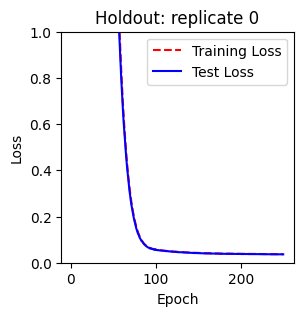

Training with replicate 1 heldout. # samples = 7879
HI
Epoch 1/250
50/50 [==============================] - 1s 7ms/step - loss: 35.9531 - mse: 2.2863 - mae: 1.1870 - val_loss: 33.8635 - val_mse: 0.5088 - val_mae: 0.5767
Epoch 2/250
50/50 [==============================] - 0s 4ms/step - loss: 35.2632 - mse: 2.1946 - mae: 1.1636 - val_loss: 33.3340 - val_mse: 0.5715 - val_mae: 0.6165
Epoch 3/250
50/50 [==============================] - 0s 5ms/step - loss: 34.5962 - mse: 2.1155 - mae: 1.1407 - val_loss: 32.8378 - val_mse: 0.6583 - val_mae: 0.6572
Epoch 4/250
50/50 [==============================] - 0s 5ms/step - loss: 33.9278 - mse: 2.0257 - mae: 1.1155 - val_loss: 32.3247 - val_mse: 0.7191 - val_mae: 0.6839
Epoch 5/250
50/50 [==============================] - 0s 5ms/step - loss: 33.2683 - mse: 1.9360 - mae: 1.0886 - val_loss: 31.7942 - val_mse: 0.7539 - val_mae: 0.6988
Epoch 6/250
50/50 [==============================] - 0s 5ms/step - loss: 32.6127 - mse: 1.8418 - mae: 1.0606 - val_loss:

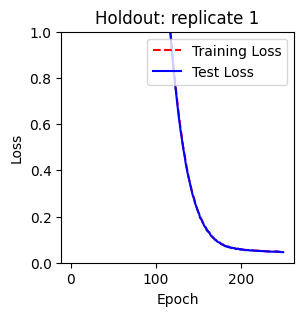

Training with replicate 2 heldout. # samples = 7879
HI
Epoch 1/250
50/50 [==============================] - 2s 9ms/step - loss: 35.8025 - mse: 2.2959 - mae: 1.1879 - val_loss: 33.6159 - val_mse: 0.4160 - val_mae: 0.5314
Epoch 2/250
50/50 [==============================] - 0s 4ms/step - loss: 35.1334 - mse: 2.2140 - mae: 1.1673 - val_loss: 33.1578 - val_mse: 0.5385 - val_mae: 0.5962
Epoch 3/250
50/50 [==============================] - 0s 5ms/step - loss: 34.4697 - mse: 2.1271 - mae: 1.1432 - val_loss: 32.6895 - val_mse: 0.6428 - val_mae: 0.6488
Epoch 4/250
50/50 [==============================] - 0s 5ms/step - loss: 33.8232 - mse: 2.0493 - mae: 1.1199 - val_loss: 32.1959 - val_mse: 0.7138 - val_mae: 0.6818
Epoch 5/250
50/50 [==============================] - 0s 5ms/step - loss: 33.1800 - mse: 1.9671 - mae: 1.0965 - val_loss: 31.6777 - val_mse: 0.7526 - val_mae: 0.6985
Epoch 6/250
50/50 [==============================] - 0s 5ms/step - loss: 32.5410 - mse: 1.8813 - mae: 1.0699 - val_loss:

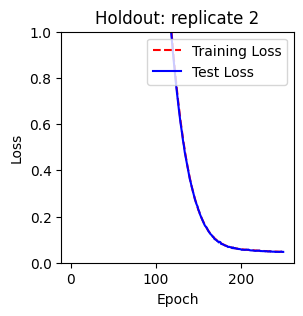

Inconsistencies found: 0 metabolites, 15 isotopolouges
Removing 3156 isotopolouges
File 0: /kidney-m0-no-log/glycerol-ND-M1-FML-ioncounts-ranks.csv || 0 to drop || 0 dropped
File 1: /kidney-m0-no-log/glycerol-ND-M2-FML-ioncounts-ranks.csv || 0 to drop || 0 dropped
File 2: /kidney-m0-no-log/glycerol-ND-M3-FML-ioncounts-ranks.csv || 0 to drop || 0 dropped
Ion-Data is all consistent! Time to train a model!
File 0: /kidney-m0-no-log/glycerol-ND-M1-FML-isotopolouges-ranks.csv || 3156 to drop || 3156 dropped
File 1: /kidney-m0-no-log/glycerol-ND-M2-FML-isotopolouges-ranks.csv || 3142 to drop || 3142 dropped
File 2: /kidney-m0-no-log/glycerol-ND-M3-FML-isotopolouges-ranks.csv || 3153 to drop || 3153 dropped
Iso-Data is all consistent! Time to train a model!
Testing with replicate 0 heldout. # samples = 7879
247/247 [==============================] - 0s 2ms/step
Testing with replicate 1 heldout. # samples = 16425
514/514 [==============================] - 1s 1ms/step
Testing with replicate 2 h

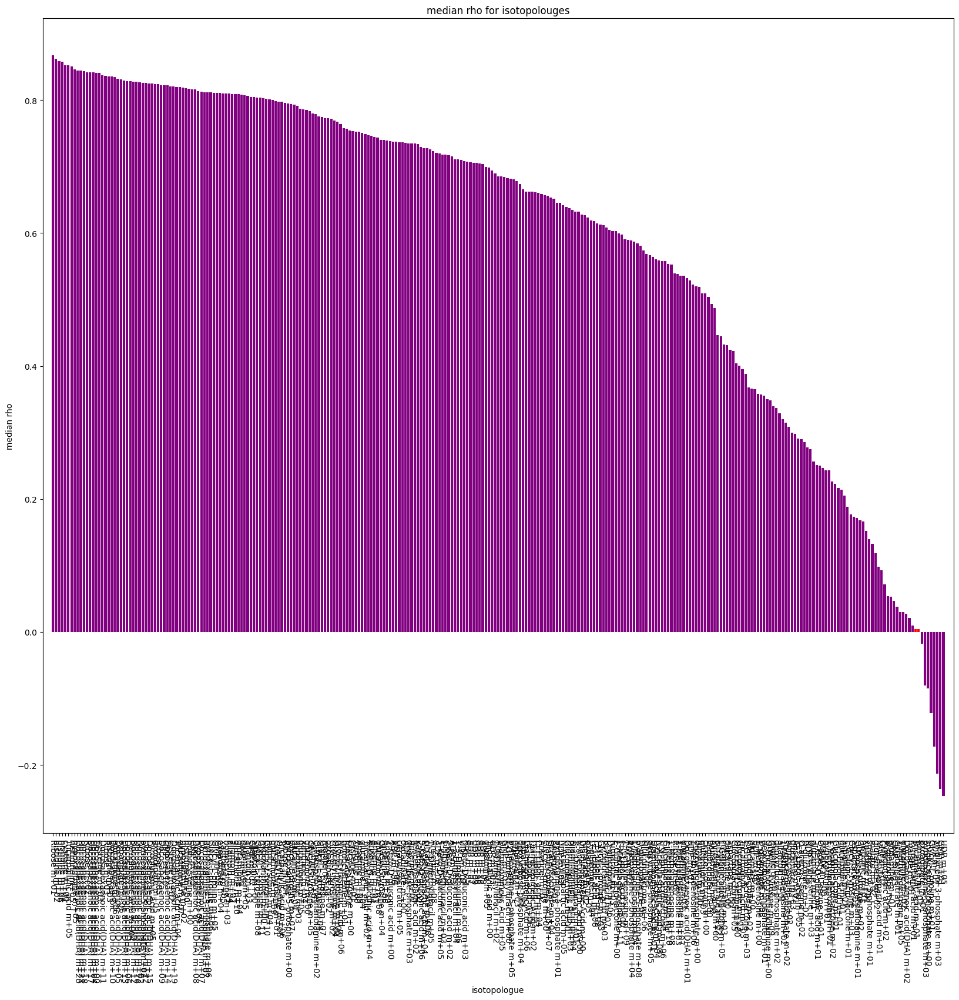

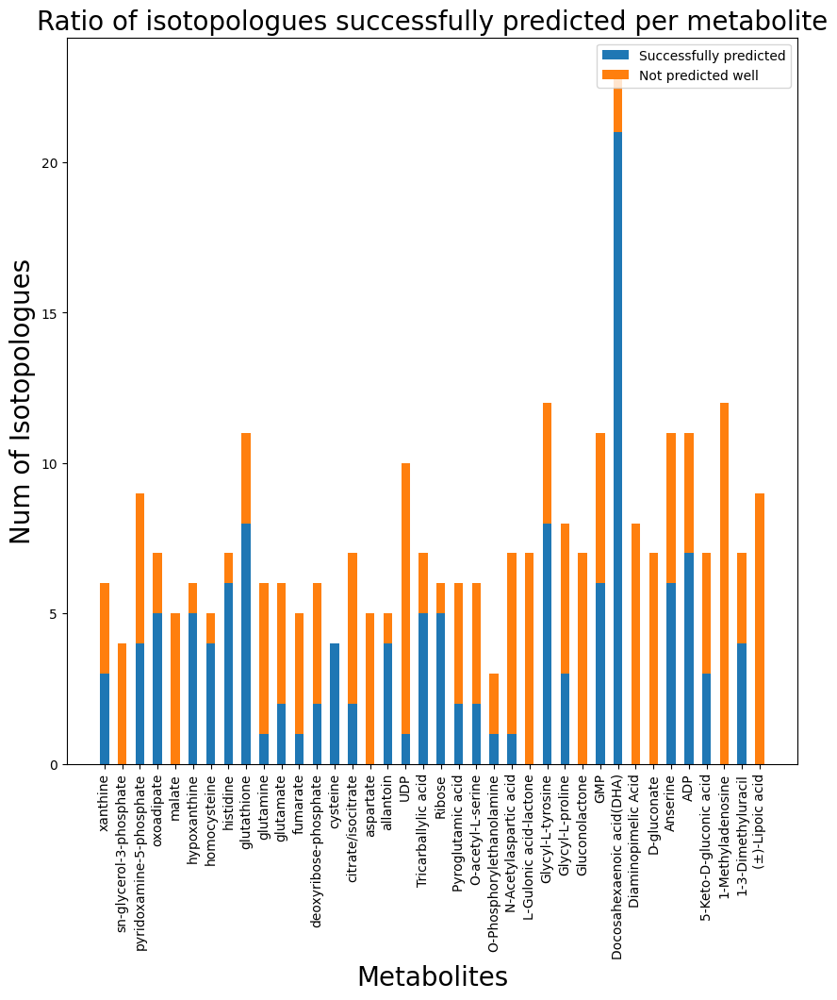

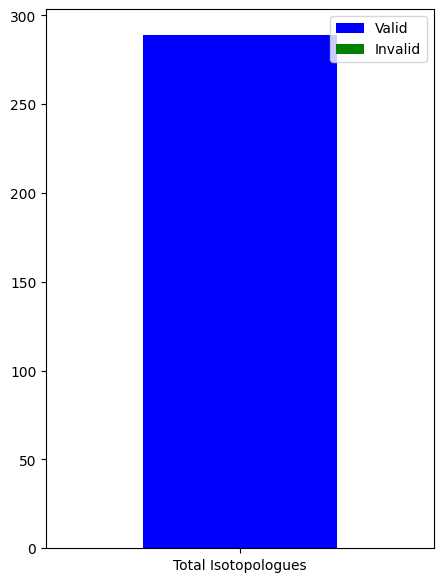

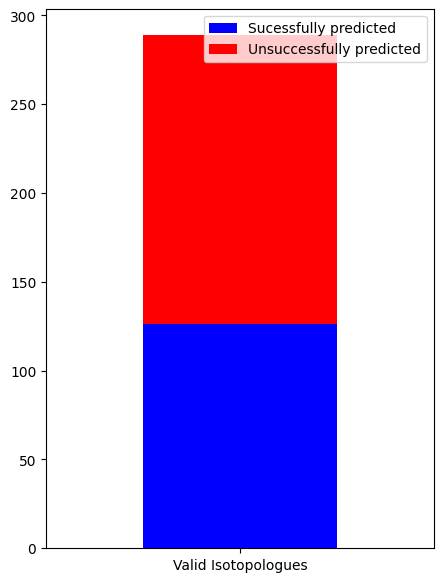

In [141]:
glycerol_ground, glycerol_predicted, glycerol_spearmans, glycerol_coords = full_pipeline(metab_names, moransi_scores, tracer = "glycerol")

In [142]:
print(glycerol_spearmans[0:20])

59                        Ribose m+01
72                     histidine m+02
76                     histidine m+06
74                     histidine m+04
5                       cysteine m+00
113          Tricarballylic acid m+05
75                     histidine m+05
35                  hypoxanthine m+05
248    Docosahexaenoic acid(DHA) m+20
249    Docosahexaenoic acid(DHA) m+21
246    Docosahexaenoic acid(DHA) m+18
60                        Ribose m+02
245    Docosahexaenoic acid(DHA) m+17
232    Docosahexaenoic acid(DHA) m+04
228    Docosahexaenoic acid(DHA) m+00
8                       cysteine m+03
239    Docosahexaenoic acid(DHA) m+11
61                        Ribose m+03
73                     histidine m+03
238    Docosahexaenoic acid(DHA) m+10
Name: isotopologue, dtype: object


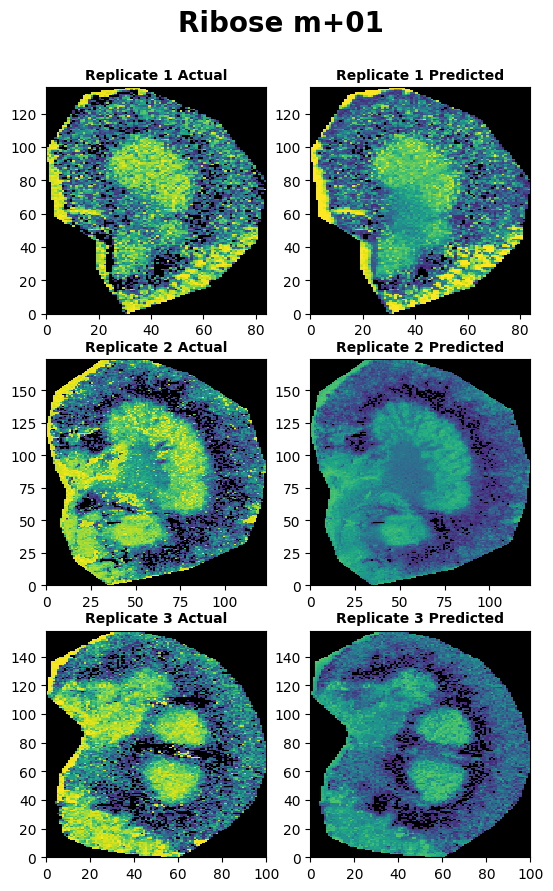

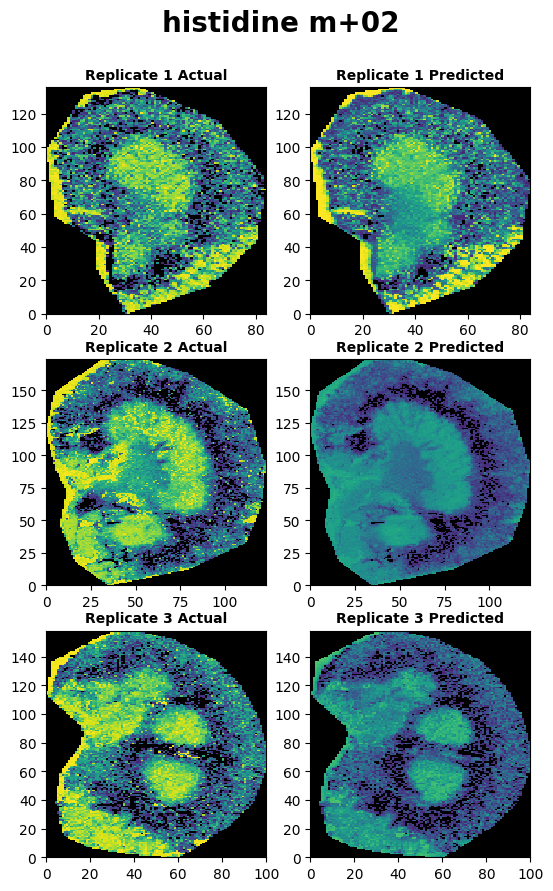

In [146]:
vis.cross_validation_results(glycerol_ground, glycerol_predicted, coords_df = glycerol_coords, iso_to_plot = "Ribose m+01", limited = True)
vis.cross_validation_results(glycerol_ground, glycerol_predicted, coords_df = glycerol_coords, iso_to_plot = "histidine m+02", limited = True)


# Citrate

In [84]:
M1_metab_names = ['Glyoxylic acid', 'Glycolamide', 'glycine', 'Trimethylamine N-oxide', 'Glycocholic acid', 'Glycolic acid', 'Cysteamine', 'pyruvate', 'alanine', 'lactate', '2-hydroxypyridine', 'Tiglic acid', 'acetoacetate', '2-Ketobutyric acid', 'Isovaleric acid', 'dimethylglycine', 'Malonic acid', '2-Hydroxybutyric acid', 'serine', 'Diethanolamine', 'glycerate', 'p-Benzoquinone', 'o-Cresol', 'Hypotaurine', 'Hydroquinone', 'cytosine', 'Histamine', '3-Furoic acid', 'uracil', 'Creatinine', 'Dihydrouracil', 'proline', 'fumarate', '2-Oxoisopentanoic acid', '4-Methylvaleric acid', 'N-Acetylglycine', 'Guanidoacetic acid', 'indole', 'betaine', 'succinate', '2-Hydroxyvaleric acid', 'Aminomalonic acid', 'homoserine', 'purine', 'cysteine', 'Benzoic acid', 'nicotinamide', 'nicotinate', 'Guaiacol', 'taurine', '5-Methylcytosine', 'thymine', '5-6-Dihydro Thymine', 'Pyroglutamic acid', 'DL-Pipecolic acid', 'Glutaconic acid', 'Methyloxovaleric acid (Ketoleucine)', 'N-Acetylputrescine', 'hydroxyproline', 'creatine', '3-Methylindole', 'leucine', 'Glutaric acid', 'asparagine', '2-Hydroxycaproic acid', 'ornithine', 'aspartate', 'malate', '2-Deoxy-D-ribose', 'homocysteine', 'adenine', 'L-Threonic acid', 'hypoxanthine', "N'-Methylnicotinamide", 'anthranilate', 'Phenylethanolamine', '3-Hydroxybenzoic acid', 'Urocanic acid', '6-Hydroxynicotinic acid', 'acetylphosphate', '1-3-Dimethyluracil', 'O-Phosphorylethanolamine', '5-Hydroxymethyluracil', '3-Methylglutaconic Acid', 'trans-4-Hydroxycyclohexanecarboxylic Acid', 'N-(5-Aminopentyl)acetamide', 'N-Butyrylglycine', '4-Guanidinobutanoic acid', 'Acetylcholine', 'a-ketoglutarate', 'Adipic acid', 'glutamine', 'lysine', 'glutamate', '2-hydroxyglutarate', 'methionine', 'Triethanolamine', 'Tartaric acid', 'Phenylglyoxylic acid', 'Ribose', '2-Phenylpropionic acid', 'guanine', 'N-Methyltyramine', 'xanthine', 'Mandelic acid', 'Adonitol', '3-Hydroxyanthranilic acid', 'Dopamine', 'Gentisic acid', 'histidine', '2-5-Furandicarboxylic acid', 'orotate', 'N-Tiglylglycine', 'L-Hydroorotic acid', 'allantoin', '4-6-Dioxoheptanoic acid', 'Indole-3-acetaldehyde', '2-Methylbutyrylglycine', 'Pargyline', 'DL-2-Aminooctanoic acid', 'oxoadipate', 'Pimelic acid', 'Tryptamine', '2-Hydroxyoctanoic acid', 'Indole-2-carboxylic acid', 'Aminoadipic acid', 'Indole-3-ethanol', 'carnitine', '2-Hydroxyhexanedioic Acid', 'DL-5-Hydroxylysine', '6-Dimethylaminopurine', 'phenylpyruvate', 'L-Fucose', '2-Phenylbutyric acid', 'Methionine sulfoxide', 'phenylalanine', 'L-(?)-3-Phenyllactic acid', 'D-Phenyllactic acid', 'quinolinate', 'Pyridoxal', 'Synephrine', '3-Methoxytyramine', 'PEP', 'Uric acid', 'Homogentisic acid', 'Pyridoxamine', 'L-Cysteic acid', '2-Amino-3-phosphonopropionic acid', '2-Furoylglycine', 'pyridoxine', '1-Methyl-Histidine', 'D-glyceraldehdye-3-phosphate', 'Diethylthiophosphate', 'sn-glycerol-3-phosphate', 'Menadione', 'Glycyl-L-proline', 'Quinaldic acid', 'Hexanoyl Glycine', 'aconitate', 'Shikimic acid', 'Suberic acid', 'arginine', 'N-Acetylaspartic acid', 'Indole-3-acetic acid', 'citrulline', 'Tricarballylic acid', 'N-carbamoyl-L-aspartate', '2-Isopropylmalic acid', 'Serotonin', 'N-Formyl-L-methionine', 'L-Gulonic acid-lactone', 'Gluconolactone', '5-Phenylvaleric acid', 'Isoxanthopterin', 'hydroxyphenylpyruvate', 'Nicotinuric acid', 'Glucose', '3-(3-Methoxyphenyl)propionic acid', 'tyrosine', 'Hydroxyphenyllactic acid', '4-Pyridoxic acid', 'Phosphorylcholine', 'DL -3-4-Dihydroxymandelic acid', 'Phosphoserine', 'Undecanoic acid', 'trans-3-Indoleacrylic acid', 'Glycyl-L-leucine', 'Homoarginine', 'N6-N6-N6-Trimethyllysine', 'Kynurenic acid', 'N-acetyl-glutamate', '3-Indolepropionic acid', 'Homocitrulline', 'Diaminopimelic Acid', '5-Methoxytryptamine', 'Hydroxyindoleacetic acid', 'N-Acetyl-L-methionine', 'citrate/isocitrate', 'Quinic acid', 'Phenylacetylglycine', '5-Keto-D-gluconic acid', '4-Aminohippuric acid', '2-Hydroxy Hippuric Acid', 'D-gluconate', '3-4-Dimethoxyphenylacetic acid', 'L-Dopa', 'DL-4-Hydroxy-3-methoxymandelic acid', 'O-phosphohomoserine', 'D-erythrose-4-phosphate', 'Cysteine S-sulfate', 'Capryloyl glycine', 'Sebacic acid', 'Indole-3-pyruvic acid', '3-Indolebutyric acid', 'N-Acetylcarnitine', 'tryptophan', 'Xanthurenic acid', 'DL-Indole-3-lactic acid', '(±)-Lipoic acid', 'N-Acetyl-L-phenylalanine', 'DL-Benzylsuccinic acid', 'L-Kynurenine', 'Mucic acid', 'Creatine phosphate', '3-Indoxyl sulfate', 'deoxyribose-phosphate', 'N-Acetylserotonin', 'pantothenate', '5-L-Hydroxytryptophan', '?-N-Acetylglucosamine', 'cystathionine', 'N-Acetyltyrosine', '3-Nitro-L- tyrosine', 'Carnosine', 'deoxyuridine', 'Myristic acid', 'ribose-phosphate', 'Suberyl Glycine', 'Melatonin', '5-Methoxytryptophan', 'Sepiapterin', '3-4-5-Trimethoxycinnamic acid', 'Glycyl-L-tyrosine', 'Anserine', 'thymidine', 'cytidine', 'uridine', 'biotin', 'Pyridoxal 5-phosphate', 'pyridoxamine-5-phosphate', 'Muramic acid', 'deoxyadenosine', 'deoxyinosine', 'Ribothymidine', 'glucosamine-6-phosphate', 'glucose-1-phosphate', 'Mannitol-1-phosphate', 'adenosine', 'homocystine', 'inosine', 'L-Aspartyl-L-phenylalanine', 'Linoleic acid', '1-Methyladenosine', 'guanosine', 'xanthosine', 'Stearic acid', "5'-Methylthioadenosine", '7-methylguanosine', 'Retinoic Acid', 'elcosapentaenoic acid', 'dCMP', 'glutathione', 'dUMP', 'N-Acetylneuraminic acid', 'Arachidic acid', 'CMP', 'UMP', 'Docosahexaenoic acid(DHA)', 'cyclic-AMP', 'dAMP', 'fructose-1-6-bisphosphate', 'Sucrose', 'AMP', 'dGMP', 'IMP', 'GMP', 'riboflavin', 'Lithocholic acid', 'S-adenosyl-L-homoCysteine', 'dCDP', 'Chenodeoxycholic acid', 'S-Adenosylmethionine', 'dTDP', 'CDP', 'UDP', 'Cholic acid', 'trehalose-6-Phosphate', 'Cysteine-glutathione disulphide', "adenosine 5'-phosphosulfate", 'ADP', 'IDP', 'folate', 'GDP', 'Glycodeoxycholic acid', 'Glycoursodeoxycholic acid', 'FMN', '5-methyl-THF', 'dCTP', 'dUTP', 'Folinic acid', 'dTTP', 'CTP', 'UTP', 'CDP-choline', 'dATP', 'Taurodeoxycholic acid', 'ATP', 'Inosine 5-triphosphate', 'GTP', 'Cyclic-ADP-ribose', 'D-Pantethine', 'UDP-D-glucose', 'Bilirubin', 'ADP-D-glucose', 'glutathione disulfide', 'NAD+', 'NADH', 'dephospho-CoA', 'NADP+', 'NADPH', 'coenzyme A', 'hyaluronate', 'FAD', 'acetyl-CoA', 'propionyl-CoA', 'butyryl-CoA', 'acetoacetyl-CoA', 'malonyl-CoA', 'Butyric acid', 'N-Acetyl-cysteine', 'N-Acetyl-L-arginine', 'N-Acetyl-L-asparagine', 'N-acetyl-L-glutamine', 'N-Acetyl-L-leucine', 'N-Acetyl-L-isoleucine', 'N-acetyl-L-ornithine', 'N-Acetyl-L-phenylalanine m', 'N-Acetyl-L-proline', 'O-acetyl-L-serine', 'Ala-Ala', 'Glycerophosphocholine', '2-Furoylglycine m', 'N-Iso valerylglycine', 'x', 'y']
M1_moransi_scores = [0.6544, 0.6423, 0.6308, 0.6443, 0.7015, 0.637, 0.6462, 0.515, 0.508, 0.5673, 0.6703, 0.6735, 0.5678, 0.5674, 0.6769, 0.5567, 0.6196, 0.6656, 0.5591, 0.6685, 0.681, 0.6803, 0.6834, 0.6168, 0.6772, 0.68, 0.6771, 0.5782, 0.61, 0.679, 0.6021, 0.6744, 0.7199, 0.6634, 0.6827, 0.6424, 0.6715, 0.6892, 0.6875, 0.6525, 0.686, 0.6742, 0.5864, 0.6691, 0.9118, 0.6848, 0.6885, 0.6888, 0.6917, 0.7477, 0.6909, 0.6413, 0.5752, 0.8236, 0.6902, 0.4864, 0.6892, 0.688, 0.5873, 0.7261, 0.6948, 0.6878, 0.6357, 0.5693, 0.6905, 0.6783, 0.8885, 0.8994, 0.6866, 0.8757, 0.7525, 0.6896, 0.8799, 0.693, 0.6835, 0.6937, 0.6911, 0.7303, 0.6271, 0.4718, 0.8503, 0.8257, 0.6772, 0.5464, 0.6938, 0.6943, 0.6816, 0.6898, 0.6913, 0.6646, 0.6834, 0.8343, 0.6977, 0.7532, 0.6481, 0.6904, 0.6913, 0.6779, 0.6832, 0.8359, 0.7002, 0.5743, 0.6969, 0.8853, 0.6685, 0.6848, 0.6804, 0.6963, 0.6349, 0.8482, 0.6861, 0.6693, 0.6622, 0.6829, 0.861, 0.6769, 0.6982, 0.6924, 0.6974, 0.6953, 0.9228, 0.6899, 0.7021, 0.6977, 0.701, 0.6399, 0.7046, 0.6907, 0.6415, 0.6866, 0.6906, 0.7014, 0.6876, 0.7024, 0.6679, 0.7269, 0.6773, 0.6901, 0.6898, 0.6772, 0.7031, 0.7036, 0.6373, 0.6947, 0.6748, 0.6993, 0.4654, 0.6637, 0.6708, 0.5267, 0.6943, 0.5308, 0.6922, 0.869, 0.6956, 0.7651, 0.69, 0.7271, 0.7387, 0.6548, 0.6916, 0.6838, 0.6466, 0.7018, 0.6496, 0.7756, 0.6724, 0.6882, 0.7025, 0.6653, 0.8369, 0.8365, 0.7031, 0.7358, 0.6858, 0.6946, 0.6903, 0.6847, 0.6996, 0.6791, 0.872, 0.6811, 0.5613, 0.5686, 0.7019, 0.6814, 0.7112, 0.6965, 0.6962, 0.6943, 0.7044, 0.7027, 0.6957, 0.7425, 0.7038, 0.6901, 0.6302, 0.757, 0.691, 0.6974, 0.8668, 0.6891, 0.6129, 0.8557, 0.6796, 0.5941, 0.6223, 0.6813, 0.6426, 0.6906, 0.7017, 0.7029, 0.6944, 0.6978, 0.7007, 0.704, 0.7168, 0.682, 0.742, 0.7165, 0.6957, 0.6988, 0.6224, 0.6931, 0.6878, 0.9344, 0.6978, 0.6953, 0.6438, 0.7018, 0.6914, 0.7056, 0.6926, 0.742, 0.695, 0.7072, 0.588, 0.7067, 0.7064, 0.6979, 0.6981, 0.7052, 0.7955, 0.756, 0.6978, 0.6856, 0.6423, 0.6897, 0.6974, 0.8428, 0.7072, 0.7025, 0.7021, 0.6505, 0.6502, 0.6473, 0.7076, 0.6743, 0.6881, 0.8862, 0.5912, 0.735, 0.7406, 0.6981, 0.6938, 0.7035, 0.6762, 0.7097, 0.7106, 0.7235, 0.7051, 0.9017, 0.7036, 0.624, 0.7133, 0.7094, 0.56, 0.8248, 0.6939, 0.6797, 0.671, 0.6795, 0.694, 0.694, 0.6739, 0.7299, 0.694, 0.7145, 0.7063, 0.7089, 0.7077, 0.6899, 0.7099, 0.7097, 0.7237, 0.715, 0.71, 0.7045, 0.7093, 0.7649, 0.7113, 0.7071, 0.7091, 0.7141, 0.7141, 0.7109, 0.6707, 0.7099, 0.7105, 0.7003, 0.7112, 0.7112, 0.7125, 0.7115, 0.7104, 0.7154, 0.7127, 0.7093, 0.7138, 0.7133, 0.7145, 0.7133, 0.715, 0.7135, 0.7137, 0.7134, 0.7145, 0.7138, 0.7144, 0.714, 0.7144, 0.7149, 0.7147, 0.7162, 0.7147, 0.7151, 0.7152, 0.7161, 0.6543, 0.6442, 0.703, 0.6735, 0.6976, 0.7271, 0.7271, 0.6915, 0.7165, 0.6657, 0.7532, 0.7127, 0.7024, 0.6714, 0.6916]
M2_metab_names = ['Glyoxylic acid', 'Glycolamide', 'glycine', 'Trimethylamine N-oxide', 'Glycocholic acid', 'Glycolic acid', 'Cysteamine', 'pyruvate', 'alanine', 'lactate', '2-hydroxypyridine', 'Tiglic acid', 'acetoacetate', '2-Ketobutyric acid', 'Isovaleric acid', 'dimethylglycine', 'Malonic acid', '2-Hydroxybutyric acid', 'serine', 'Diethanolamine', 'glycerate', 'p-Benzoquinone', 'o-Cresol', 'Hypotaurine', 'Hydroquinone', 'cytosine', 'Histamine', '3-Furoic acid', 'uracil', 'Creatinine', 'Dihydrouracil', 'proline', 'fumarate', '2-Oxoisopentanoic acid', '4-Methylvaleric acid', 'N-Acetylglycine', 'Guanidoacetic acid', 'indole', 'betaine', 'succinate', '2-Hydroxyvaleric acid', 'Aminomalonic acid', 'homoserine', 'purine', 'cysteine', 'Benzoic acid', 'nicotinamide', 'nicotinate', 'Guaiacol', 'taurine', '5-Methylcytosine', 'thymine', '5-6-Dihydro Thymine', 'Pyroglutamic acid', 'DL-Pipecolic acid', 'Glutaconic acid', 'Methyloxovaleric acid (Ketoleucine)', 'N-Acetylputrescine', 'hydroxyproline', 'creatine', '3-Methylindole', 'leucine', 'Glutaric acid', 'asparagine', '2-Hydroxycaproic acid', 'ornithine', 'aspartate', 'malate', '2-Deoxy-D-ribose', 'homocysteine', 'adenine', 'L-Threonic acid', 'hypoxanthine', "N'-Methylnicotinamide", 'anthranilate', 'Phenylethanolamine', '3-Hydroxybenzoic acid', 'Urocanic acid', '6-Hydroxynicotinic acid', 'acetylphosphate', '1-3-Dimethyluracil', 'O-Phosphorylethanolamine', '5-Hydroxymethyluracil', '3-Methylglutaconic Acid', 'trans-4-Hydroxycyclohexanecarboxylic Acid', 'N-(5-Aminopentyl)acetamide', 'N-Butyrylglycine', '4-Guanidinobutanoic acid', 'Acetylcholine', 'a-ketoglutarate', 'Adipic acid', 'glutamine', 'lysine', 'glutamate', '2-hydroxyglutarate', 'methionine', 'Triethanolamine', 'Tartaric acid', 'Phenylglyoxylic acid', 'Ribose', '2-Phenylpropionic acid', 'guanine', 'N-Methyltyramine', 'xanthine', 'Mandelic acid', 'Adonitol', '3-Hydroxyanthranilic acid', 'Dopamine', 'Gentisic acid', 'histidine', '2-5-Furandicarboxylic acid', 'orotate', 'N-Tiglylglycine', 'L-Hydroorotic acid', 'allantoin', '4-6-Dioxoheptanoic acid', 'Indole-3-acetaldehyde', '2-Methylbutyrylglycine', 'Pargyline', 'DL-2-Aminooctanoic acid', 'oxoadipate', 'Pimelic acid', 'Tryptamine', '2-Hydroxyoctanoic acid', 'Indole-2-carboxylic acid', 'Aminoadipic acid', 'Indole-3-ethanol', 'carnitine', '2-Hydroxyhexanedioic Acid', 'DL-5-Hydroxylysine', '6-Dimethylaminopurine', 'phenylpyruvate', 'L-Fucose', '2-Phenylbutyric acid', 'Methionine sulfoxide', 'phenylalanine', 'L-(?)-3-Phenyllactic acid', 'D-Phenyllactic acid', 'quinolinate', 'Pyridoxal', 'Synephrine', '3-Methoxytyramine', 'PEP', 'Uric acid', 'Homogentisic acid', 'Pyridoxamine', 'L-Cysteic acid', '2-Amino-3-phosphonopropionic acid', '2-Furoylglycine', 'pyridoxine', '1-Methyl-Histidine', 'D-glyceraldehdye-3-phosphate', 'Diethylthiophosphate', 'sn-glycerol-3-phosphate', 'Menadione', 'Glycyl-L-proline', 'Quinaldic acid', 'Hexanoyl Glycine', 'aconitate', 'Shikimic acid', 'Suberic acid', 'arginine', 'N-Acetylaspartic acid', 'Indole-3-acetic acid', 'citrulline', 'Tricarballylic acid', 'N-carbamoyl-L-aspartate', '2-Isopropylmalic acid', 'Serotonin', 'N-Formyl-L-methionine', 'L-Gulonic acid-lactone', 'Gluconolactone', '5-Phenylvaleric acid', 'Isoxanthopterin', 'hydroxyphenylpyruvate', 'Nicotinuric acid', 'Glucose', '3-(3-Methoxyphenyl)propionic acid', 'tyrosine', 'Hydroxyphenyllactic acid', '4-Pyridoxic acid', 'Phosphorylcholine', 'DL -3-4-Dihydroxymandelic acid', 'Phosphoserine', 'Undecanoic acid', 'trans-3-Indoleacrylic acid', 'Glycyl-L-leucine', 'Homoarginine', 'N6-N6-N6-Trimethyllysine', 'Kynurenic acid', 'N-acetyl-glutamate', '3-Indolepropionic acid', 'Homocitrulline', 'Diaminopimelic Acid', '5-Methoxytryptamine', 'Hydroxyindoleacetic acid', 'N-Acetyl-L-methionine', 'citrate/isocitrate', 'Quinic acid', 'Phenylacetylglycine', '5-Keto-D-gluconic acid', '4-Aminohippuric acid', '2-Hydroxy Hippuric Acid', 'D-gluconate', '3-4-Dimethoxyphenylacetic acid', 'L-Dopa', 'DL-4-Hydroxy-3-methoxymandelic acid', 'O-phosphohomoserine', 'D-erythrose-4-phosphate', 'Cysteine S-sulfate', 'Capryloyl glycine', 'Sebacic acid', 'Indole-3-pyruvic acid', '3-Indolebutyric acid', 'N-Acetylcarnitine', 'tryptophan', 'Xanthurenic acid', 'DL-Indole-3-lactic acid', '(±)-Lipoic acid', 'N-Acetyl-L-phenylalanine', 'DL-Benzylsuccinic acid', 'L-Kynurenine', 'Mucic acid', 'Creatine phosphate', '3-Indoxyl sulfate', 'deoxyribose-phosphate', 'N-Acetylserotonin', 'pantothenate', '5-L-Hydroxytryptophan', '?-N-Acetylglucosamine', 'cystathionine', 'N-Acetyltyrosine', '3-Nitro-L- tyrosine', 'Carnosine', 'deoxyuridine', 'Myristic acid', 'ribose-phosphate', 'Suberyl Glycine', 'Melatonin', '5-Methoxytryptophan', 'Sepiapterin', '3-4-5-Trimethoxycinnamic acid', 'Glycyl-L-tyrosine', 'Anserine', 'thymidine', 'cytidine', 'uridine', 'biotin', 'Pyridoxal 5-phosphate', 'pyridoxamine-5-phosphate', 'Muramic acid', 'deoxyadenosine', 'deoxyinosine', 'Ribothymidine', 'glucosamine-6-phosphate', 'glucose-1-phosphate', 'Mannitol-1-phosphate', 'adenosine', 'homocystine', 'inosine', 'L-Aspartyl-L-phenylalanine', 'Linoleic acid', '1-Methyladenosine', 'guanosine', 'xanthosine', 'Stearic acid', "5'-Methylthioadenosine", '7-methylguanosine', 'Retinoic Acid', 'elcosapentaenoic acid', 'dCMP', 'glutathione', 'dUMP', 'N-Acetylneuraminic acid', 'Arachidic acid', 'CMP', 'UMP', 'Docosahexaenoic acid(DHA)', 'cyclic-AMP', 'dAMP', 'fructose-1-6-bisphosphate', 'Sucrose', 'AMP', 'dGMP', 'IMP', 'GMP', 'riboflavin', 'Lithocholic acid', 'S-adenosyl-L-homoCysteine', 'dCDP', 'Chenodeoxycholic acid', 'S-Adenosylmethionine', 'dTDP', 'CDP', 'UDP', 'Cholic acid', 'trehalose-6-Phosphate', 'Cysteine-glutathione disulphide', "adenosine 5'-phosphosulfate", 'ADP', 'IDP', 'folate', 'GDP', 'Glycodeoxycholic acid', 'Glycoursodeoxycholic acid', 'FMN', '5-methyl-THF', 'dCTP', 'dUTP', 'Folinic acid', 'dTTP', 'CTP', 'UTP', 'CDP-choline', 'dATP', 'Taurodeoxycholic acid', 'ATP', 'Inosine 5-triphosphate', 'GTP', 'Cyclic-ADP-ribose', 'D-Pantethine', 'UDP-D-glucose', 'Bilirubin', 'ADP-D-glucose', 'glutathione disulfide', 'NAD+', 'NADH', 'dephospho-CoA', 'NADP+', 'NADPH', 'coenzyme A', 'hyaluronate', 'FAD', 'acetyl-CoA', 'propionyl-CoA', 'butyryl-CoA', 'acetoacetyl-CoA', 'malonyl-CoA', 'Butyric acid', 'N-Acetyl-cysteine', 'N-Acetyl-L-arginine', 'N-Acetyl-L-asparagine', 'N-acetyl-L-glutamine', 'N-Acetyl-L-leucine', 'N-Acetyl-L-isoleucine', 'N-acetyl-L-ornithine', 'N-Acetyl-L-phenylalanine m', 'N-Acetyl-L-proline', 'O-acetyl-L-serine', 'Ala-Ala', 'Glycerophosphocholine', '2-Furoylglycine m', 'N-Iso valerylglycine', 'x', 'y']
M2_moransi_scores = [0.7496, 0.7175, 0.6802, 0.7668, 0.8068, 0.7234, 0.754, 0.7766, 0.7312, 0.7291, 0.7722, 0.7642, 0.6582, 0.6582, 0.7818, 0.7053, 0.6627, 0.7668, 0.7426, 0.775, 0.7881, 0.7908, 0.7828, 0.6685, 0.7622, 0.7814, 0.7863, 0.832, 0.6841, 0.7751, 0.7244, 0.7381, 0.8565, 0.6861, 0.7864, 0.6882, 0.7435, 0.7978, 0.7854, 0.827, 0.7908, 0.7746, 0.7851, 0.8079, 0.847, 0.7808, 0.7951, 0.7626, 0.7936, 0.9054, 0.7822, 0.7315, 0.655, 0.8464, 0.7715, 0.8282, 0.7797, 0.7971, 0.6955, 0.764, 0.8047, 0.7906, 0.6688, 0.6708, 0.7683, 0.7853, 0.9186, 0.9055, 0.7857, 0.8807, 0.8883, 0.9281, 0.8814, 0.7954, 0.7553, 0.8055, 0.7392, 0.6923, 0.4722, 0.7451, 0.7875, 0.8827, 0.6436, 0.6568, 0.7816, 0.7982, 0.8548, 0.7991, 0.8027, 0.862, 0.744, 0.8914, 0.751, 0.8314, 0.8636, 0.8227, 0.8017, 0.7101, 0.7763, 0.8485, 0.8052, 0.8351, 0.7994, 0.8654, 0.767, 0.7597, 0.7463, 0.7863, 0.7593, 0.8579, 0.771, 0.8604, 0.6229, 0.6159, 0.9508, 0.7438, 0.8009, 0.7676, 0.7982, 0.8027, 0.8266, 0.7439, 0.8075, 0.8068, 0.7975, 0.6625, 0.8074, 0.8045, 0.6687, 0.7972, 0.81, 0.7438, 0.735, 0.7913, 0.7557, 0.9107, 0.5272, 0.5935, 0.8063, 0.6687, 0.8076, 0.8075, 0.7617, 0.8866, 0.6466, 0.7848, 0.6104, 0.7976, 0.6927, 0.705, 0.7622, 0.7781, 0.7814, 0.9354, 0.7971, 0.9047, 0.7726, 0.9122, 0.9417, 0.75, 0.7898, 0.7682, 0.89, 0.7955, 0.7744, 0.9371, 0.7213, 0.7146, 0.8026, 0.6347, 0.9066, 0.907, 0.8085, 0.8986, 0.773, 0.8371, 0.7754, 0.726, 0.815, 0.6921, 0.6771, 0.8271, 0.5895, 0.8404, 0.8094, 0.7678, 0.763, 0.8043, 0.8079, 0.8438, 0.7031, 0.7712, 0.7869, 0.7856, 0.8092, 0.7317, 0.661, 0.9198, 0.8037, 0.7475, 0.9215, 0.61, 0.8237, 0.9668, 0.7692, 0.5869, 0.7951, 0.495, 0.7257, 0.7989, 0.8044, 0.7697, 0.75, 0.7713, 0.7641, 0.7627, 0.8997, 0.6631, 0.8463, 0.7485, 0.6934, 0.6348, 0.8085, 0.7918, 0.8272, 0.8519, 0.7955, 0.7618, 0.7233, 0.7804, 0.7347, 0.7251, 0.7538, 0.6979, 0.6574, 0.8119, 0.6993, 0.7237, 0.8095, 0.7485, 0.7638, 0.7852, 0.8065, 0.7842, 0.615, 0.6494, 0.8586, 0.6018, 0.7355, 0.8844, 0.719, 0.6672, 0.7883, 0.664, 0.6687, 0.7816, 0.7043, 0.621, 0.8614, 0.8728, 0.6981, 0.7495, 0.7856, 0.7064, 0.7761, 0.7382, 0.7078, 0.7183, 0.8182, 0.8282, 0.7784, 0.851, 0.6997, 0.7668, 0.817, 0.7707, 0.7044, 0.7991, 0.7171, 0.7885, 0.7525, 0.7447, 0.7927, 0.7927, 0.6879, 0.8187, 0.751, 0.8198, 0.7842, 0.8137, 0.8187, 0.7949, 0.7572, 0.8039, 0.7978, 0.8185, 0.7825, 0.7282, 0.8187, 0.8516, 0.8188, 0.7926, 0.8208, 0.8196, 0.8196, 0.7924, 0.7806, 0.8185, 0.8185, 0.7572, 0.8141, 0.8068, 0.8124, 0.8127, 0.8185, 0.8222, 0.8344, 0.8184, 0.818, 0.8172, 0.8185, 0.8172, 0.8188, 0.8178, 0.8178, 0.8182, 0.8179, 0.8193, 0.8188, 0.8177, 0.8187, 0.8192, 0.8194, 0.8186, 0.819, 0.8194, 0.8189, 0.8196, 0.7334, 0.7287, 0.8013, 0.7691, 0.8616, 0.9122, 0.9122, 0.7804, 0.7485, 0.6125, 0.8314, 0.791, 0.6734, 0.6927, 0.756]
M3_metab_names = ['Glyoxylic acid', 'Glycolamide', 'glycine', 'Trimethylamine N-oxide', 'Glycocholic acid', 'Glycolic acid', 'Cysteamine', 'pyruvate', 'alanine', 'lactate', '2-hydroxypyridine', 'Tiglic acid', 'acetoacetate', '2-Ketobutyric acid', 'Isovaleric acid', 'dimethylglycine', 'Malonic acid', '2-Hydroxybutyric acid', 'serine', 'Diethanolamine', 'glycerate', 'p-Benzoquinone', 'o-Cresol', 'Hypotaurine', 'Hydroquinone', 'cytosine', 'Histamine', '3-Furoic acid', 'uracil', 'Creatinine', 'Dihydrouracil', 'proline', 'fumarate', '2-Oxoisopentanoic acid', '4-Methylvaleric acid', 'N-Acetylglycine', 'Guanidoacetic acid', 'indole', 'betaine', 'succinate', '2-Hydroxyvaleric acid', 'Aminomalonic acid', 'homoserine', 'purine', 'cysteine', 'Benzoic acid', 'nicotinamide', 'nicotinate', 'Guaiacol', 'taurine', '5-Methylcytosine', 'thymine', '5-6-Dihydro Thymine', 'Pyroglutamic acid', 'DL-Pipecolic acid', 'Glutaconic acid', 'Methyloxovaleric acid (Ketoleucine)', 'N-Acetylputrescine', 'hydroxyproline', 'creatine', '3-Methylindole', 'leucine', 'Glutaric acid', 'asparagine', '2-Hydroxycaproic acid', 'ornithine', 'aspartate', 'malate', '2-Deoxy-D-ribose', 'homocysteine', 'adenine', 'L-Threonic acid', 'hypoxanthine', "N'-Methylnicotinamide", 'anthranilate', 'Phenylethanolamine', '3-Hydroxybenzoic acid', 'Urocanic acid', '6-Hydroxynicotinic acid', 'acetylphosphate', '1-3-Dimethyluracil', 'O-Phosphorylethanolamine', '5-Hydroxymethyluracil', '3-Methylglutaconic Acid', 'trans-4-Hydroxycyclohexanecarboxylic Acid', 'N-(5-Aminopentyl)acetamide', 'N-Butyrylglycine', '4-Guanidinobutanoic acid', 'Acetylcholine', 'a-ketoglutarate', 'Adipic acid', 'glutamine', 'lysine', 'glutamate', '2-hydroxyglutarate', 'methionine', 'Triethanolamine', 'Tartaric acid', 'Phenylglyoxylic acid', 'Ribose', '2-Phenylpropionic acid', 'guanine', 'N-Methyltyramine', 'xanthine', 'Mandelic acid', 'Adonitol', '3-Hydroxyanthranilic acid', 'Dopamine', 'Gentisic acid', 'histidine', '2-5-Furandicarboxylic acid', 'orotate', 'N-Tiglylglycine', 'L-Hydroorotic acid', 'allantoin', '4-6-Dioxoheptanoic acid', 'Indole-3-acetaldehyde', '2-Methylbutyrylglycine', 'Pargyline', 'DL-2-Aminooctanoic acid', 'oxoadipate', 'Pimelic acid', 'Tryptamine', '2-Hydroxyoctanoic acid', 'Indole-2-carboxylic acid', 'Aminoadipic acid', 'Indole-3-ethanol', 'carnitine', '2-Hydroxyhexanedioic Acid', 'DL-5-Hydroxylysine', '6-Dimethylaminopurine', 'phenylpyruvate', 'L-Fucose', '2-Phenylbutyric acid', 'Methionine sulfoxide', 'phenylalanine', 'L-(?)-3-Phenyllactic acid', 'D-Phenyllactic acid', 'quinolinate', 'Pyridoxal', 'Synephrine', '3-Methoxytyramine', 'PEP', 'Uric acid', 'Homogentisic acid', 'Pyridoxamine', 'L-Cysteic acid', '2-Amino-3-phosphonopropionic acid', '2-Furoylglycine', 'pyridoxine', '1-Methyl-Histidine', 'D-glyceraldehdye-3-phosphate', 'Diethylthiophosphate', 'sn-glycerol-3-phosphate', 'Menadione', 'Glycyl-L-proline', 'Quinaldic acid', 'Hexanoyl Glycine', 'aconitate', 'Shikimic acid', 'Suberic acid', 'arginine', 'N-Acetylaspartic acid', 'Indole-3-acetic acid', 'citrulline', 'Tricarballylic acid', 'N-carbamoyl-L-aspartate', '2-Isopropylmalic acid', 'Serotonin', 'N-Formyl-L-methionine', 'L-Gulonic acid-lactone', 'Gluconolactone', '5-Phenylvaleric acid', 'Isoxanthopterin', 'hydroxyphenylpyruvate', 'Nicotinuric acid', 'Glucose', '3-(3-Methoxyphenyl)propionic acid', 'tyrosine', 'Hydroxyphenyllactic acid', '4-Pyridoxic acid', 'Phosphorylcholine', 'DL -3-4-Dihydroxymandelic acid', 'Phosphoserine', 'Undecanoic acid', 'trans-3-Indoleacrylic acid', 'Glycyl-L-leucine', 'Homoarginine', 'N6-N6-N6-Trimethyllysine', 'Kynurenic acid', 'N-acetyl-glutamate', '3-Indolepropionic acid', 'Homocitrulline', 'Diaminopimelic Acid', '5-Methoxytryptamine', 'Hydroxyindoleacetic acid', 'N-Acetyl-L-methionine', 'citrate/isocitrate', 'Quinic acid', 'Phenylacetylglycine', '5-Keto-D-gluconic acid', '4-Aminohippuric acid', '2-Hydroxy Hippuric Acid', 'D-gluconate', '3-4-Dimethoxyphenylacetic acid', 'L-Dopa', 'DL-4-Hydroxy-3-methoxymandelic acid', 'O-phosphohomoserine', 'D-erythrose-4-phosphate', 'Cysteine S-sulfate', 'Capryloyl glycine', 'Sebacic acid', 'Indole-3-pyruvic acid', '3-Indolebutyric acid', 'N-Acetylcarnitine', 'tryptophan', 'Xanthurenic acid', 'DL-Indole-3-lactic acid', '(±)-Lipoic acid', 'N-Acetyl-L-phenylalanine', 'DL-Benzylsuccinic acid', 'L-Kynurenine', 'Mucic acid', 'Creatine phosphate', '3-Indoxyl sulfate', 'deoxyribose-phosphate', 'N-Acetylserotonin', 'pantothenate', '5-L-Hydroxytryptophan', '?-N-Acetylglucosamine', 'cystathionine', 'N-Acetyltyrosine', '3-Nitro-L- tyrosine', 'Carnosine', 'deoxyuridine', 'Myristic acid', 'ribose-phosphate', 'Suberyl Glycine', 'Melatonin', '5-Methoxytryptophan', 'Sepiapterin', '3-4-5-Trimethoxycinnamic acid', 'Glycyl-L-tyrosine', 'Anserine', 'thymidine', 'cytidine', 'uridine', 'biotin', 'Pyridoxal 5-phosphate', 'pyridoxamine-5-phosphate', 'Muramic acid', 'deoxyadenosine', 'deoxyinosine', 'Ribothymidine', 'glucosamine-6-phosphate', 'glucose-1-phosphate', 'Mannitol-1-phosphate', 'adenosine', 'homocystine', 'inosine', 'L-Aspartyl-L-phenylalanine', 'Linoleic acid', '1-Methyladenosine', 'guanosine', 'xanthosine', 'Stearic acid', "5'-Methylthioadenosine", '7-methylguanosine', 'Retinoic Acid', 'elcosapentaenoic acid', 'dCMP', 'glutathione', 'dUMP', 'N-Acetylneuraminic acid', 'Arachidic acid', 'CMP', 'UMP', 'Docosahexaenoic acid(DHA)', 'cyclic-AMP', 'dAMP', 'fructose-1-6-bisphosphate', 'Sucrose', 'AMP', 'dGMP', 'IMP', 'GMP', 'riboflavin', 'Lithocholic acid', 'S-adenosyl-L-homoCysteine', 'dCDP', 'Chenodeoxycholic acid', 'S-Adenosylmethionine', 'dTDP', 'CDP', 'UDP', 'Cholic acid', 'trehalose-6-Phosphate', 'Cysteine-glutathione disulphide', "adenosine 5'-phosphosulfate", 'ADP', 'IDP', 'folate', 'GDP', 'Glycodeoxycholic acid', 'Glycoursodeoxycholic acid', 'FMN', '5-methyl-THF', 'dCTP', 'dUTP', 'Folinic acid', 'dTTP', 'CTP', 'UTP', 'CDP-choline', 'dATP', 'Taurodeoxycholic acid', 'ATP', 'Inosine 5-triphosphate', 'GTP', 'Cyclic-ADP-ribose', 'D-Pantethine', 'UDP-D-glucose', 'Bilirubin', 'ADP-D-glucose', 'glutathione disulfide', 'NAD+', 'NADH', 'dephospho-CoA', 'NADP+', 'NADPH', 'coenzyme A', 'hyaluronate', 'FAD', 'acetyl-CoA', 'propionyl-CoA', 'butyryl-CoA', 'acetoacetyl-CoA', 'malonyl-CoA', 'Butyric acid', 'N-Acetyl-cysteine', 'N-Acetyl-L-arginine', 'N-Acetyl-L-asparagine', 'N-acetyl-L-glutamine', 'N-Acetyl-L-leucine', 'N-Acetyl-L-isoleucine', 'N-acetyl-L-ornithine', 'N-Acetyl-L-phenylalanine m', 'N-Acetyl-L-proline', 'O-acetyl-L-serine', 'Ala-Ala', 'Glycerophosphocholine', '2-Furoylglycine m', 'N-Iso valerylglycine', 'x', 'y']
M3_moransi_scores = [0.4775, 0.4788, 0.4626, 0.4915, 0.5012, 0.4722, 0.478, 0.493, 0.6218, 0.469, 0.4861, 0.4896, 0.4343, 0.4342, 0.4912, 0.4307, 0.441, 0.4804, 0.4631, 0.4891, 0.4778, 0.4944, 0.4983, 0.6107, 0.4938, 0.4892, 0.4927, 0.6984, 0.4659, 0.4899, 0.4219, 0.4731, 0.7617, 0.5109, 0.4941, 0.5939, 0.4788, 0.4953, 0.4914, 0.5675, 0.4876, 0.4884, 0.4635, 0.4629, 0.9057, 0.4982, 0.4974, 0.4934, 0.4998, 0.7723, 0.4991, 0.486, 0.67, 0.9274, 0.4945, 0.7551, 0.4932, 0.4932, 0.5648, 0.7871, 0.5017, 0.4993, 0.5395, 0.4849, 0.491, 0.4926, 0.9226, 0.9011, 0.4912, 0.8343, 0.6481, 0.8251, 0.8284, 0.4953, 0.4942, 0.505, 0.4962, 0.7299, 0.4315, 0.416, 0.7987, 0.8322, 0.477, 0.5646, 0.4903, 0.4999, 0.5226, 0.499, 0.4978, 0.5027, 0.4805, 0.9447, 0.5126, 0.6751, 0.8577, 0.489, 0.4992, 0.4798, 0.5081, 0.9185, 0.5007, 0.5293, 0.5018, 0.8283, 0.5098, 0.4985, 0.505, 0.4983, 0.4732, 0.9234, 0.5086, 0.493, 0.5463, 0.4908, 0.7771, 0.4922, 0.5012, 0.4964, 0.5021, 0.5004, 0.8751, 0.4965, 0.5005, 0.5, 0.498, 0.4904, 0.5038, 0.5029, 0.6079, 0.4712, 0.5013, 0.4965, 0.5376, 0.5005, 0.4953, 0.5774, 0.4687, 0.4848, 0.5026, 0.4752, 0.5034, 0.5033, 0.5998, 0.5653, 0.4747, 0.5004, 0.6612, 0.5405, 0.478, 0.4775, 0.5366, 0.4491, 0.496, 0.9077, 0.4929, 0.8989, 0.5007, 0.5802, 0.8178, 0.6663, 0.497, 0.5779, 0.7195, 0.4997, 0.5925, 0.8203, 0.5198, 0.4856, 0.503, 0.5056, 0.8291, 0.8287, 0.5059, 0.5774, 0.4609, 0.5546, 0.6688, 0.4795, 0.5189, 0.4687, 0.8874, 0.4909, 0.5889, 0.5136, 0.5026, 0.4936, 0.7366, 0.5002, 0.5024, 0.4938, 0.7743, 0.5065, 0.4963, 0.8001, 0.5024, 0.4908, 0.5895, 0.733, 0.6432, 0.4885, 0.8884, 0.5795, 0.4719, 0.914, 0.4946, 0.4732, 0.6054, 0.5772, 0.5005, 0.4986, 0.5032, 0.5044, 0.5465, 0.5028, 0.5032, 0.5275, 0.5119, 0.55, 0.7912, 0.7084, 0.4918, 0.5855, 0.6036, 0.4712, 0.5165, 0.9142, 0.5, 0.4954, 0.6466, 0.6745, 0.5401, 0.5572, 0.6024, 0.6953, 0.4951, 0.5074, 0.493, 0.541, 0.5053, 0.5676, 0.4856, 0.4991, 0.8907, 0.6854, 0.608, 0.5238, 0.4803, 0.5326, 0.4781, 0.8512, 0.678, 0.5162, 0.5088, 0.6489, 0.4526, 0.5986, 0.5727, 0.641, 0.4749, 0.7412, 0.4807, 0.4898, 0.8458, 0.4887, 0.4822, 0.5249, 0.4646, 0.6217, 0.5071, 0.5002, 0.5025, 0.8713, 0.4695, 0.6672, 0.5088, 0.5334, 0.601, 0.7939, 0.5808, 0.5301, 0.5705, 0.5185, 0.648, 0.648, 0.6901, 0.7264, 0.5386, 0.5091, 0.5876, 0.5047, 0.5082, 0.5761, 0.4982, 0.5059, 0.7322, 0.5086, 0.508, 0.4975, 0.5069, 0.7485, 0.5084, 0.4978, 0.4854, 0.5085, 0.5085, 0.5065, 0.5242, 0.5077, 0.5087, 0.4904, 0.507, 0.5073, 0.5048, 0.5079, 0.508, 0.4994, 0.5514, 0.5077, 0.5097, 0.5096, 0.5093, 0.5075, 0.5091, 0.5086, 0.5089, 0.5088, 0.509, 0.5085, 0.5082, 0.5084, 0.5095, 0.5103, 0.5092, 0.5089, 0.5096, 0.5098, 0.5099, 0.51, 0.4692, 0.6422, 0.5046, 0.5384, 0.5818, 0.5802, 0.5802, 0.6297, 0.7084, 0.5408, 0.6751, 0.7635, 0.4998, 0.4767, 0.4913]

metab_names = [M1_metab_names[0:-2], M2_metab_names[0:-2], M3_metab_names[0:-2]]
moransi_scores = [M1_moransi_scores, M2_moransi_scores, M3_moransi_scores]

In [ ]:
citrate_ground, citrate_predicted, citrate_spearmans, citrate_coords = full_pipeline(metab_names, moransi_scores, tracer = "citrate")

# 3HB

In [87]:
M1_metab_names = ['Glyoxylic acid', 'Glycolamide', 'glycine', 'Trimethylamine N-oxide', 'Glycocholic acid', 'Glycolic acid', 'Cysteamine', 'pyruvate', 'alanine', 'lactate', '2-hydroxypyridine', 'Tiglic acid', 'acetoacetate', '2-Ketobutyric acid', 'Isovaleric acid', 'dimethylglycine', 'Malonic acid', '2-Hydroxybutyric acid', 'serine', 'Diethanolamine', 'glycerate', 'p-Benzoquinone', 'o-Cresol', 'Hypotaurine', 'Hydroquinone', 'cytosine', 'Histamine', '3-Furoic acid', 'uracil', 'Creatinine', 'Dihydrouracil', 'proline', 'fumarate', '2-Oxoisopentanoic acid', '4-Methylvaleric acid', 'N-Acetylglycine', 'Guanidoacetic acid', 'indole', 'betaine', 'succinate', '2-Hydroxyvaleric acid', 'Aminomalonic acid', 'homoserine', 'purine', 'cysteine', 'Benzoic acid', 'nicotinamide', 'nicotinate', 'Guaiacol', 'taurine', '5-Methylcytosine', 'thymine', '5-6-Dihydro Thymine', 'Pyroglutamic acid', 'DL-Pipecolic acid', 'Glutaconic acid', 'Methyloxovaleric acid (Ketoleucine)', 'N-Acetylputrescine', 'hydroxyproline', 'creatine', '3-Methylindole', 'leucine', 'Glutaric acid', 'asparagine', '2-Hydroxycaproic acid', 'ornithine', 'aspartate', 'malate', '2-Deoxy-D-ribose', 'homocysteine', 'adenine', 'L-Threonic acid', 'hypoxanthine', "N'-Methylnicotinamide", 'anthranilate', 'Phenylethanolamine', '3-Hydroxybenzoic acid', 'Urocanic acid', '6-Hydroxynicotinic acid', 'acetylphosphate', '1-3-Dimethyluracil', 'O-Phosphorylethanolamine', '5-Hydroxymethyluracil', '3-Methylglutaconic Acid', 'trans-4-Hydroxycyclohexanecarboxylic Acid', 'N-(5-Aminopentyl)acetamide', 'N-Butyrylglycine', '4-Guanidinobutanoic acid', 'Acetylcholine', 'a-ketoglutarate', 'Adipic acid', 'glutamine', 'lysine', 'glutamate', '2-hydroxyglutarate', 'methionine', 'Triethanolamine', 'Tartaric acid', 'Phenylglyoxylic acid', 'Ribose', '2-Phenylpropionic acid', 'guanine', 'N-Methyltyramine', 'xanthine', 'Mandelic acid', 'Adonitol', '3-Hydroxyanthranilic acid', 'Dopamine', 'Gentisic acid', 'histidine', '2-5-Furandicarboxylic acid', 'orotate', 'N-Tiglylglycine', 'L-Hydroorotic acid', 'allantoin', '4-6-Dioxoheptanoic acid', 'Indole-3-acetaldehyde', '2-Methylbutyrylglycine', 'Pargyline', 'DL-2-Aminooctanoic acid', 'oxoadipate', 'Pimelic acid', 'Tryptamine', '2-Hydroxyoctanoic acid', 'Indole-2-carboxylic acid', 'Aminoadipic acid', 'Indole-3-ethanol', 'carnitine', '2-Hydroxyhexanedioic Acid', 'DL-5-Hydroxylysine', '6-Dimethylaminopurine', 'phenylpyruvate', 'L-Fucose', '2-Phenylbutyric acid', 'Methionine sulfoxide', 'phenylalanine', 'L-(?)-3-Phenyllactic acid', 'D-Phenyllactic acid', 'quinolinate', 'Pyridoxal', 'Synephrine', '3-Methoxytyramine', 'PEP', 'Uric acid', 'Homogentisic acid', 'Pyridoxamine', 'L-Cysteic acid', '2-Amino-3-phosphonopropionic acid', '2-Furoylglycine', 'pyridoxine', '1-Methyl-Histidine', 'D-glyceraldehdye-3-phosphate', 'Diethylthiophosphate', 'sn-glycerol-3-phosphate', 'Menadione', 'Glycyl-L-proline', 'Quinaldic acid', 'Hexanoyl Glycine', 'aconitate', 'Shikimic acid', 'Suberic acid', 'arginine', 'N-Acetylaspartic acid', 'Indole-3-acetic acid', 'citrulline', 'Tricarballylic acid', 'N-carbamoyl-L-aspartate', '2-Isopropylmalic acid', 'Serotonin', 'N-Formyl-L-methionine', 'L-Gulonic acid-lactone', 'Gluconolactone', '5-Phenylvaleric acid', 'Isoxanthopterin', 'hydroxyphenylpyruvate', 'Nicotinuric acid', 'Glucose', '3-(3-Methoxyphenyl)propionic acid', 'tyrosine', 'Hydroxyphenyllactic acid', '4-Pyridoxic acid', 'Phosphorylcholine', 'DL -3-4-Dihydroxymandelic acid', 'Phosphoserine', 'Undecanoic acid', 'trans-3-Indoleacrylic acid', 'Glycyl-L-leucine', 'Homoarginine', 'N6-N6-N6-Trimethyllysine', 'Kynurenic acid', 'N-acetyl-glutamate', '3-Indolepropionic acid', 'Homocitrulline', 'Diaminopimelic Acid', '5-Methoxytryptamine', 'Hydroxyindoleacetic acid', 'N-Acetyl-L-methionine', 'citrate/isocitrate', 'Quinic acid', 'Phenylacetylglycine', '5-Keto-D-gluconic acid', '4-Aminohippuric acid', '2-Hydroxy Hippuric Acid', 'D-gluconate', '3-4-Dimethoxyphenylacetic acid', 'L-Dopa', 'DL-4-Hydroxy-3-methoxymandelic acid', 'O-phosphohomoserine', 'D-erythrose-4-phosphate', 'Cysteine S-sulfate', 'Capryloyl glycine', 'Sebacic acid', 'Indole-3-pyruvic acid', '3-Indolebutyric acid', 'N-Acetylcarnitine', 'tryptophan', 'Xanthurenic acid', 'DL-Indole-3-lactic acid', '(±)-Lipoic acid', 'N-Acetyl-L-phenylalanine', 'DL-Benzylsuccinic acid', 'L-Kynurenine', 'Mucic acid', 'Creatine phosphate', '3-Indoxyl sulfate', 'deoxyribose-phosphate', 'N-Acetylserotonin', 'pantothenate', '5-L-Hydroxytryptophan', '?-N-Acetylglucosamine', 'cystathionine', 'N-Acetyltyrosine', '3-Nitro-L- tyrosine', 'Carnosine', 'deoxyuridine', 'Myristic acid', 'ribose-phosphate', 'Suberyl Glycine', 'Melatonin', '5-Methoxytryptophan', 'Sepiapterin', '3-4-5-Trimethoxycinnamic acid', 'Glycyl-L-tyrosine', 'Anserine', 'thymidine', 'cytidine', 'uridine', 'biotin', 'Pyridoxal 5-phosphate', 'pyridoxamine-5-phosphate', 'Muramic acid', 'deoxyadenosine', 'deoxyinosine', 'Ribothymidine', 'glucosamine-6-phosphate', 'glucose-1-phosphate', 'Mannitol-1-phosphate', 'adenosine', 'homocystine', 'inosine', 'L-Aspartyl-L-phenylalanine', 'Linoleic acid', '1-Methyladenosine', 'guanosine', 'xanthosine', 'Stearic acid', "5'-Methylthioadenosine", '7-methylguanosine', 'Retinoic Acid', 'elcosapentaenoic acid', 'dCMP', 'glutathione', 'dUMP', 'N-Acetylneuraminic acid', 'Arachidic acid', 'CMP', 'UMP', 'Docosahexaenoic acid(DHA)', 'cyclic-AMP', 'dAMP', 'fructose-1-6-bisphosphate', 'Sucrose', 'AMP', 'dGMP', 'IMP', 'GMP', 'riboflavin', 'Lithocholic acid', 'S-adenosyl-L-homoCysteine', 'dCDP', 'Chenodeoxycholic acid', 'S-Adenosylmethionine', 'dTDP', 'CDP', 'UDP', 'Cholic acid', 'trehalose-6-Phosphate', 'Cysteine-glutathione disulphide', "adenosine 5'-phosphosulfate", 'ADP', 'IDP', 'folate', 'GDP', 'Glycodeoxycholic acid', 'Glycoursodeoxycholic acid', 'FMN', '5-methyl-THF', 'dCTP', 'dUTP', 'Folinic acid', 'dTTP', 'CTP', 'UTP', 'CDP-choline', 'dATP', 'Taurodeoxycholic acid', 'ATP', 'Inosine 5-triphosphate', 'GTP', 'Cyclic-ADP-ribose', 'D-Pantethine', 'UDP-D-glucose', 'Bilirubin', 'ADP-D-glucose', 'glutathione disulfide', 'NAD+', 'NADH', 'dephospho-CoA', 'NADP+', 'NADPH', 'coenzyme A', 'hyaluronate', 'FAD', 'acetyl-CoA', 'propionyl-CoA', 'butyryl-CoA', 'acetoacetyl-CoA', 'malonyl-CoA', 'Butyric acid', 'N-Acetyl-cysteine', 'N-Acetyl-L-arginine', 'N-Acetyl-L-asparagine', 'N-acetyl-L-glutamine', 'N-Acetyl-L-leucine', 'N-Acetyl-L-isoleucine', 'N-acetyl-L-ornithine', 'N-Acetyl-L-phenylalanine m', 'N-Acetyl-L-proline', 'O-acetyl-L-serine', 'Ala-Ala', 'Glycerophosphocholine', '2-Furoylglycine m', 'N-Iso valerylglycine', 'x', 'y']
M1_moransi_scores = [0.6845, 0.6713, 0.6582, 0.6741, 0.7511, 0.6784, 0.6801, 0.4771, 0.4557, 0.5091, 0.713, 0.7134, 0.5505, 0.5505, 0.7199, 0.5798, 0.6437, 0.7012, 0.4829, 0.7143, 0.7129, 0.7233, 0.7283, 0.6332, 0.7228, 0.721, 0.7221, 0.7748, 0.6126, 0.7186, 0.6202, 0.7177, 0.7503, 0.7003, 0.7304, 0.6399, 0.6972, 0.7462, 0.7248, 0.6814, 0.7297, 0.7159, 0.5118, 0.7088, 0.9338, 0.7332, 0.7314, 0.7335, 0.7373, 0.6867, 0.7327, 0.6693, 0.576, 0.8787, 0.7324, 0.5066, 0.7356, 0.7326, 0.5659, 0.693, 0.7453, 0.7359, 0.6062, 0.5501, 0.7315, 0.6943, 0.8921, 0.8667, 0.7214, 0.7995, 0.7079, 0.5645, 0.8099, 0.7354, 0.725, 0.7442, 0.7351, 0.6771, 0.6821, 0.4612, 0.8182, 0.8523, 0.7338, 0.5638, 0.7423, 0.7402, 0.7067, 0.7333, 0.7377, 0.7021, 0.7259, 0.835, 0.7346, 0.747, 0.6595, 0.7329, 0.7365, 0.7249, 0.7174, 0.8198, 0.7448, 0.5589, 0.7466, 0.7911, 0.7192, 0.7332, 0.7053, 0.7431, 0.6954, 0.8304, 0.7248, 0.7066, 0.7232, 0.7356, 0.8879, 0.7184, 0.7473, 0.7235, 0.7425, 0.7451, 0.9127, 0.7394, 0.7491, 0.7436, 0.7407, 0.6137, 0.7508, 0.7441, 0.6101, 0.7383, 0.7392, 0.7494, 0.7372, 0.7517, 0.69, 0.7089, 0.7268, 0.7418, 0.7438, 0.7173, 0.7547, 0.7545, 0.6655, 0.5945, 0.7142, 0.7501, 0.5144, 0.7188, 0.7251, 0.6612, 0.7443, 0.5168, 0.7355, 0.8618, 0.7498, 0.8891, 0.7375, 0.6995, 0.7954, 0.7128, 0.7476, 0.7112, 0.6965, 0.7523, 0.6708, 0.8223, 0.7199, 0.7369, 0.7518, 0.6987, 0.7862, 0.7864, 0.7531, 0.7396, 0.7372, 0.6754, 0.7482, 0.727, 0.7107, 0.723, 0.8943, 0.7269, 0.4938, 0.5393, 0.7504, 0.7471, 0.7479, 0.7482, 0.7453, 0.7443, 0.668, 0.7524, 0.7433, 0.7466, 0.7507, 0.7469, 0.6673, 0.8182, 0.7267, 0.669, 0.8159, 0.7333, 0.6145, 0.8473, 0.7338, 0.6067, 0.6278, 0.727, 0.706, 0.7406, 0.7512, 0.7498, 0.7454, 0.7506, 0.7514, 0.7528, 0.7094, 0.7334, 0.7304, 0.7631, 0.7515, 0.7475, 0.6262, 0.7443, 0.7316, 0.932, 0.7511, 0.748, 0.7291, 0.7095, 0.7363, 0.7545, 0.7103, 0.7464, 0.7476, 0.7575, 0.556, 0.7533, 0.7584, 0.7413, 0.7466, 0.7572, 0.7772, 0.7433, 0.7491, 0.7085, 0.5875, 0.7158, 0.7463, 0.9112, 0.755, 0.7572, 0.751, 0.7161, 0.6794, 0.5874, 0.7449, 0.7257, 0.7088, 0.8399, 0.6577, 0.7909, 0.7315, 0.7502, 0.7466, 0.7484, 0.7308, 0.7548, 0.7638, 0.7722, 0.7551, 0.8139, 0.7537, 0.7057, 0.7629, 0.7585, 0.4872, 0.831, 0.7443, 0.7471, 0.7197, 0.7299, 0.6663, 0.6663, 0.725, 0.7499, 0.7543, 0.7655, 0.6912, 0.7592, 0.765, 0.6863, 0.7596, 0.7593, 0.7805, 0.7661, 0.7613, 0.7689, 0.7619, 0.799, 0.7627, 0.7603, 0.7611, 0.7666, 0.7666, 0.7623, 0.7102, 0.7628, 0.7615, 0.7539, 0.7655, 0.7635, 0.763, 0.7642, 0.7624, 0.7684, 0.7652, 0.7649, 0.7648, 0.7657, 0.7665, 0.7647, 0.7674, 0.765, 0.766, 0.7666, 0.7657, 0.7664, 0.7677, 0.7673, 0.768, 0.7682, 0.7673, 0.7678, 0.7676, 0.767, 0.768, 0.7675, 0.6831, 0.6759, 0.7558, 0.7257, 0.6586, 0.6995, 0.6995, 0.7374, 0.7631, 0.7248, 0.747, 0.7644, 0.751, 0.7255, 0.722]
M2_metab_names = ['Glyoxylic acid', 'Glycolamide', 'glycine', 'Trimethylamine N-oxide', 'Glycocholic acid', 'Glycolic acid', 'Cysteamine', 'pyruvate', 'alanine', 'lactate', '2-hydroxypyridine', 'Tiglic acid', 'acetoacetate', '2-Ketobutyric acid', 'Isovaleric acid', 'dimethylglycine', 'Malonic acid', '2-Hydroxybutyric acid', 'serine', 'Diethanolamine', 'glycerate', 'p-Benzoquinone', 'o-Cresol', 'Hypotaurine', 'Hydroquinone', 'cytosine', 'Histamine', '3-Furoic acid', 'uracil', 'Creatinine', 'Dihydrouracil', 'proline', 'fumarate', '2-Oxoisopentanoic acid', '4-Methylvaleric acid', 'N-Acetylglycine', 'Guanidoacetic acid', 'indole', 'betaine', 'succinate', '2-Hydroxyvaleric acid', 'Aminomalonic acid', 'homoserine', 'purine', 'cysteine', 'Benzoic acid', 'nicotinamide', 'nicotinate', 'Guaiacol', 'taurine', '5-Methylcytosine', 'thymine', '5-6-Dihydro Thymine', 'Pyroglutamic acid', 'DL-Pipecolic acid', 'Glutaconic acid', 'Methyloxovaleric acid (Ketoleucine)', 'N-Acetylputrescine', 'hydroxyproline', 'creatine', '3-Methylindole', 'leucine', 'Glutaric acid', 'asparagine', '2-Hydroxycaproic acid', 'ornithine', 'aspartate', 'malate', '2-Deoxy-D-ribose', 'homocysteine', 'adenine', 'L-Threonic acid', 'hypoxanthine', "N'-Methylnicotinamide", 'anthranilate', 'Phenylethanolamine', '3-Hydroxybenzoic acid', 'Urocanic acid', '6-Hydroxynicotinic acid', 'acetylphosphate', '1-3-Dimethyluracil', 'O-Phosphorylethanolamine', '5-Hydroxymethyluracil', '3-Methylglutaconic Acid', 'trans-4-Hydroxycyclohexanecarboxylic Acid', 'N-(5-Aminopentyl)acetamide', 'N-Butyrylglycine', '4-Guanidinobutanoic acid', 'Acetylcholine', 'a-ketoglutarate', 'Adipic acid', 'glutamine', 'lysine', 'glutamate', '2-hydroxyglutarate', 'methionine', 'Triethanolamine', 'Tartaric acid', 'Phenylglyoxylic acid', 'Ribose', '2-Phenylpropionic acid', 'guanine', 'N-Methyltyramine', 'xanthine', 'Mandelic acid', 'Adonitol', '3-Hydroxyanthranilic acid', 'Dopamine', 'Gentisic acid', 'histidine', '2-5-Furandicarboxylic acid', 'orotate', 'N-Tiglylglycine', 'L-Hydroorotic acid', 'allantoin', '4-6-Dioxoheptanoic acid', 'Indole-3-acetaldehyde', '2-Methylbutyrylglycine', 'Pargyline', 'DL-2-Aminooctanoic acid', 'oxoadipate', 'Pimelic acid', 'Tryptamine', '2-Hydroxyoctanoic acid', 'Indole-2-carboxylic acid', 'Aminoadipic acid', 'Indole-3-ethanol', 'carnitine', '2-Hydroxyhexanedioic Acid', 'DL-5-Hydroxylysine', '6-Dimethylaminopurine', 'phenylpyruvate', 'L-Fucose', '2-Phenylbutyric acid', 'Methionine sulfoxide', 'phenylalanine', 'L-(?)-3-Phenyllactic acid', 'D-Phenyllactic acid', 'quinolinate', 'Pyridoxal', 'Synephrine', '3-Methoxytyramine', 'PEP', 'Uric acid', 'Homogentisic acid', 'Pyridoxamine', 'L-Cysteic acid', '2-Amino-3-phosphonopropionic acid', '2-Furoylglycine', 'pyridoxine', '1-Methyl-Histidine', 'D-glyceraldehdye-3-phosphate', 'Diethylthiophosphate', 'sn-glycerol-3-phosphate', 'Menadione', 'Glycyl-L-proline', 'Quinaldic acid', 'Hexanoyl Glycine', 'aconitate', 'Shikimic acid', 'Suberic acid', 'arginine', 'N-Acetylaspartic acid', 'Indole-3-acetic acid', 'citrulline', 'Tricarballylic acid', 'N-carbamoyl-L-aspartate', '2-Isopropylmalic acid', 'Serotonin', 'N-Formyl-L-methionine', 'L-Gulonic acid-lactone', 'Gluconolactone', '5-Phenylvaleric acid', 'Isoxanthopterin', 'hydroxyphenylpyruvate', 'Nicotinuric acid', 'Glucose', '3-(3-Methoxyphenyl)propionic acid', 'tyrosine', 'Hydroxyphenyllactic acid', '4-Pyridoxic acid', 'Phosphorylcholine', 'DL -3-4-Dihydroxymandelic acid', 'Phosphoserine', 'Undecanoic acid', 'trans-3-Indoleacrylic acid', 'Glycyl-L-leucine', 'Homoarginine', 'N6-N6-N6-Trimethyllysine', 'Kynurenic acid', 'N-acetyl-glutamate', '3-Indolepropionic acid', 'Homocitrulline', 'Diaminopimelic Acid', '5-Methoxytryptamine', 'Hydroxyindoleacetic acid', 'N-Acetyl-L-methionine', 'citrate/isocitrate', 'Quinic acid', 'Phenylacetylglycine', '5-Keto-D-gluconic acid', '4-Aminohippuric acid', '2-Hydroxy Hippuric Acid', 'D-gluconate', '3-4-Dimethoxyphenylacetic acid', 'L-Dopa', 'DL-4-Hydroxy-3-methoxymandelic acid', 'O-phosphohomoserine', 'D-erythrose-4-phosphate', 'Cysteine S-sulfate', 'Capryloyl glycine', 'Sebacic acid', 'Indole-3-pyruvic acid', '3-Indolebutyric acid', 'N-Acetylcarnitine', 'tryptophan', 'Xanthurenic acid', 'DL-Indole-3-lactic acid', '(±)-Lipoic acid', 'N-Acetyl-L-phenylalanine', 'DL-Benzylsuccinic acid', 'L-Kynurenine', 'Mucic acid', 'Creatine phosphate', '3-Indoxyl sulfate', 'deoxyribose-phosphate', 'N-Acetylserotonin', 'pantothenate', '5-L-Hydroxytryptophan', '?-N-Acetylglucosamine', 'cystathionine', 'N-Acetyltyrosine', '3-Nitro-L- tyrosine', 'Carnosine', 'deoxyuridine', 'Myristic acid', 'ribose-phosphate', 'Suberyl Glycine', 'Melatonin', '5-Methoxytryptophan', 'Sepiapterin', '3-4-5-Trimethoxycinnamic acid', 'Glycyl-L-tyrosine', 'Anserine', 'thymidine', 'cytidine', 'uridine', 'biotin', 'Pyridoxal 5-phosphate', 'pyridoxamine-5-phosphate', 'Muramic acid', 'deoxyadenosine', 'deoxyinosine', 'Ribothymidine', 'glucosamine-6-phosphate', 'glucose-1-phosphate', 'Mannitol-1-phosphate', 'adenosine', 'homocystine', 'inosine', 'L-Aspartyl-L-phenylalanine', 'Linoleic acid', '1-Methyladenosine', 'guanosine', 'xanthosine', 'Stearic acid', "5'-Methylthioadenosine", '7-methylguanosine', 'Retinoic Acid', 'elcosapentaenoic acid', 'dCMP', 'glutathione', 'dUMP', 'N-Acetylneuraminic acid', 'Arachidic acid', 'CMP', 'UMP', 'Docosahexaenoic acid(DHA)', 'cyclic-AMP', 'dAMP', 'fructose-1-6-bisphosphate', 'Sucrose', 'AMP', 'dGMP', 'IMP', 'GMP', 'riboflavin', 'Lithocholic acid', 'S-adenosyl-L-homoCysteine', 'dCDP', 'Chenodeoxycholic acid', 'S-Adenosylmethionine', 'dTDP', 'CDP', 'UDP', 'Cholic acid', 'trehalose-6-Phosphate', 'Cysteine-glutathione disulphide', "adenosine 5'-phosphosulfate", 'ADP', 'IDP', 'folate', 'GDP', 'Glycodeoxycholic acid', 'Glycoursodeoxycholic acid', 'FMN', '5-methyl-THF', 'dCTP', 'dUTP', 'Folinic acid', 'dTTP', 'CTP', 'UTP', 'CDP-choline', 'dATP', 'Taurodeoxycholic acid', 'ATP', 'Inosine 5-triphosphate', 'GTP', 'Cyclic-ADP-ribose', 'D-Pantethine', 'UDP-D-glucose', 'Bilirubin', 'ADP-D-glucose', 'glutathione disulfide', 'NAD+', 'NADH', 'dephospho-CoA', 'NADP+', 'NADPH', 'coenzyme A', 'hyaluronate', 'FAD', 'acetyl-CoA', 'propionyl-CoA', 'butyryl-CoA', 'acetoacetyl-CoA', 'malonyl-CoA', 'Butyric acid', 'N-Acetyl-cysteine', 'N-Acetyl-L-arginine', 'N-Acetyl-L-asparagine', 'N-acetyl-L-glutamine', 'N-Acetyl-L-leucine', 'N-Acetyl-L-isoleucine', 'N-acetyl-L-ornithine', 'N-Acetyl-L-phenylalanine m', 'N-Acetyl-L-proline', 'O-acetyl-L-serine', 'Ala-Ala', 'Glycerophosphocholine', '2-Furoylglycine m', 'N-Iso valerylglycine', 'x', 'y']
M2_moransi_scores = [0.6706, 0.6735, 0.6871, 0.6711, 0.7298, 0.657, 0.6736, 0.6665, 0.5707, 0.6135, 0.6907, 0.6821, 0.5429, 0.5429, 0.6955, 0.5506, 0.5671, 0.6785, 0.5531, 0.6965, 0.69, 0.7103, 0.699, 0.664, 0.6901, 0.6983, 0.6979, 0.7284, 0.5736, 0.6962, 0.5781, 0.646, 0.7771, 0.6353, 0.6968, 0.6344, 0.6297, 0.7102, 0.7051, 0.6364, 0.7022, 0.6964, 0.5684, 0.6259, 0.9232, 0.7043, 0.7206, 0.7025, 0.7155, 0.9077, 0.7057, 0.5947, 0.7465, 0.9359, 0.6976, 0.5973, 0.7041, 0.7159, 0.6928, 0.6525, 0.729, 0.713, 0.6212, 0.6186, 0.798, 0.6765, 0.9354, 0.9167, 0.7016, 0.7986, 0.7523, 0.7234, 0.7952, 0.7192, 0.6917, 0.7305, 0.6884, 0.7257, 0.521, 0.6208, 0.7805, 0.8709, 0.645, 0.6195, 0.7034, 0.7222, 0.6181, 0.7222, 0.7254, 0.571, 0.634, 0.9563, 0.671, 0.7948, 0.732, 0.7049, 0.7229, 0.5818, 0.6647, 0.8805, 0.7308, 0.7711, 0.7207, 0.7656, 0.675, 0.6867, 0.6392, 0.6971, 0.7037, 0.8847, 0.6679, 0.665, 0.7394, 0.6254, 0.8164, 0.6841, 0.7173, 0.6651, 0.7226, 0.7305, 0.8556, 0.6934, 0.735, 0.7324, 0.6748, 0.6347, 0.7358, 0.7319, 0.5901, 0.6913, 0.7376, 0.6498, 0.6922, 0.7253, 0.6215, 0.7115, 0.5546, 0.6233, 0.704, 0.592, 0.7325, 0.7321, 0.6885, 0.7262, 0.5868, 0.7142, 0.6702, 0.6641, 0.6486, 0.5673, 0.6991, 0.6629, 0.7067, 0.9511, 0.7227, 0.9545, 0.6549, 0.7124, 0.7257, 0.5771, 0.6962, 0.6839, 0.8003, 0.7269, 0.5947, 0.811, 0.6251, 0.6586, 0.727, 0.7418, 0.7801, 0.7826, 0.7322, 0.8131, 0.6558, 0.5924, 0.6935, 0.6254, 0.6158, 0.5961, 0.7255, 0.7576, 0.564, 0.7644, 0.7353, 0.6922, 0.7413, 0.7295, 0.733, 0.6433, 0.695, 0.711, 0.678, 0.8049, 0.7364, 0.6717, 0.6958, 0.8114, 0.6796, 0.7117, 0.936, 0.6717, 0.5624, 0.9395, 0.7034, 0.6105, 0.6722, 0.6269, 0.7092, 0.7264, 0.7364, 0.7357, 0.7142, 0.7218, 0.7298, 0.7042, 0.6944, 0.6989, 0.7804, 0.7447, 0.6524, 0.6941, 0.7639, 0.7041, 0.6827, 0.9168, 0.7225, 0.6669, 0.7795, 0.6783, 0.6621, 0.6802, 0.5765, 0.6699, 0.5891, 0.7392, 0.5858, 0.7153, 0.7396, 0.6825, 0.6332, 0.7067, 0.7849, 0.6989, 0.6299, 0.595, 0.5912, 0.606, 0.6533, 0.9351, 0.7308, 0.6994, 0.6017, 0.6604, 0.6069, 0.7956, 0.737, 0.6244, 0.6525, 0.7708, 0.6463, 0.6959, 0.6641, 0.6295, 0.6534, 0.7052, 0.6705, 0.6784, 0.7486, 0.7627, 0.7092, 0.8512, 0.6163, 0.8225, 0.7466, 0.7136, 0.6982, 0.8147, 0.7173, 0.5865, 0.6623, 0.6875, 0.7708, 0.7708, 0.7848, 0.8154, 0.7721, 0.7518, 0.7547, 0.7396, 0.752, 0.7432, 0.6676, 0.7387, 0.7973, 0.7509, 0.7479, 0.6609, 0.749, 0.832, 0.7499, 0.695, 0.7639, 0.752, 0.752, 0.7335, 0.7482, 0.749, 0.7504, 0.6562, 0.7485, 0.7474, 0.7454, 0.7452, 0.7508, 0.7421, 0.8269, 0.7502, 0.7505, 0.7498, 0.7502, 0.7488, 0.7509, 0.7479, 0.7496, 0.7503, 0.7501, 0.751, 0.7511, 0.7503, 0.7508, 0.7524, 0.7521, 0.7514, 0.7515, 0.7523, 0.7517, 0.7516, 0.6489, 0.8675, 0.735, 0.6162, 0.603, 0.7124, 0.7124, 0.7201, 0.7447, 0.7333, 0.7948, 0.8317, 0.6853, 0.6486, 0.6432]
M3_metab_names = ['Glyoxylic acid', 'Glycolamide', 'glycine', 'Trimethylamine N-oxide', 'Glycocholic acid', 'Glycolic acid', 'Cysteamine', 'pyruvate', 'alanine', 'lactate', '2-hydroxypyridine', 'Tiglic acid', 'acetoacetate', '2-Ketobutyric acid', 'Isovaleric acid', 'dimethylglycine', 'Malonic acid', '2-Hydroxybutyric acid', 'serine', 'Diethanolamine', 'glycerate', 'p-Benzoquinone', 'o-Cresol', 'Hypotaurine', 'Hydroquinone', 'cytosine', 'Histamine', '3-Furoic acid', 'uracil', 'Creatinine', 'Dihydrouracil', 'proline', 'fumarate', '2-Oxoisopentanoic acid', '4-Methylvaleric acid', 'N-Acetylglycine', 'Guanidoacetic acid', 'indole', 'betaine', 'succinate', '2-Hydroxyvaleric acid', 'Aminomalonic acid', 'homoserine', 'purine', 'cysteine', 'Benzoic acid', 'nicotinamide', 'nicotinate', 'Guaiacol', 'taurine', '5-Methylcytosine', 'thymine', '5-6-Dihydro Thymine', 'Pyroglutamic acid', 'DL-Pipecolic acid', 'Glutaconic acid', 'Methyloxovaleric acid (Ketoleucine)', 'N-Acetylputrescine', 'hydroxyproline', 'creatine', '3-Methylindole', 'leucine', 'Glutaric acid', 'asparagine', '2-Hydroxycaproic acid', 'ornithine', 'aspartate', 'malate', '2-Deoxy-D-ribose', 'homocysteine', 'adenine', 'L-Threonic acid', 'hypoxanthine', "N'-Methylnicotinamide", 'anthranilate', 'Phenylethanolamine', '3-Hydroxybenzoic acid', 'Urocanic acid', '6-Hydroxynicotinic acid', 'acetylphosphate', '1-3-Dimethyluracil', 'O-Phosphorylethanolamine', '5-Hydroxymethyluracil', '3-Methylglutaconic Acid', 'trans-4-Hydroxycyclohexanecarboxylic Acid', 'N-(5-Aminopentyl)acetamide', 'N-Butyrylglycine', '4-Guanidinobutanoic acid', 'Acetylcholine', 'a-ketoglutarate', 'Adipic acid', 'glutamine', 'lysine', 'glutamate', '2-hydroxyglutarate', 'methionine', 'Triethanolamine', 'Tartaric acid', 'Phenylglyoxylic acid', 'Ribose', '2-Phenylpropionic acid', 'guanine', 'N-Methyltyramine', 'xanthine', 'Mandelic acid', 'Adonitol', '3-Hydroxyanthranilic acid', 'Dopamine', 'Gentisic acid', 'histidine', '2-5-Furandicarboxylic acid', 'orotate', 'N-Tiglylglycine', 'L-Hydroorotic acid', 'allantoin', '4-6-Dioxoheptanoic acid', 'Indole-3-acetaldehyde', '2-Methylbutyrylglycine', 'Pargyline', 'DL-2-Aminooctanoic acid', 'oxoadipate', 'Pimelic acid', 'Tryptamine', '2-Hydroxyoctanoic acid', 'Indole-2-carboxylic acid', 'Aminoadipic acid', 'Indole-3-ethanol', 'carnitine', '2-Hydroxyhexanedioic Acid', 'DL-5-Hydroxylysine', '6-Dimethylaminopurine', 'phenylpyruvate', 'L-Fucose', '2-Phenylbutyric acid', 'Methionine sulfoxide', 'phenylalanine', 'L-(?)-3-Phenyllactic acid', 'D-Phenyllactic acid', 'quinolinate', 'Pyridoxal', 'Synephrine', '3-Methoxytyramine', 'PEP', 'Uric acid', 'Homogentisic acid', 'Pyridoxamine', 'L-Cysteic acid', '2-Amino-3-phosphonopropionic acid', '2-Furoylglycine', 'pyridoxine', '1-Methyl-Histidine', 'D-glyceraldehdye-3-phosphate', 'Diethylthiophosphate', 'sn-glycerol-3-phosphate', 'Menadione', 'Glycyl-L-proline', 'Quinaldic acid', 'Hexanoyl Glycine', 'aconitate', 'Shikimic acid', 'Suberic acid', 'arginine', 'N-Acetylaspartic acid', 'Indole-3-acetic acid', 'citrulline', 'Tricarballylic acid', 'N-carbamoyl-L-aspartate', '2-Isopropylmalic acid', 'Serotonin', 'N-Formyl-L-methionine', 'L-Gulonic acid-lactone', 'Gluconolactone', '5-Phenylvaleric acid', 'Isoxanthopterin', 'hydroxyphenylpyruvate', 'Nicotinuric acid', 'Glucose', '3-(3-Methoxyphenyl)propionic acid', 'tyrosine', 'Hydroxyphenyllactic acid', '4-Pyridoxic acid', 'Phosphorylcholine', 'DL -3-4-Dihydroxymandelic acid', 'Phosphoserine', 'Undecanoic acid', 'trans-3-Indoleacrylic acid', 'Glycyl-L-leucine', 'Homoarginine', 'N6-N6-N6-Trimethyllysine', 'Kynurenic acid', 'N-acetyl-glutamate', '3-Indolepropionic acid', 'Homocitrulline', 'Diaminopimelic Acid', '5-Methoxytryptamine', 'Hydroxyindoleacetic acid', 'N-Acetyl-L-methionine', 'citrate/isocitrate', 'Quinic acid', 'Phenylacetylglycine', '5-Keto-D-gluconic acid', '4-Aminohippuric acid', '2-Hydroxy Hippuric Acid', 'D-gluconate', '3-4-Dimethoxyphenylacetic acid', 'L-Dopa', 'DL-4-Hydroxy-3-methoxymandelic acid', 'O-phosphohomoserine', 'D-erythrose-4-phosphate', 'Cysteine S-sulfate', 'Capryloyl glycine', 'Sebacic acid', 'Indole-3-pyruvic acid', '3-Indolebutyric acid', 'N-Acetylcarnitine', 'tryptophan', 'Xanthurenic acid', 'DL-Indole-3-lactic acid', '(±)-Lipoic acid', 'N-Acetyl-L-phenylalanine', 'DL-Benzylsuccinic acid', 'L-Kynurenine', 'Mucic acid', 'Creatine phosphate', '3-Indoxyl sulfate', 'deoxyribose-phosphate', 'N-Acetylserotonin', 'pantothenate', '5-L-Hydroxytryptophan', '?-N-Acetylglucosamine', 'cystathionine', 'N-Acetyltyrosine', '3-Nitro-L- tyrosine', 'Carnosine', 'deoxyuridine', 'Myristic acid', 'ribose-phosphate', 'Suberyl Glycine', 'Melatonin', '5-Methoxytryptophan', 'Sepiapterin', '3-4-5-Trimethoxycinnamic acid', 'Glycyl-L-tyrosine', 'Anserine', 'thymidine', 'cytidine', 'uridine', 'biotin', 'Pyridoxal 5-phosphate', 'pyridoxamine-5-phosphate', 'Muramic acid', 'deoxyadenosine', 'deoxyinosine', 'Ribothymidine', 'glucosamine-6-phosphate', 'glucose-1-phosphate', 'Mannitol-1-phosphate', 'adenosine', 'homocystine', 'inosine', 'L-Aspartyl-L-phenylalanine', 'Linoleic acid', '1-Methyladenosine', 'guanosine', 'xanthosine', 'Stearic acid', "5'-Methylthioadenosine", '7-methylguanosine', 'Retinoic Acid', 'elcosapentaenoic acid', 'dCMP', 'glutathione', 'dUMP', 'N-Acetylneuraminic acid', 'Arachidic acid', 'CMP', 'UMP', 'Docosahexaenoic acid(DHA)', 'cyclic-AMP', 'dAMP', 'fructose-1-6-bisphosphate', 'Sucrose', 'AMP', 'dGMP', 'IMP', 'GMP', 'riboflavin', 'Lithocholic acid', 'S-adenosyl-L-homoCysteine', 'dCDP', 'Chenodeoxycholic acid', 'S-Adenosylmethionine', 'dTDP', 'CDP', 'UDP', 'Cholic acid', 'trehalose-6-Phosphate', 'Cysteine-glutathione disulphide', "adenosine 5'-phosphosulfate", 'ADP', 'IDP', 'folate', 'GDP', 'Glycodeoxycholic acid', 'Glycoursodeoxycholic acid', 'FMN', '5-methyl-THF', 'dCTP', 'dUTP', 'Folinic acid', 'dTTP', 'CTP', 'UTP', 'CDP-choline', 'dATP', 'Taurodeoxycholic acid', 'ATP', 'Inosine 5-triphosphate', 'GTP', 'Cyclic-ADP-ribose', 'D-Pantethine', 'UDP-D-glucose', 'Bilirubin', 'ADP-D-glucose', 'glutathione disulfide', 'NAD+', 'NADH', 'dephospho-CoA', 'NADP+', 'NADPH', 'coenzyme A', 'hyaluronate', 'FAD', 'acetyl-CoA', 'propionyl-CoA', 'butyryl-CoA', 'acetoacetyl-CoA', 'malonyl-CoA', 'Butyric acid', 'N-Acetyl-cysteine', 'N-Acetyl-L-arginine', 'N-Acetyl-L-asparagine', 'N-acetyl-L-glutamine', 'N-Acetyl-L-leucine', 'N-Acetyl-L-isoleucine', 'N-acetyl-L-ornithine', 'N-Acetyl-L-phenylalanine m', 'N-Acetyl-L-proline', 'O-acetyl-L-serine', 'Ala-Ala', 'Glycerophosphocholine', '2-Furoylglycine m', 'N-Iso valerylglycine', 'x', 'y']
M3_moransi_scores = [0.5775, 0.5678, 0.5636, 0.578, 0.6142, 0.5644, 0.5695, 0.5182, 0.487, 0.5776, 0.5959, 0.591, 0.4634, 0.4633, 0.5943, 0.4965, 0.5048, 0.5822, 0.5844, 0.5876, 0.5873, 0.6037, 0.6062, 0.5513, 0.6016, 0.6004, 0.5992, 0.8485, 0.5394, 0.5993, 0.5088, 0.5784, 0.8188, 0.5725, 0.5989, 0.5814, 0.5495, 0.61, 0.5985, 0.6988, 0.6051, 0.594, 0.5522, 0.5645, 0.9098, 0.6068, 0.6016, 0.6031, 0.6072, 0.6092, 0.6075, 0.5613, 0.7359, 0.9247, 0.6039, 0.5288, 0.6003, 0.6077, 0.6149, 0.6561, 0.6132, 0.6054, 0.5539, 0.4953, 0.6028, 0.5882, 0.8965, 0.8895, 0.6002, 0.8833, 0.6292, 0.7978, 0.8848, 0.6078, 0.6005, 0.6125, 0.6057, 0.6751, 0.5081, 0.4439, 0.7093, 0.8428, 0.5694, 0.5371, 0.6015, 0.604, 0.5617, 0.606, 0.6094, 0.5208, 0.5885, 0.9462, 0.5975, 0.777, 0.751, 0.6063, 0.6124, 0.5845, 0.5972, 0.8228, 0.6138, 0.5252, 0.6152, 0.8465, 0.5899, 0.6034, 0.5836, 0.6113, 0.5412, 0.8316, 0.5892, 0.5773, 0.6556, 0.5943, 0.8159, 0.5927, 0.6102, 0.5734, 0.6136, 0.6129, 0.8162, 0.6022, 0.6161, 0.613, 0.6029, 0.5496, 0.6159, 0.6147, 0.5566, 0.6102, 0.6104, 0.609, 0.6075, 0.615, 0.5604, 0.6035, 0.5514, 0.5859, 0.6011, 0.5451, 0.6204, 0.6199, 0.6926, 0.7117, 0.5263, 0.6118, 0.4403, 0.5891, 0.5579, 0.5366, 0.6145, 0.6206, 0.6079, 0.897, 0.6096, 0.9259, 0.592, 0.6018, 0.808, 0.5007, 0.6024, 0.6201, 0.7352, 0.614, 0.5474, 0.7353, 0.5662, 0.5832, 0.6152, 0.6195, 0.7148, 0.7153, 0.616, 0.6501, 0.5674, 0.5685, 0.7821, 0.5707, 0.565, 0.5435, 0.9057, 0.6369, 0.4859, 0.5586, 0.615, 0.5993, 0.682, 0.6144, 0.6102, 0.5839, 0.6821, 0.6132, 0.6069, 0.7214, 0.6104, 0.5747, 0.59, 0.9231, 0.5947, 0.5408, 0.8888, 0.5577, 0.4791, 0.9049, 0.5876, 0.5291, 0.5639, 0.5842, 0.5755, 0.6039, 0.6166, 0.6152, 0.5971, 0.6101, 0.6169, 0.6091, 0.5932, 0.59, 0.7137, 0.7576, 0.5872, 0.625, 0.5969, 0.6091, 0.558, 0.8583, 0.6043, 0.5852, 0.7063, 0.6328, 0.5673, 0.6185, 0.5925, 0.676, 0.5811, 0.6205, 0.5815, 0.6192, 0.6209, 0.6099, 0.5881, 0.6144, 0.7578, 0.6945, 0.6059, 0.5575, 0.5685, 0.5568, 0.593, 0.922, 0.6454, 0.6168, 0.5781, 0.7614, 0.5191, 0.6556, 0.6222, 0.5422, 0.5621, 0.8757, 0.4297, 0.5725, 0.614, 0.5953, 0.5621, 0.5664, 0.5621, 0.6282, 0.6242, 0.664, 0.6163, 0.835, 0.6057, 0.7234, 0.6231, 0.6603, 0.5263, 0.7257, 0.6142, 0.5416, 0.5716, 0.5646, 0.6265, 0.6265, 0.8041, 0.6622, 0.6006, 0.624, 0.6026, 0.62, 0.6239, 0.5891, 0.6149, 0.6204, 0.7127, 0.6249, 0.6241, 0.6136, 0.6212, 0.736, 0.6221, 0.6035, 0.6187, 0.6251, 0.6251, 0.6234, 0.5481, 0.6222, 0.6218, 0.5932, 0.6225, 0.6247, 0.6227, 0.6206, 0.6233, 0.6224, 0.6441, 0.6235, 0.6228, 0.623, 0.6248, 0.6236, 0.6255, 0.6234, 0.6251, 0.6249, 0.6245, 0.6254, 0.625, 0.6258, 0.6247, 0.6255, 0.625, 0.6256, 0.6252, 0.6248, 0.6248, 0.6253, 0.5687, 0.6092, 0.6162, 0.5549, 0.5926, 0.6018, 0.6018, 0.6454, 0.7576, 0.6494, 0.777, 0.7824, 0.608, 0.5584, 0.5703]

metab_names = [M1_metab_names[0:-2], M2_metab_names[0:-2], M3_metab_names[0:-2]]
moransi_scores = [M1_moransi_scores, M2_moransi_scores, M3_moransi_scores]

Working on replicate 0
Working on replicate 1
Working on replicate 2
25 ['5-Keto-D-gluconic acid', 'Ala-Ala', 'D-gluconate', 'Glycyl-L-proline', 'Glycyl-L-tyrosine', 'O-Phosphorylethanolamine', 'Pyroglutamic acid', 'Ribose', 'allantoin', 'aspartate', 'citrate/isocitrate', 'cysteine', 'deoxyribose-phosphate', 'fumarate', 'glutamine', 'glutathione', 'histidine', 'homocysteine', 'hypoxanthine', 'inosine', 'malate', 'oxoadipate', 'pyridoxamine-5-phosphate', 'sn-glycerol-3-phosphate', 'xanthine']
Generating coord files
['/kidney-m0-no-log/3HB-ND-M1-FML-isotopolouges-ranks.csv', '/kidney-m0-no-log/3HB-ND-M2-FML-isotopolouges-ranks.csv', '/kidney-m0-no-log/3HB-ND-M3-FML-isotopolouges-ranks.csv']
Inconsistencies found: 0 metabolites, 20 isotopolouges
Removing 3282 isotopolouges
File 0: /kidney-m0-no-log/3HB-ND-M1-FML-ioncounts-ranks.csv || 0 to drop || 0 dropped
File 1: /kidney-m0-no-log/3HB-ND-M2-FML-ioncounts-ranks.csv || 0 to drop || 0 dropped
File 2: /kidney-m0-no-log/3HB-ND-M3-FML-ioncoun

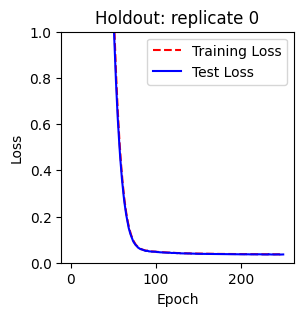

Training with replicate 1 heldout. # samples = 11978
HI
Epoch 1/250
75/75 [==============================] - 1s 6ms/step - loss: 33.4006 - mse: 2.2730 - mae: 1.1874 - val_loss: 31.2726 - val_mse: 0.5134 - val_mae: 0.5904
Epoch 2/250
75/75 [==============================] - 0s 4ms/step - loss: 32.5243 - mse: 2.1196 - mae: 1.1458 - val_loss: 30.7306 - val_mse: 0.6896 - val_mae: 0.6716
Epoch 3/250
75/75 [==============================] - 0s 4ms/step - loss: 31.6628 - mse: 1.9714 - mae: 1.1032 - val_loss: 30.1044 - val_mse: 0.7717 - val_mae: 0.7076
Epoch 4/250
75/75 [==============================] - 0s 5ms/step - loss: 30.8039 - mse: 1.8159 - mae: 1.0549 - val_loss: 29.4366 - val_mse: 0.8022 - val_mae: 0.7202
Epoch 5/250
75/75 [==============================] - 0s 5ms/step - loss: 29.9342 - mse: 1.6396 - mae: 0.9993 - val_loss: 28.7550 - val_mse: 0.8094 - val_mae: 0.7218
Epoch 6/250
75/75 [==============================] - 0s 5ms/step - loss: 29.0750 - mse: 1.4659 - mae: 0.9433 - val_loss

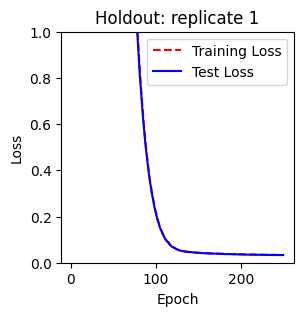

Training with replicate 2 heldout. # samples = 11978
HI
Epoch 1/250
75/75 [==============================] - 2s 9ms/step - loss: 33.3168 - mse: 2.2332 - mae: 1.1792 - val_loss: 31.2635 - val_mse: 0.5522 - val_mae: 0.6152
Epoch 2/250
75/75 [==============================] - 0s 6ms/step - loss: 32.4342 - mse: 2.0812 - mae: 1.1393 - val_loss: 30.7298 - val_mse: 0.7445 - val_mae: 0.7037
Epoch 3/250
75/75 [==============================] - 0s 6ms/step - loss: 31.5618 - mse: 1.9305 - mae: 1.0970 - val_loss: 30.1030 - val_mse: 0.8350 - val_mae: 0.7383
Epoch 4/250
75/75 [==============================] - 0s 4ms/step - loss: 30.6887 - mse: 1.7704 - mae: 1.0499 - val_loss: 29.4202 - val_mse: 0.8611 - val_mae: 0.7478
Epoch 5/250
75/75 [==============================] - 0s 4ms/step - loss: 29.8157 - mse: 1.6031 - mae: 0.9998 - val_loss: 28.7229 - val_mse: 0.8666 - val_mae: 0.7483
Epoch 6/250
75/75 [==============================] - 0s 4ms/step - loss: 28.9462 - mse: 1.4341 - mae: 0.9459 - val_loss

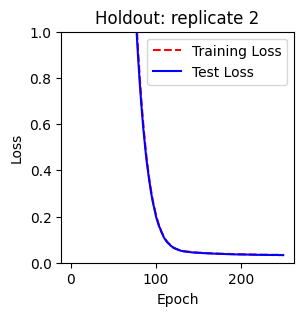

Inconsistencies found: 0 metabolites, 20 isotopolouges
Removing 3282 isotopolouges
File 0: /kidney-m0-no-log/3HB-ND-M1-FML-ioncounts-ranks.csv || 0 to drop || 0 dropped
File 1: /kidney-m0-no-log/3HB-ND-M2-FML-ioncounts-ranks.csv || 0 to drop || 0 dropped
File 2: /kidney-m0-no-log/3HB-ND-M3-FML-ioncounts-ranks.csv || 0 to drop || 0 dropped
Ion-Data is all consistent! Time to train a model!
File 0: /kidney-m0-no-log/3HB-ND-M1-FML-isotopolouges-ranks.csv || 3282 to drop || 3282 dropped
File 1: /kidney-m0-no-log/3HB-ND-M2-FML-isotopolouges-ranks.csv || 3262 to drop || 3262 dropped
File 2: /kidney-m0-no-log/3HB-ND-M3-FML-isotopolouges-ranks.csv || 3278 to drop || 3278 dropped
Iso-Data is all consistent! Time to train a model!
Testing with replicate 0 heldout. # samples = 11978
375/375 [==============================] - 0s 618us/step
Testing with replicate 1 heldout. # samples = 18583
581/581 [==============================] - 0s 615us/step
Testing with replicate 2 heldout. # samples = 10955

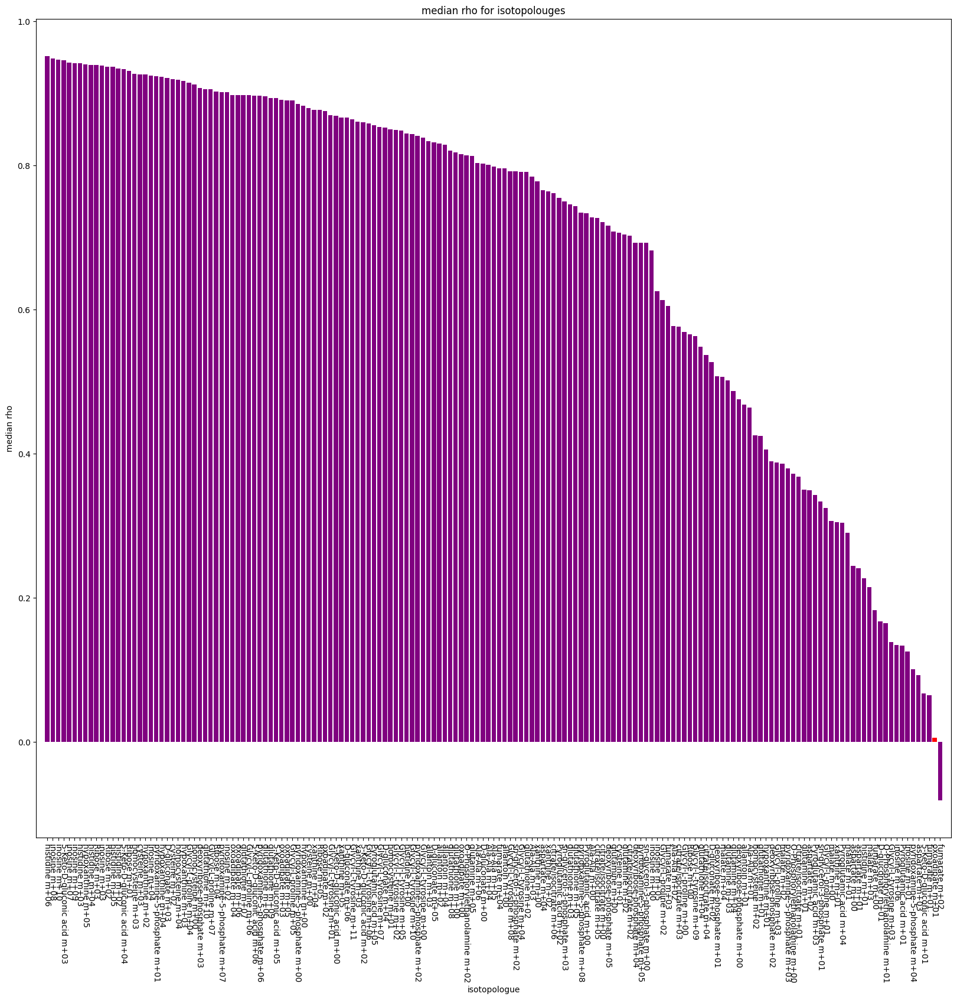

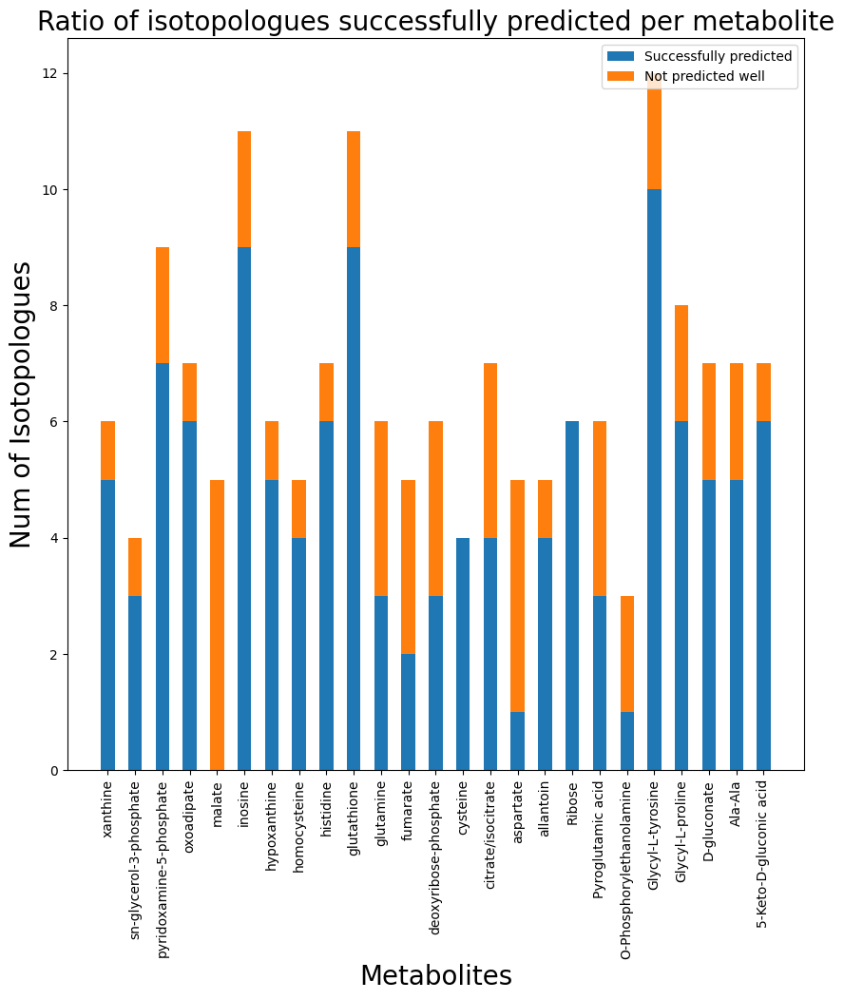

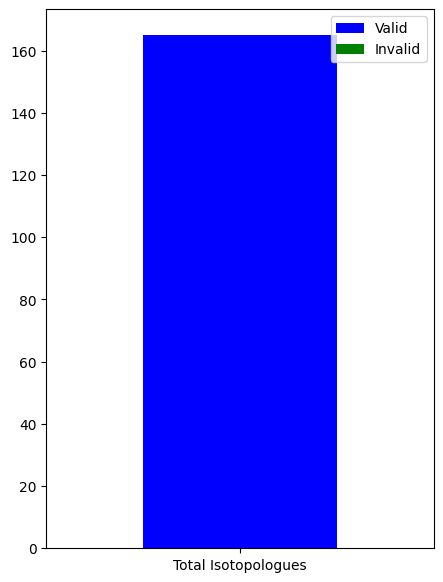

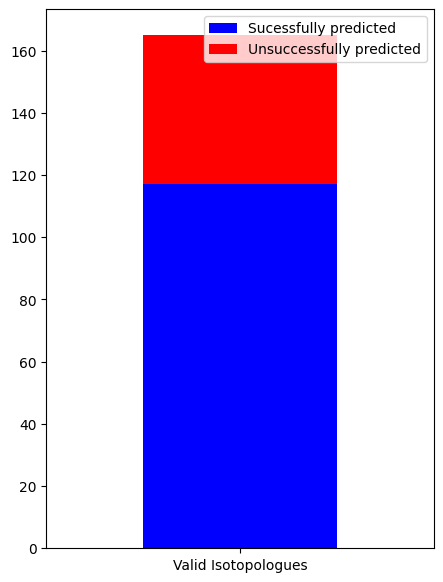

In [90]:
K3HB_ground, K3HB_predicted, K3HB_spearmans, K3HB_coords = full_pipeline(metab_names, moransi_scores, tracer = "3HB")

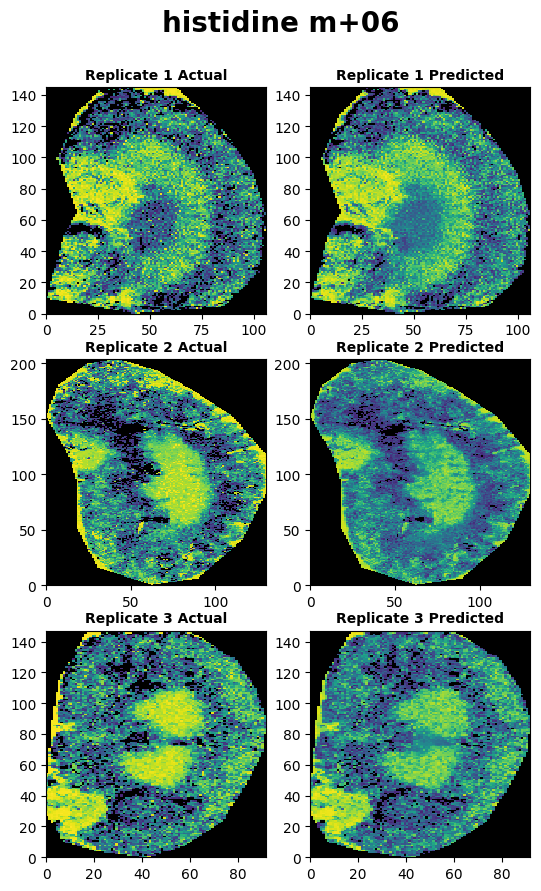

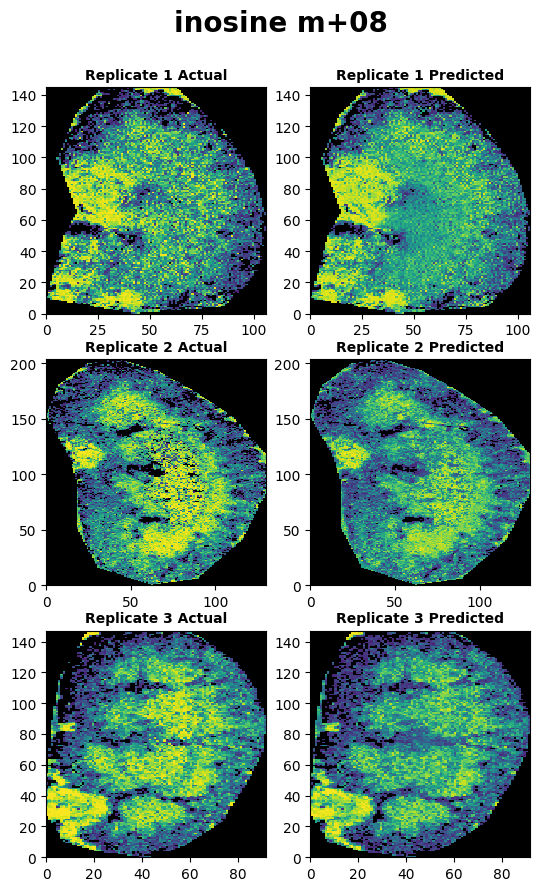

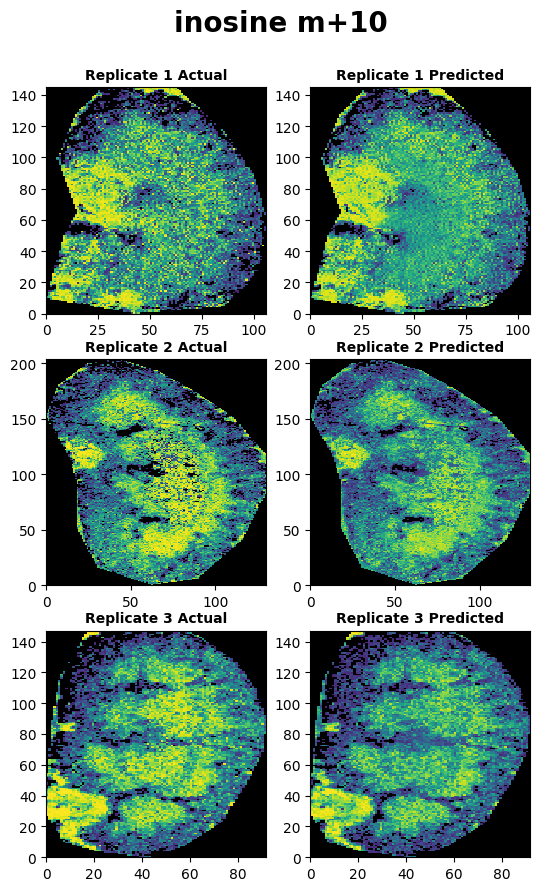

In [93]:
for iso_name in list(K3HB_spearmans[0:3]):
    vis.cross_validation_results(K3HB_ground, K3HB_predicted, coords_df = K3HB_coords, iso_to_plot = iso_name, limited = True)

# 3HB Cross Tissue

In [4]:
good_metabs = imputer.generate_valid_metabs()
print(good_metabs)

Working on replicate 0
Working on replicate 1
Working on replicate 2
Working on replicate 3
Working on replicate 4
Working on replicate 5
['2-Methylbutyrylglycine', '2-Phenylbutyric acid', '2-Phenylpropionic acid', '3-4-5-Trimethoxycinnamic acid', '3-Indolebutyric acid', '3-Indolepropionic acid', '3-Methylindole', '4-Guanidinobutanoic acid', '5-Methoxytryptamine', '5-Methylcytosine', '5-Phenylvaleric acid', '?-N-Acetylglucosamine', 'ADP', 'ADP-D-glucose', 'AMP', 'Acetylcholine', 'Anserine', 'Arachidic acid', 'Bilirubin', 'CDP-choline', 'CTP', 'Capryloyl glycine', 'Carnosine', 'Chenodeoxycholic acid', 'Cholic acid', 'Cyclic-ADP-ribose', 'Cysteine-glutathione disulphide', 'D-Pantethine', 'DL-2-Aminooctanoic acid', 'DL-5-Hydroxylysine', 'FMN', 'Folinic acid', 'GTP', 'Glycocholic acid', 'Glycodeoxycholic acid', 'Glycoursodeoxycholic acid', 'Hexanoyl Glycine', 'Homoarginine', 'IDP', 'IMP', 'Indole-3-ethanol', 'Indole-3-pyruvic acid', 'Inosine 5-triphosphate', 'L-Kynurenine', 'Linoleic acid'

In [5]:
clean_ion_data, clean_iso_data, new_metabolite_names, new_iso_names = imputer.preserve_good_metabs(good_metabs)

Inconsistencies found: 10 metabolites, 301 isotopolouges
File 0: /brain-m0-no-log/Brain-3HB/B3HB-ND-M1-FML-ioncounts-ranks.csv || 248 to drop || 248 dropped
File 1: /brain-m0-no-log/Brain-3HB/B3HB-ND-M2-FML-ioncounts-ranks.csv || 248 to drop || 248 dropped
File 2: /brain-m0-no-log/Brain-3HB/B3HB-ND-M3-FML-ioncounts-ranks.csv || 248 to drop || 248 dropped
File 3: /brain-m0-no-log/Brain-3HB/B3HB-KD-M1-FML-ioncounts-ranks.csv || 238 to drop || 238 dropped
File 4: /brain-m0-no-log/Brain-3HB/B3HB-KD-M2-FML-ioncounts-ranks.csv || 238 to drop || 238 dropped
File 5: /brain-m0-no-log/Brain-3HB/B3HB-KD-M3-FML-ioncounts-ranks.csv || 238 to drop || 238 dropped
Ion-Data is all consistent! Time to train a model!
File 0: /brain-m0-no-log/Brain-3HB/B3HB-ND-M1-FML-isotopolouges-ranks.csv || 2142 to drop || 2142 dropped
File 1: /brain-m0-no-log/Brain-3HB/B3HB-ND-M2-FML-isotopolouges-ranks.csv || 2154 to drop || 2154 dropped
File 2: /brain-m0-no-log/Brain-3HB/B3HB-ND-M3-FML-isotopolouges-ranks.csv || 212

In [209]:
print(new_metabolite_names)
print(new_iso_names)

Index(['Glycocholic acid', 'indole', 'taurine', '5-Methylcytosine',
       'N-Acetylputrescine', '3-Methylindole', 'leucine', 'aspartate',
       'N'-Methylnicotinamide', 'Phenylethanolamine',
       ...
       'ADP-D-glucose', 'glutathione disulfide', 'NAD+', 'NADH',
       'dephospho-CoA', 'N-Acetyl-L-arginine', 'N-Acetyl-L-leucine',
       'N-Acetyl-L-isoleucine', 'O-acetyl-L-serine', 'N-Iso valerylglycine'],
      dtype='object', length=105)
Index(['Glycocholic acid m+00', 'Glycocholic acid m+01',
       'Glycocholic acid m+02', 'Glycocholic acid m+03',
       'Glycocholic acid m+04', 'Glycocholic acid m+05',
       'Glycocholic acid m+06', 'Glycocholic acid m+07',
       'Glycocholic acid m+08', 'Glycocholic acid m+09',
       ...
       'O-acetyl-L-serine m+04', 'O-acetyl-L-serine m+05',
       'N-Iso valerylglycine m+00', 'N-Iso valerylglycine m+01',
       'N-Iso valerylglycine m+02', 'N-Iso valerylglycine m+03',
       'N-Iso valerylglycine m+04', 'N-Iso valerylglycine m+05',


In [210]:
history = imputer.train_full_tracer(clean_ion_data, clean_iso_data)

HI
Epoch 1/200
773/773 [==============================] - 6s 6ms/step - loss: 47.7896 - mse: 1.8920 - mae: 1.0731 - val_loss: 39.6550 - val_mse: 1.1227 - val_mae: 0.8130
Epoch 2/200
773/773 [==============================] - 4s 5ms/step - loss: 33.4512 - mse: 0.9269 - mae: 0.7368 - val_loss: 27.5255 - val_mse: 0.5073 - val_mae: 0.5682
Epoch 3/200
773/773 [==============================] - 4s 5ms/step - loss: 22.9111 - mse: 0.4616 - mae: 0.5428 - val_loss: 18.6132 - val_mse: 0.3225 - val_mae: 0.4692
Epoch 4/200
773/773 [==============================] - 4s 5ms/step - loss: 15.2581 - mse: 0.3276 - mae: 0.4673 - val_loss: 12.1706 - val_mse: 0.2599 - val_mae: 0.4242
Epoch 5/200
773/773 [==============================] - 4s 5ms/step - loss: 9.7914 - mse: 0.2620 - mae: 0.4215 - val_loss: 7.6369 - val_mse: 0.2210 - val_mae: 0.3905
Epoch 6/200
773/773 [==============================] - 4s 5ms/step - loss: 6.0120 - mse: 0.2179 - mae: 0.3849 - val_loss: 4.5677 - val_mse: 0.1913 - val_mae: 0.3618

In [31]:
kidney_clean_ion_data, kidney_clean_iso_data, kidney_new_metabolite_names, kidney_new_iso_name, kidney_coords = imputer.preserve_good_metabs(good_metabs, good_iso_names = list(new_iso_names),data_path = '/kidney-m0-no-log', FML = True, tracer = '3HB')

Inconsistencies found: 0 metabolites, 20 isotopolouges
File 0: /kidney-m0-no-log/3HB-ND-M1-FML-ioncounts-ranks.csv || 248 to drop || 248 dropped
File 1: /kidney-m0-no-log/3HB-ND-M2-FML-ioncounts-ranks.csv || 248 to drop || 248 dropped
File 2: /kidney-m0-no-log/3HB-ND-M3-FML-ioncounts-ranks.csv || 248 to drop || 248 dropped
Ion-Data is all consistent! Time to train a model!
File 0: /kidney-m0-no-log/3HB-ND-M1-FML-isotopolouges-ranks.csv || 2158 to drop || 2158 dropped
File 1: /kidney-m0-no-log/3HB-ND-M2-FML-isotopolouges-ranks.csv || 2138 to drop || 2138 dropped
File 2: /kidney-m0-no-log/3HB-ND-M3-FML-isotopolouges-ranks.csv || 2154 to drop || 2154 dropped
Iso-Data is all consistent! Time to train a model!
Reading in coord data


In [32]:
print(len(clean_ion_data[0].columns), len(kidney_clean_ion_data[0].columns))
print(len(clean_iso_data[0].columns))
print(len(kidney_clean_iso_data[0].columns))
print([x for x in clean_iso_data[0].columns if x not in kidney_clean_iso_data[0].columns])

# print(clean_iso_data[0].columns == kidney_clean_iso_data[0].columns)

105 105
1290
1289
['Taurodeoxycholic acid m+00']


In [33]:
checkpoint_path = "./saved-weights/3HB-cross-tissue/checkpoint"
predicted = imputer.predict(kidney_clean_ion_data[0], clean_iso_data[0], checkpoint_path = checkpoint_path)
predicted = predicted.drop(labels = [x for x in clean_iso_data[0].columns if x not in kidney_clean_iso_data[0].columns], axis = 1)
print(len(predicted.columns))

375/375 [==============================] - 1s 1ms/step
1289


In [34]:
kidney_clean_iso_data[0][['x', 'y']] = kidney_coords[0][['x', 'y']]
predicted[['x', 'y']] = kidney_coords[0][['x', 'y']]

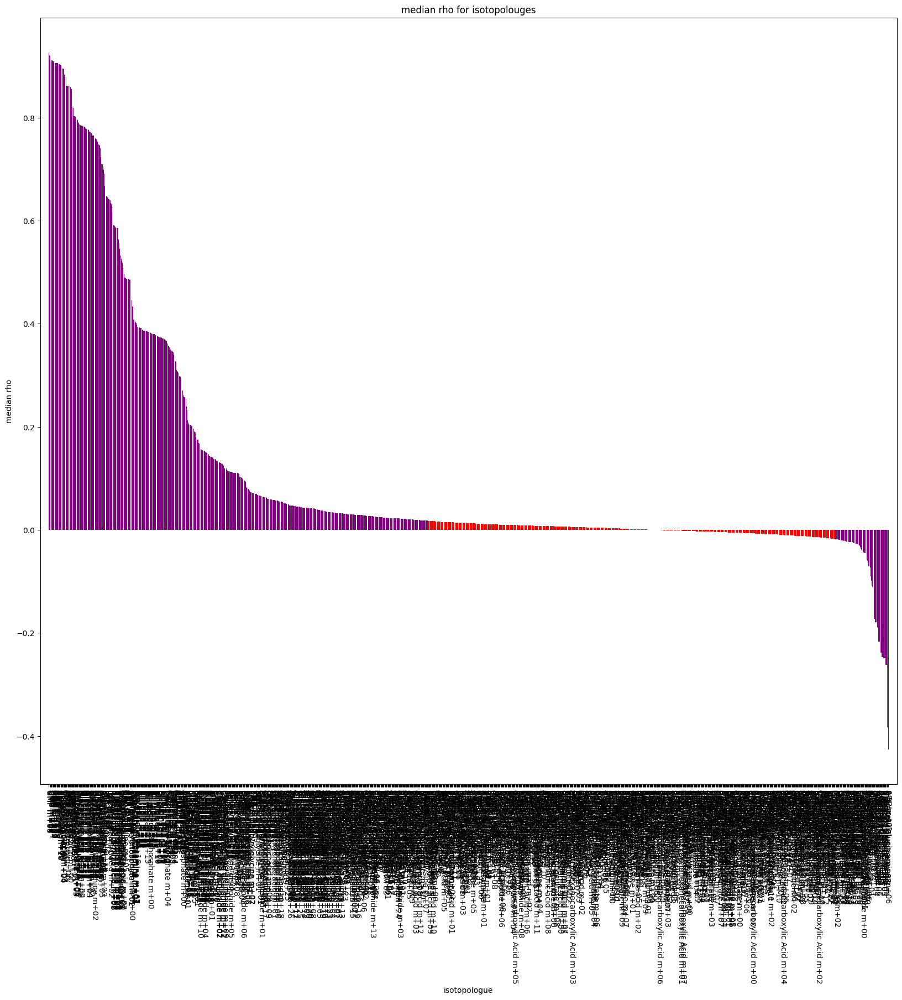

In [47]:
top_results = imputer.spearman_rankings(kidney_clean_iso_data[0], predicted)

In [49]:
print(top_results[0:30])

     median_rho              isotopologue  pvals   color
653    0.926319                  UMP m+06    0.0  purple
651    0.920972                  UMP m+04    0.0  purple
650    0.920093                  UMP m+03    0.0  purple
649    0.910911                  UMP m+02    0.0  purple
661    0.910609                  AMP m+04    0.0  purple
672    0.910609                 dGMP m+04    0.0  purple
654    0.909971                  UMP m+07    0.0  purple
663    0.909390                  AMP m+06    0.0  purple
674    0.909390                 dGMP m+06    0.0  purple
671    0.906243                 dGMP m+03    0.0  purple
660    0.906243                  AMP m+03    0.0  purple
676    0.905712                 dGMP m+08    0.0  purple
665    0.905712                  AMP m+08    0.0  purple
662    0.905252                  AMP m+05    0.0  purple
673    0.905252                 dGMP m+05    0.0  purple
678    0.904046                 dGMP m+10    0.0  purple
667    0.904046                

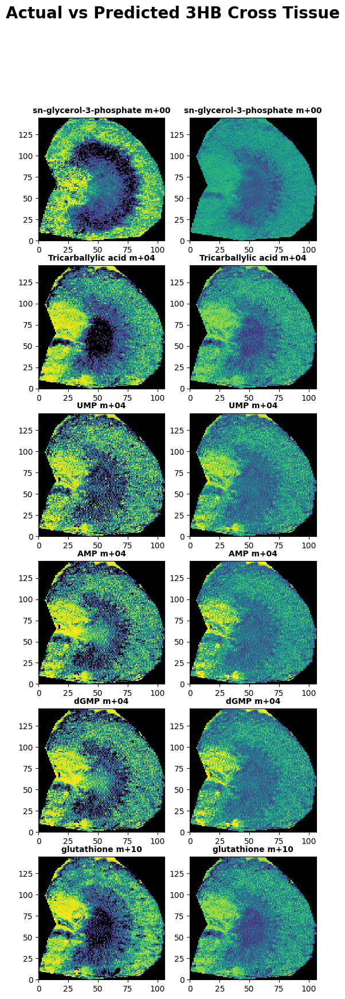

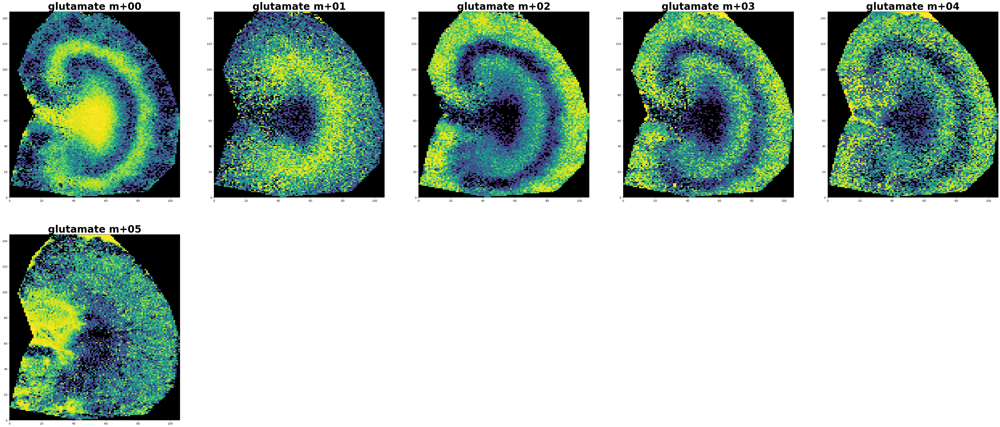

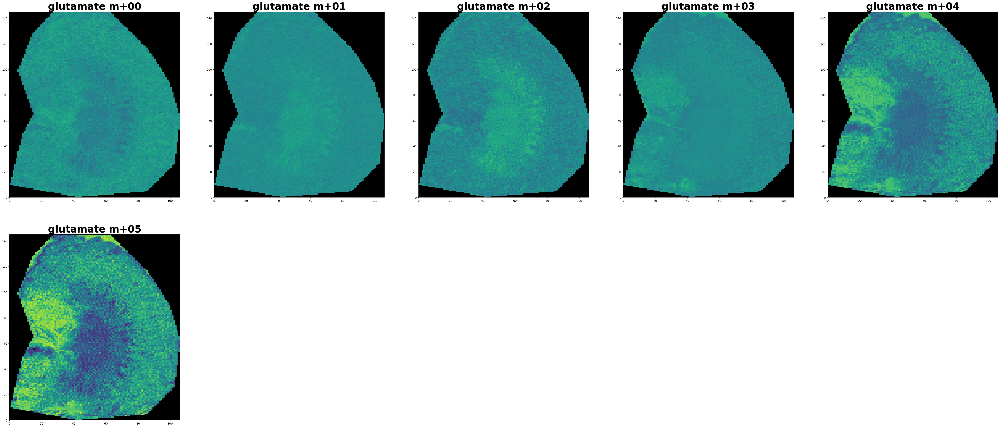

In [56]:
vis.plot_ground_vs_pred(kidney_clean_iso_data[0], predicted, kidney_coords[0], title = 'Actual vs Predicted 3HB Cross Tissue', iso_names_to_plot = ['sn-glycerol-3-phosphate m+00','Tricarballylic acid m+04', 'UMP m+04', 'AMP m+04', 'dGMP m+04', 'glutathione m+10'])
vis.plot_multiple_brains(kidney_clean_iso_data[0], indices_to_plot = [i for i in range(123,129)])
vis.plot_multiple_brains(predicted, indices_to_plot = [i for i in range(123,129)])

In [52]:
kidney_clean_ion_data[0][['x', 'y']] = kidney_coords[0][['x', 'y']]

In [57]:
vis.plot_multiple_brains(kidney_clean_ion_data[0], indices_to_plot = [i for i in range(130)])

TypeError: cannot convert the series to <class 'int'>

## 3HB Cross Tissue 2

In [60]:
i = 1
print(len(clean_ion_data[i].columns), len(kidney_clean_ion_data[i].columns))
print(len(clean_iso_data[i].columns))
print(len(kidney_clean_iso_data[i].columns))
print([x for x in clean_iso_data[i].columns if x not in kidney_clean_iso_data[i].columns])

predicted1 = imputer.predict(kidney_clean_ion_data[i], clean_iso_data[i], checkpoint_path = checkpoint_path)
predicted1 = predicted1.drop(labels = [x for x in clean_iso_data[i].columns if x not in kidney_clean_iso_data[i].columns], axis = 1)
print(len(predicted1.columns))

kidney_clean_iso_data[i][['x', 'y']] = kidney_coords[i][['x', 'y']]
predicted1[['x', 'y']] = kidney_coords[i][['x', 'y']]

105 105
1290
1289
['Taurodeoxycholic acid m+00']
581/581 [==============================] - 1s 856us/step
1289


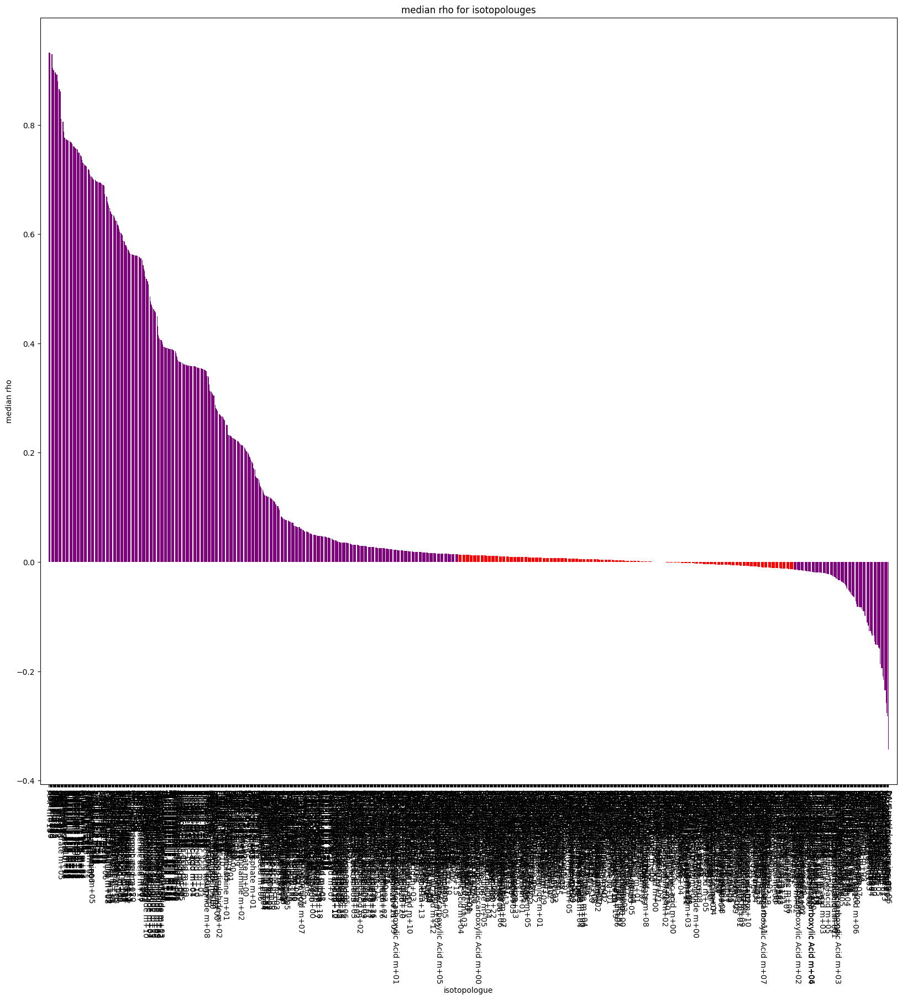

In [61]:
top_results2 = imputer.spearman_rankings(kidney_clean_iso_data[i], predicted1)

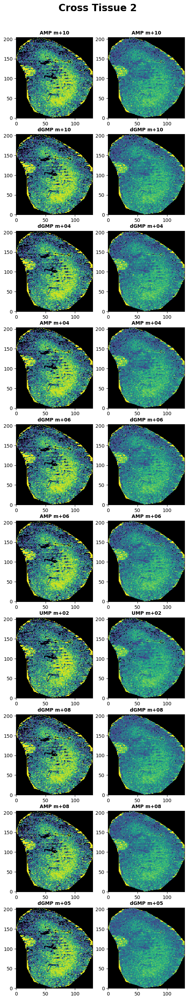

In [91]:
vis.plot_ground_vs_pred(kidney_clean_iso_data[i], predicted1, kidney_coords[i], title = 'Cross Tissue 2', iso_names_to_plot = list(top_results2[0:10].isotopologue))

In [ ]:
# Plot of TIC normalized without rank transform for all metabolites - all on same scale 
# Which metabolites are predictive of other metabollites 
#   - Make a graph where every node is a metabolite, and edge between two nodes means they are uniquely predictive of each other 
#       - If given every other metabolite, dgmp still gives information to predict them (example)
# Getting at which features are predictive. 
#   - 1). Holdout randomization test - train a model to predict every metabolite on every other metabolite (predicting the distribution)
#        - replace real values with values sampled from the distribution
#   - 2). Covariance distribution - 

In [96]:
metab_data_unranked = imputer.get_data(data_path = '/full-metabolite-list/separated/FML-kidney-3HB-M1.csv')

(['/full-metabolite-list/separated/FML-kidney-3HB-M1.csv/lactate-ND-M1-FML-ioncounts-ranks.csv',
  '/full-metabolite-list/separated/FML-kidney-3HB-M1.csv/lactate-ND-M2-FML-ioncounts-ranks.csv',
  '/full-metabolite-list/separated/FML-kidney-3HB-M1.csv/lactate-ND-M3-FML-ioncounts-ranks.csv'],
 ['/full-metabolite-list/separated/FML-kidney-3HB-M1.csv/lactate-ND-M1-FML-isotopolouges-ranks.csv',
  '/full-metabolite-list/separated/FML-kidney-3HB-M1.csv/lactate-ND-M2-FML-isotopolouges-ranks.csv',
  '/full-metabolite-list/separated/FML-kidney-3HB-M1.csv/lactate-ND-M3-FML-isotopolouges-ranks.csv'])

# Black Box

In [101]:
training_features, training_targets = imputer.train_for_feature_importance()

Working on replicate 0
Working on replicate 1
Working on replicate 2
Working on replicate 3
Working on replicate 4
Working on replicate 5
Inconsistencies found: 10 metabolites, 301 isotopolouges
File 0: /brain-m0-no-log/Brain-3HB/B3HB-ND-M1-FML-ioncounts-ranks.csv || 248 to drop || 248 dropped
File 1: /brain-m0-no-log/Brain-3HB/B3HB-ND-M2-FML-ioncounts-ranks.csv || 248 to drop || 248 dropped
File 2: /brain-m0-no-log/Brain-3HB/B3HB-ND-M3-FML-ioncounts-ranks.csv || 248 to drop || 248 dropped
File 3: /brain-m0-no-log/Brain-3HB/B3HB-KD-M1-FML-ioncounts-ranks.csv || 238 to drop || 238 dropped
File 4: /brain-m0-no-log/Brain-3HB/B3HB-KD-M2-FML-ioncounts-ranks.csv || 238 to drop || 238 dropped
File 5: /brain-m0-no-log/Brain-3HB/B3HB-KD-M3-FML-ioncounts-ranks.csv || 238 to drop || 238 dropped
Ion-Data is all consistent! Time to train a model!
File 0: /brain-m0-no-log/Brain-3HB/B3HB-ND-M1-FML-isotopolouges-ranks.csv || 2142 to drop || 2142 dropped
File 1: /brain-m0-no-log/Brain-3HB/B3HB-ND-M2-FM

In [110]:
for metabolite_number, metabolite in enumerate(list(training_features.columns)):
    # print(metabolite_number, metabolite)
    heldout_metab = training_features.loc[:, metabolite]
    remaining_metabs = training_features.loc[:, training_features.columns != metabolite]
    print(heldout_metab.shape, remaining_metabs.shape)
    print(imputer.predict_heldout_metab(remaining_metabs, heldout_metab))

(123595,) (123595, 104)
Epoch 1/30
387/387 - 1s - loss: 8.4760 - mse: 0.9277 - mae: 0.7309 - val_loss: 7.8348 - val_mse: 0.4073 - val_mae: 0.5161 - 1s/epoch - 4ms/step
Epoch 2/30
387/387 - 1s - loss: 7.6761 - mse: 0.3894 - mae: 0.4857 - val_loss: 7.4270 - val_mse: 0.2900 - val_mae: 0.4188 - 689ms/epoch - 2ms/step
Epoch 3/30
387/387 - 1s - loss: 7.2084 - mse: 0.2319 - mae: 0.3727 - val_loss: 6.9926 - val_mse: 0.1833 - val_mae: 0.3260 - 584ms/epoch - 2ms/step
Epoch 4/30
387/387 - 1s - loss: 6.7898 - mse: 0.1551 - mae: 0.3027 - val_loss: 6.5807 - val_mse: 0.1260 - val_mae: 0.2691 - 645ms/epoch - 2ms/step
Epoch 5/30
387/387 - 1s - loss: 6.3821 - mse: 0.1126 - mae: 0.2576 - val_loss: 6.1742 - val_mse: 0.0947 - val_mae: 0.2327 - 658ms/epoch - 2ms/step
Epoch 6/30
387/387 - 1s - loss: 5.9735 - mse: 0.0875 - mae: 0.2266 - val_loss: 5.7629 - val_mse: 0.0743 - val_mae: 0.2062 - 648ms/epoch - 2ms/step
Epoch 7/30
387/387 - 1s - loss: 5.5597 - mse: 0.0704 - mae: 0.2032 - val_loss: 5.3467 - val_mse: 

KeyboardInterrupt: 